# XAFS Analysis Pipeline:

📂 Loads and groups the cleaned CSV files by sample name,

➗ Averages replicates,

✨ Normalizes XANES (with E₀ detection),

🔬 Extracts EXAFS (chi(k) and FT) data,

🖼️ Plots everything for clear visualization.

In [213]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.ticker import FuncFormatter

import os
from glob import glob
import re



# Import Larch modules for XAFS analysis
from larch.xafs import pre_edge, autobk, feffpath, xftf
from larch import Group

# === 1️⃣ FOLDER PATH ===
folder_path = 'D:/Research/FieldNotes/Synchrotron/2207_SSRL_BL4-3_XAS_Sulfur'
# Folder path for sulfur references
sulfur_ref_path = 'D:/Research/FieldNotes/Synchrotron/Rob_Standards/Sulfur'

# Define the save path
save_folder = r"C:/Users/xeniadegracia/OneDrive - University of Arizona/Research/FieldNotes/Synchrotron/2207_SSRL_BL4-3_XAS_Sulfur/LARCH"


In [214]:
# === 2️⃣ FIND ALL CLEANED FILES ===
csv_files = glob(os.path.join(folder_path, '*_clean.csv'))

print(f"✅ Found {len(csv_files)} cleaned samples CSV files.")

✅ Found 181 cleaned samples CSV files.


In [215]:
# === 2️⃣ FIND ALL CLEANED FILES OF REFERENCES OF SULFUR===
sulfur_references_files = glob(os.path.join(sulfur_ref_path, '*_clean.csv'))

print(f"✅ Found {len(sulfur_references_files)} cleaned samples CSV files.")

✅ Found 12 cleaned samples CSV files.


In [216]:
# === 3️⃣ GROUP FILES BY SAMPLE NAME (ignoring replicate number) ===
sample_groups = {}
for file in csv_files:
    base = os.path.basename(file)
    # Assumes filename pattern: SampleName_Replicate_clean.csv
    sample_name = '_'.join(base.split('_')[:-2])  # Get everything before _Rep#_clean
    sample_groups.setdefault(sample_name, []).append(file)

bad_samples = ["TB2", "MG_4", "MM_bad"]
sample_groups = {k: v for k, v in sample_groups.items() if not any(bad in k for bad in bad_samples)}



print(f"✅ Grouped into {len(sample_groups)} sample(s): {list(sample_groups.keys())}")




✅ Grouped into 130 sample(s): ['S_BC_B_69_017', 'S_BC_D_116_103', 'S_BC_E_117_104', 'S_BC_G_118_105', 'S_BC_H_119_106', 'S_BC_J_120_107', 'S_BC_K_121_108', 'S_BC_L_122_109', 'S_BC_M_123_110', 'S_BC_O_124_111', 'S_BC_test_core_078', 'S_BK_A_63_009', 'S_BK_B_73_038', 'S_BK_C_47_004', 'S_BK_D_162_177', 'S_BK_E_163_178', 'S_BK_F_164_179', 'S_BK_G_48_005', 'S_BK_H_165_180', 'S_BK_I_166_181', 'S_BK_J_49_007', 'S_BK_K_167_182', 'S_BK_L_168_183', 'S_BK_M_169_184', 'S_BK_N_50_008', 'S_CC_B_71_019', 'S_CC_D_134_121', 'S_CC_E_135_122', 'S_CC_G_136_123', 'S_CC_H_137_124', 'S_CC_J_138_125', 'S_CC_L_139_126', 'S_CT_B_68_016', 'S_CT_core_A_077', 'S_CT_core_B_082', 'S_CT_core_B_C_079', 'S_CT_core_B_C_082', 'S_CT_D_110_094', 'S_CT_D_110_097', 'S_CT_E_111_098', 'S_CT_G_112_099', 'S_CT_H_113_100', 'S_CT_J_114_101', 'S_CT_K_115_102', 'S_GP_AA_160_089', 'S_GP_AC_161_090', 'S_GP_B_72_020', 'S_GP_B_72_023', 'S_GP_core3_2_075', 'S_GP_D_140_127', 'S_GP_E_141_128', 'S_GP_F_142_129', 'S_GP_G_143_130', 'S_GP_H_14

In [217]:
# === 3️⃣ GROUP FILES BY REFERENCES NAME (ignoring replicate number) ===
reference_groups = {}
for file in sulfur_references_files:
    base = os.path.basename(file)
    # Assumes filename pattern: SampleName_Replicate_clean.csv
    reference_name = '_'.join(base.split('_')[:-2])  # Get everything before _Rep#_clean
    reference_groups.setdefault(reference_name, []).append(file)

bad_samples = ["TB2", "MG_4", "MM_bad"]
reference_groups = {k: v for k, v in reference_groups.items() if not any(bad in k for bad in bad_samples)}



print(f"✅ Grouped into {len(reference_groups)} reference(s): {list(reference_groups.keys())}")




✅ Grouped into 5 reference(s): ['S_BY_Jarosite_067', 'S_Pyrite_FeS2_141', 'S_Schw_1_048', 'S_Schw_2_049', 'S_Schw_3_050']


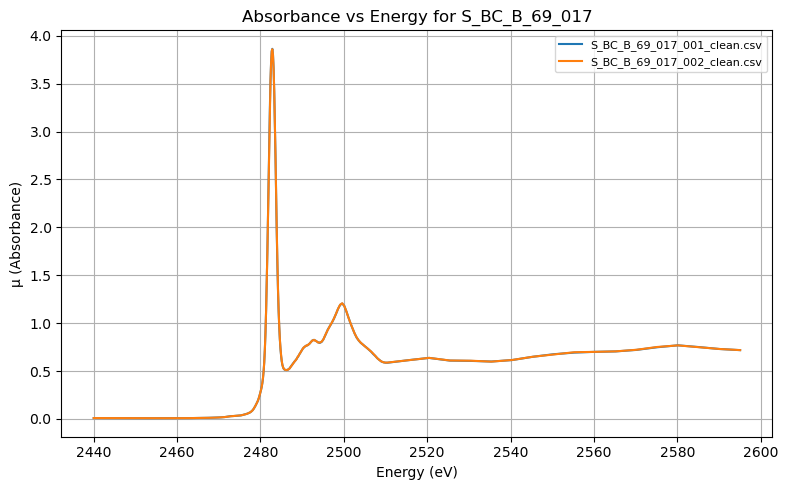

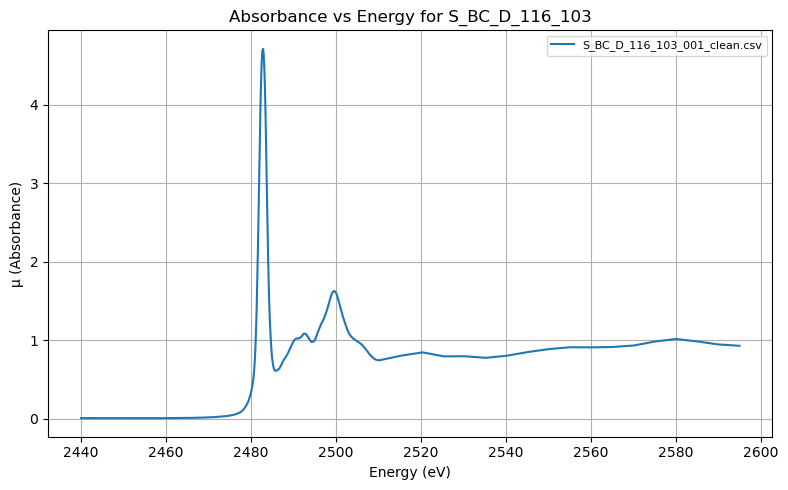

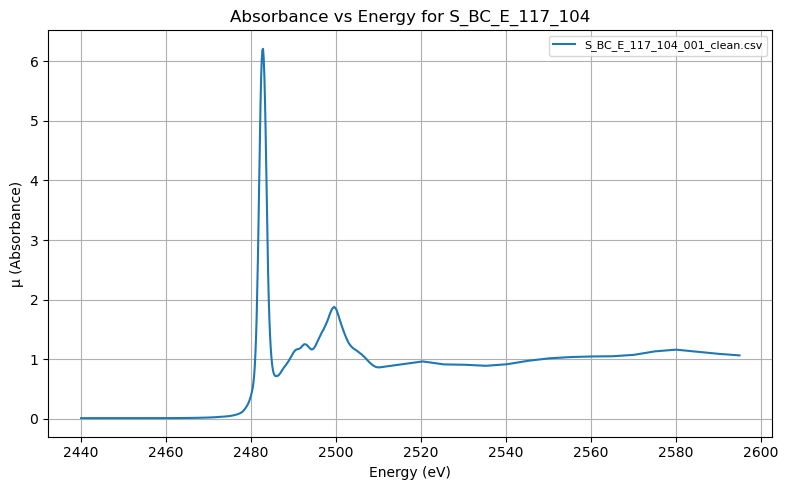

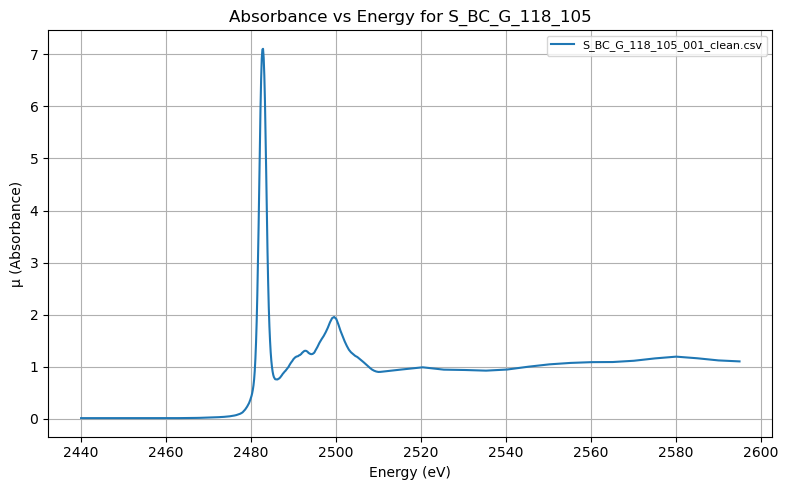

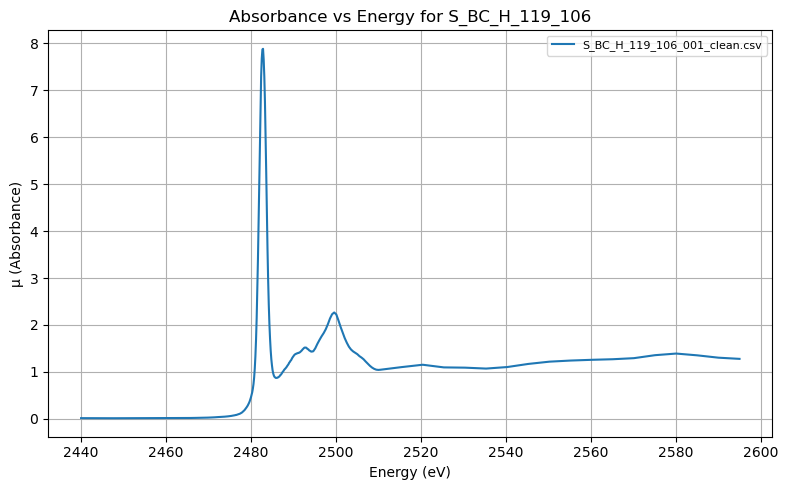

...

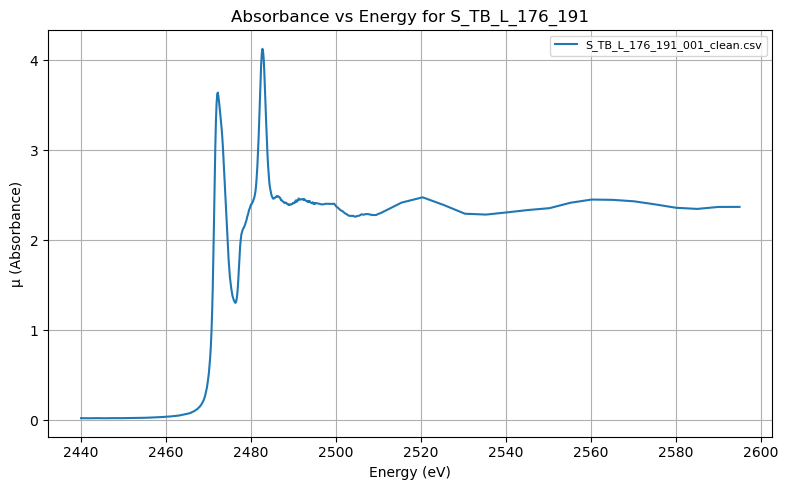

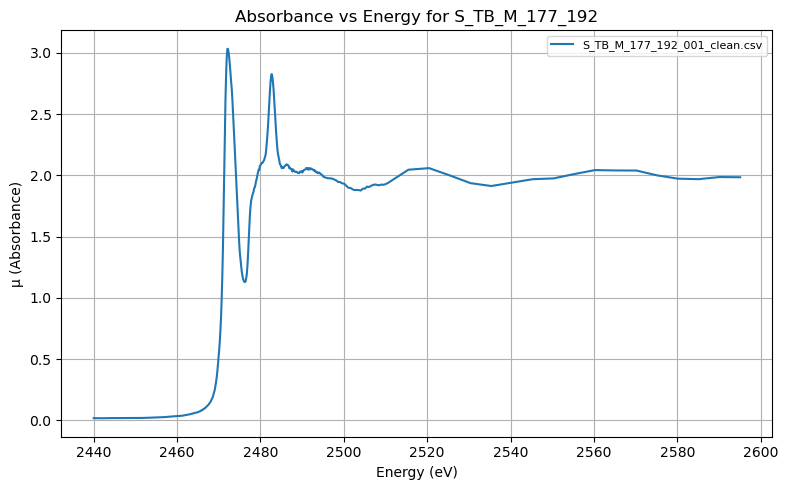

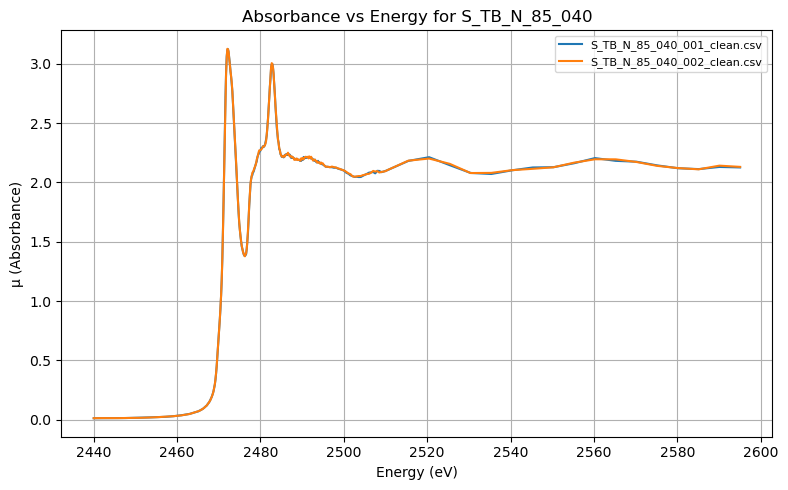

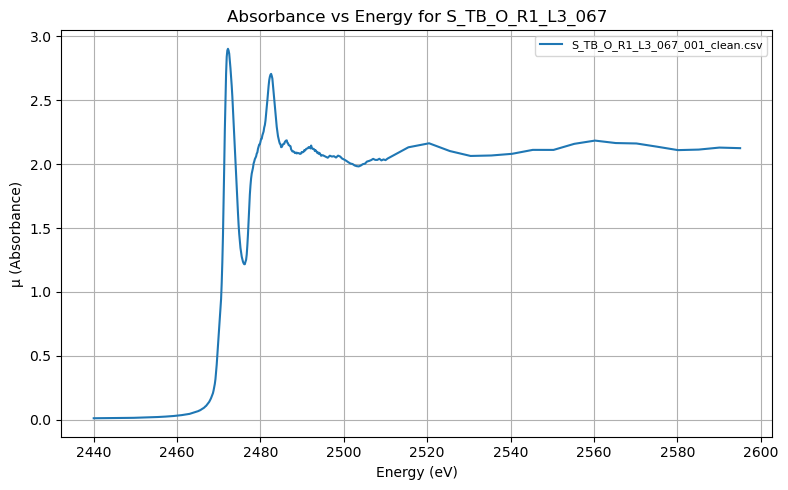

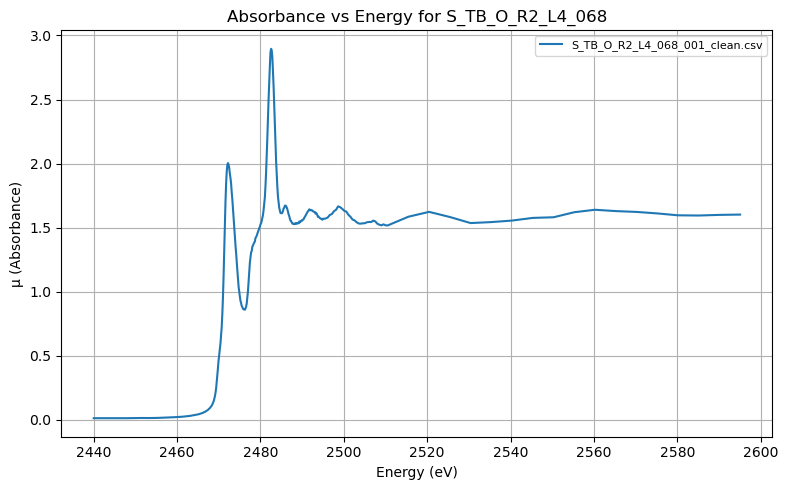

In [218]:
# 🔍 OPTIONAL STEP: Inspect individual replicate spectra before averaging
for sample, files in sample_groups.items():
    plt.figure(figsize=(8, 5))
    for f in files:
        df = pd.read_csv(f)
        plt.plot(df['energy'], df['mu'], label=os.path.basename(f))
    plt.title(f"Absorbance vs Energy for {sample}")
    plt.xlabel("Energy (eV)")
    plt.ylabel("μ (Absorbance)")
    plt.legend(fontsize=8)
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    plt.close()  # 👈 prevents the plot from being retained by the notebook


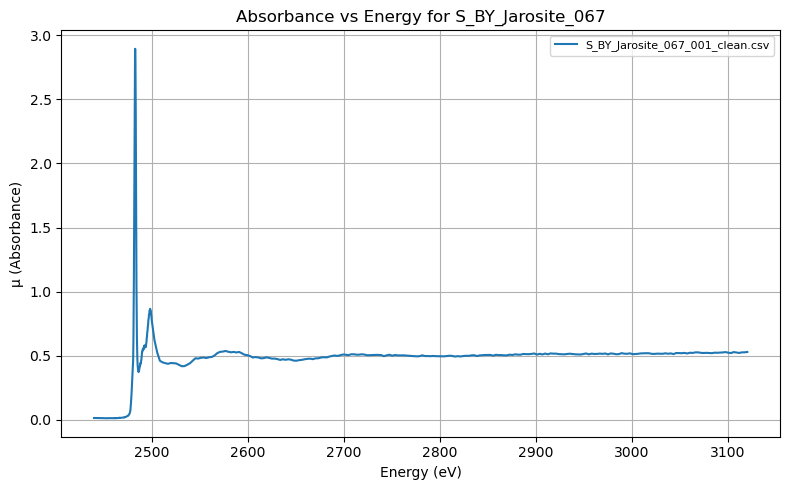

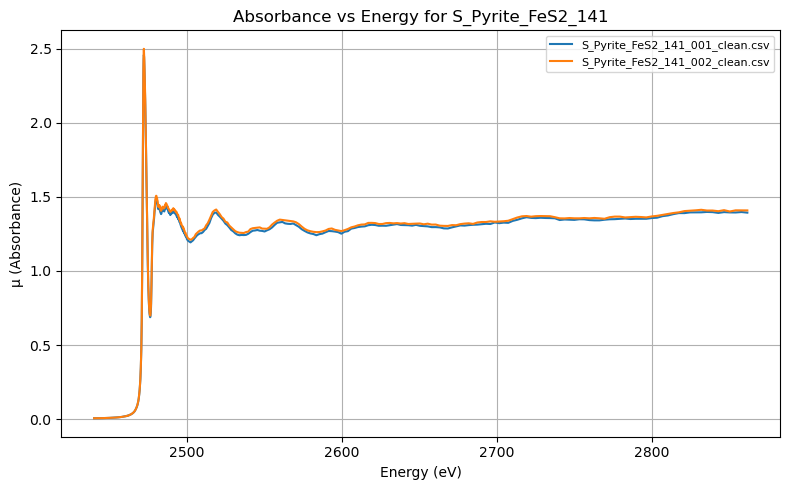

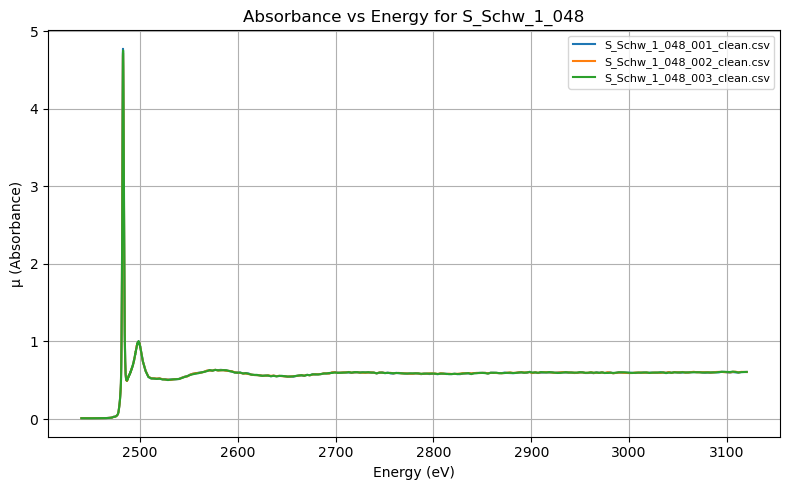

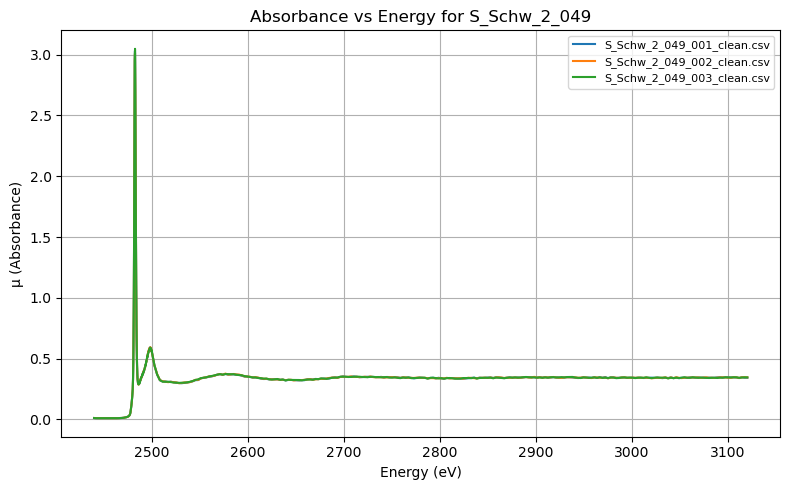

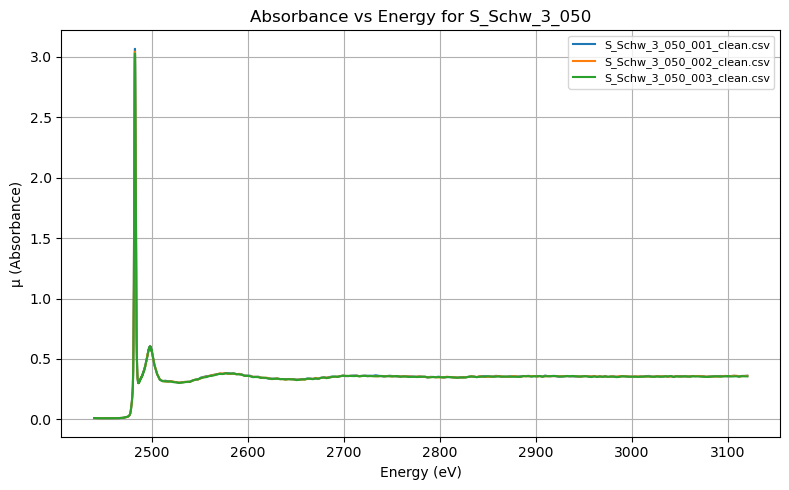

In [219]:
# 🔍 Inspect individual REFERENCES before averaging
for reference, files in reference_groups.items():
    plt.figure(figsize=(8, 5))
    for f in files:
        df = pd.read_csv(f)
        plt.plot(df['energy'], df['mu'], label=os.path.basename(f))
    plt.title(f"Absorbance vs Energy for {reference}")
    plt.xlabel("Energy (eV)")
    plt.ylabel("μ (Absorbance)")
    plt.legend(fontsize=8)
    plt.grid(True)
    plt.tight_layout()
    plt.show()


In [220]:
# === 4️⃣ AVERAGE REPLICATE SPECTRA ===
averaged_data = {}
for sample, files in sample_groups.items():
    dfs = []
    for f in files:
        df = pd.read_csv(f)
        dfs.append(df)
    # Merge on 'energy'
    merged = dfs[0][['energy']].copy()
    mu_cols = []
    for i, df in enumerate(dfs):
        colname = f'mu_{i+1}'
        merged[colname] = df['mu']
        mu_cols.append(colname)
    # Average mu
    merged['mu_avg'] = merged[mu_cols].mean(axis=1)
    averaged_data[sample] = merged
    print(f"✅ Averaged {len(files)} replicates for {sample}")
    
averaged_references = {}
for reference, files in reference_groups.items():
    dfs = []
    for f in files:
        df = pd.read_csv(f)
        dfs.append(df)
    # Merge on 'energy'
    merged = dfs[0][['energy']].copy()
    mu_cols = []
    for i, df in enumerate(dfs):
        colname = f'mu_{i+1}'
        merged[colname] = df['mu']
        mu_cols.append(colname)
    # Average mu
    merged['mu_avg'] = merged[mu_cols].mean(axis=1)
    averaged_references[reference] = merged
    print(f"✅ Averaged {len(files)} replicates for {reference}")

✅ Averaged 2 replicates for S_BC_B_69_017
✅ Averaged 1 replicates for S_BC_D_116_103
✅ Averaged 1 replicates for S_BC_E_117_104
✅ Averaged 1 replicates for S_BC_G_118_105
✅ Averaged 1 replicates for S_BC_H_119_106
✅ Averaged 1 replicates for S_BC_J_120_107
✅ Averaged 1 replicates for S_BC_K_121_108
✅ Averaged 1 replicates for S_BC_L_122_109
✅ Averaged 1 replicates for S_BC_M_123_110
✅ Averaged 1 replicates for S_BC_O_124_111
✅ Averaged 2 replicates for S_BC_test_core_078
✅ Averaged 2 replicates for S_BK_A_63_009
✅ Averaged 2 replicates for S_BK_B_73_038
✅ Averaged 2 replicates for S_BK_C_47_004
✅ Averaged 1 replicates for S_BK_D_162_177
✅ Averaged 1 replicates for S_BK_E_163_178
✅ Averaged 1 replicates for S_BK_F_164_179
✅ Averaged 2 replicates for S_BK_G_48_005
✅ Averaged 1 replicates for S_BK_H_165_180
✅ Averaged 1 replicates for S_BK_I_166_181
✅ Averaged 2 replicates for S_BK_J_49_007
✅ Averaged 1 replicates for S_BK_K_167_182
✅ Averaged 1 replicates for S_BK_L_168_183
✅ Averaged 1 

In [221]:
#averaged_data

# **XANES NORMALIZATION & E0 FINDING**

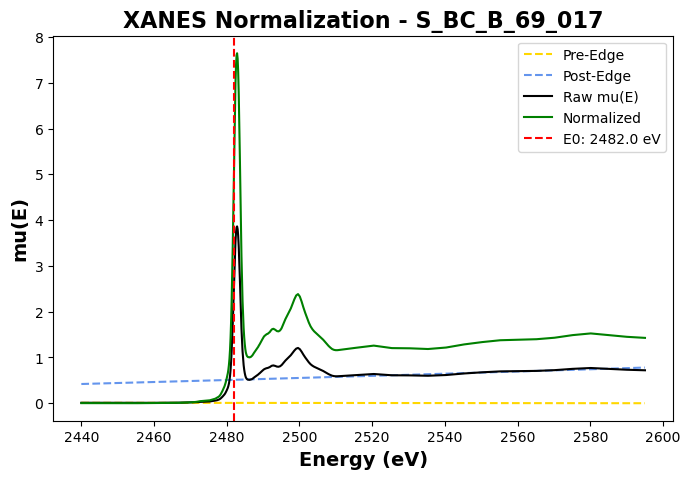

✅ Normalized S_BC_B_69_017 (E0 = 2482.0 eV)


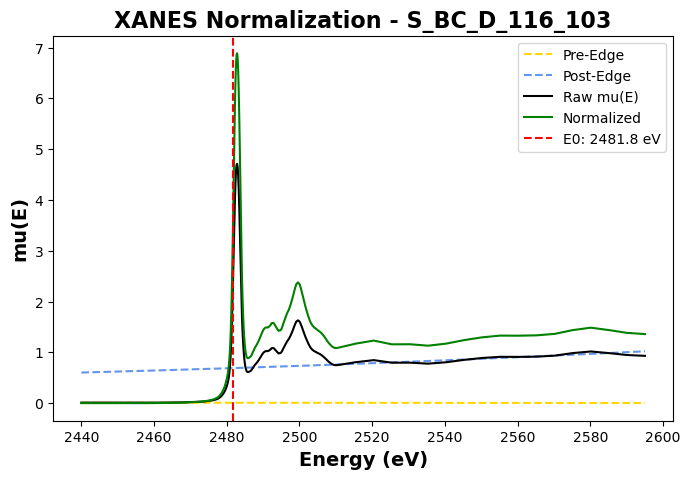

✅ Normalized S_BC_D_116_103 (E0 = 2481.8 eV)


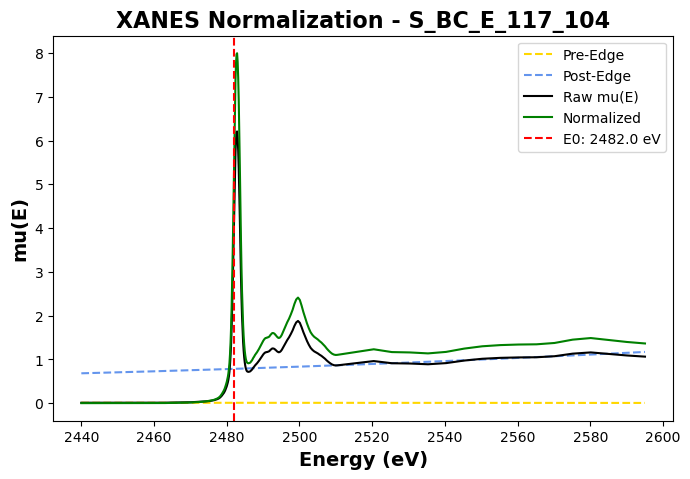

✅ Normalized S_BC_E_117_104 (E0 = 2482.0 eV)


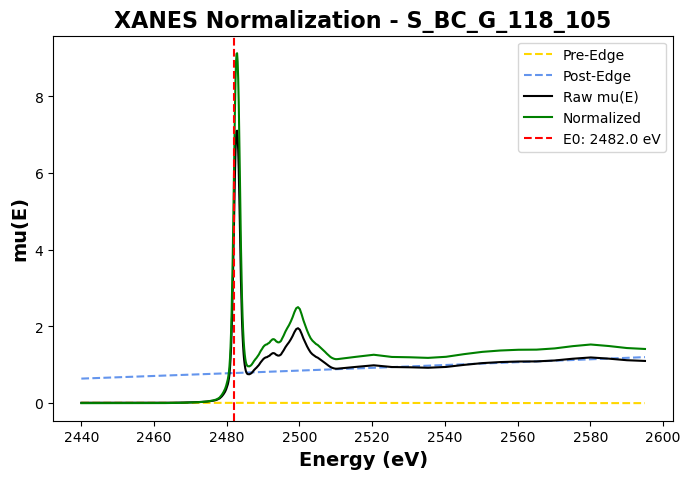

✅ Normalized S_BC_G_118_105 (E0 = 2482.0 eV)


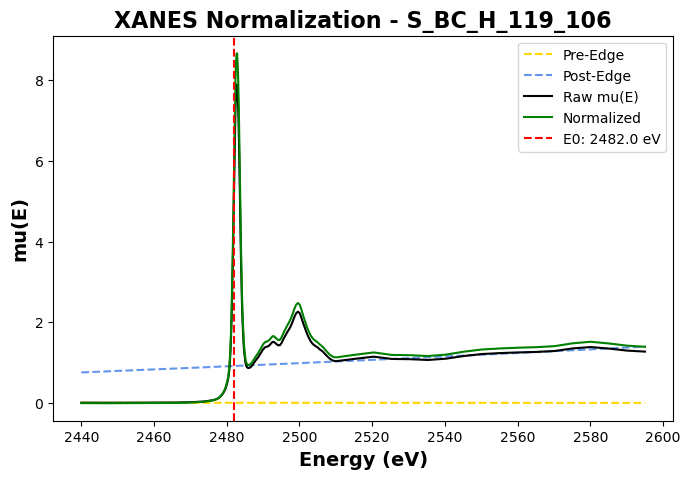

✅ Normalized S_BC_H_119_106 (E0 = 2482.0 eV)


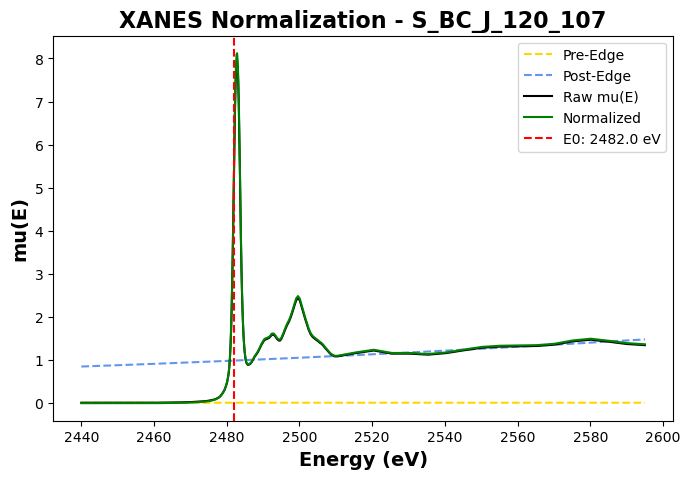

✅ Normalized S_BC_J_120_107 (E0 = 2482.0 eV)


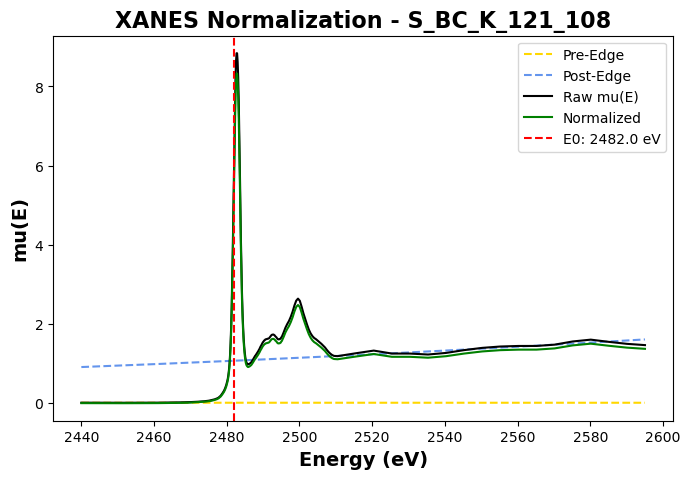

✅ Normalized S_BC_K_121_108 (E0 = 2482.0 eV)


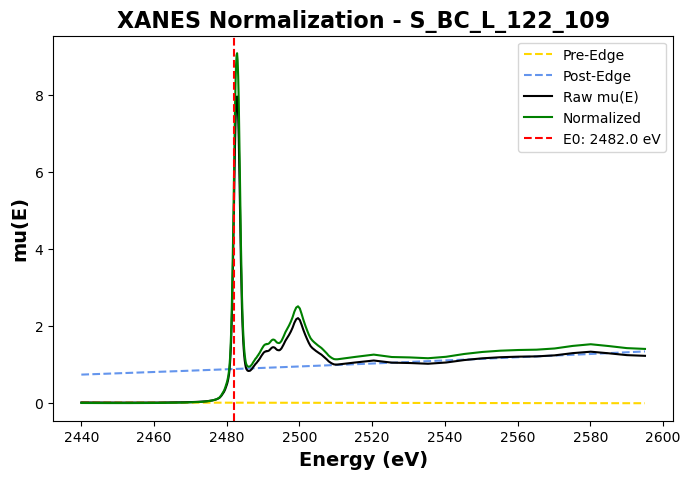

✅ Normalized S_BC_L_122_109 (E0 = 2482.0 eV)


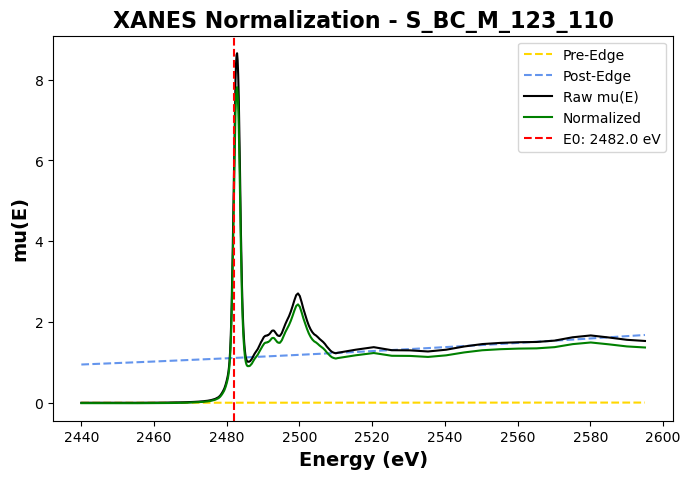

✅ Normalized S_BC_M_123_110 (E0 = 2482.0 eV)


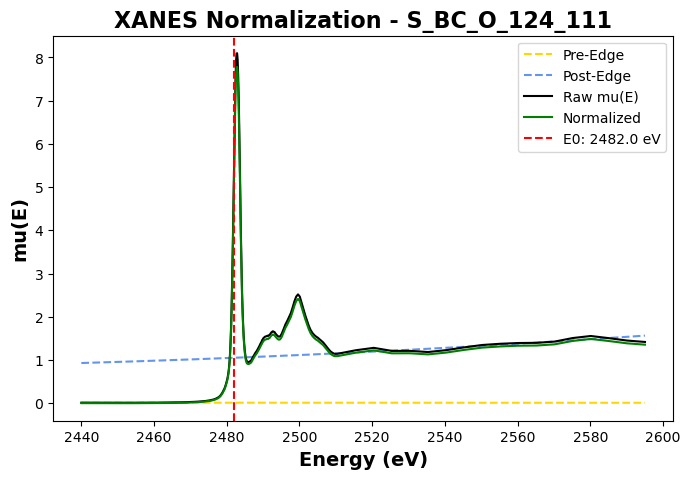

✅ Normalized S_BC_O_124_111 (E0 = 2482.0 eV)


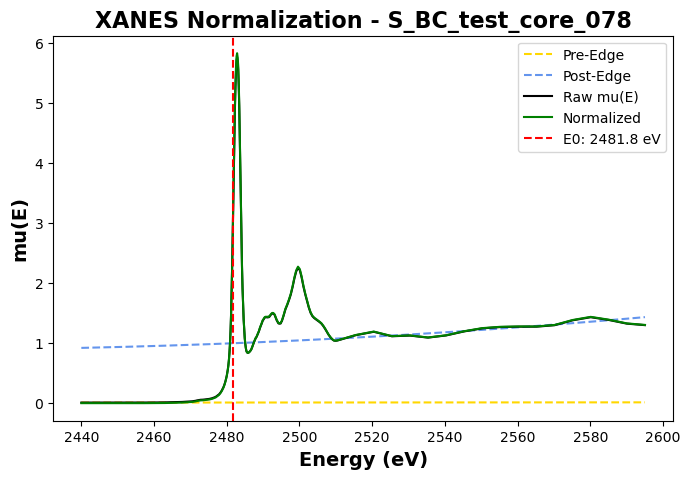

✅ Normalized S_BC_test_core_078 (E0 = 2481.8 eV)


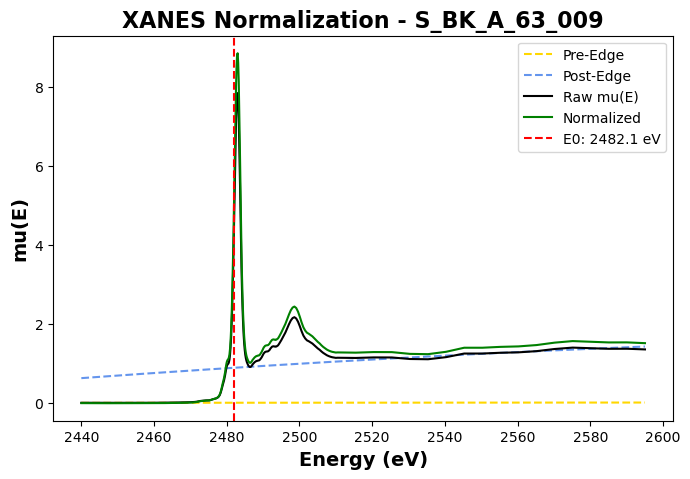

✅ Normalized S_BK_A_63_009 (E0 = 2482.1 eV)


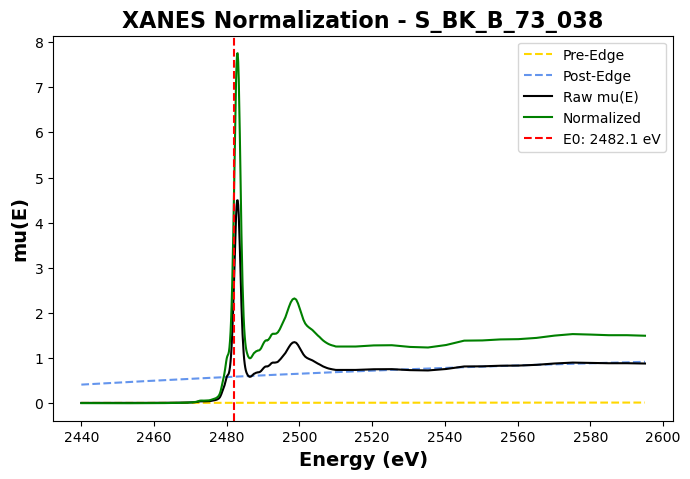

✅ Normalized S_BK_B_73_038 (E0 = 2482.1 eV)


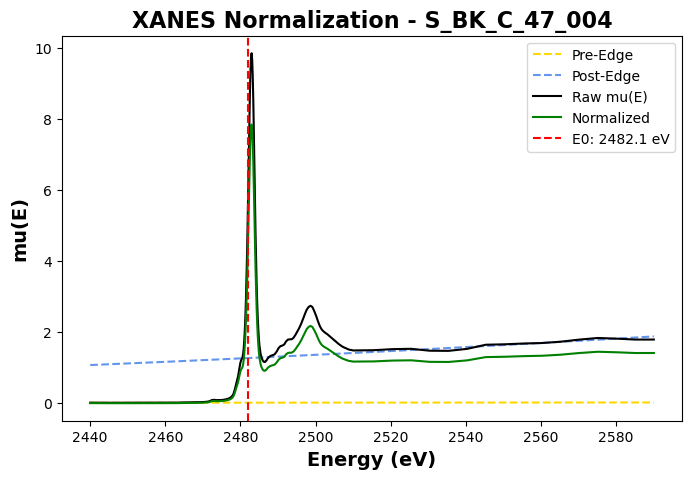

✅ Normalized S_BK_C_47_004 (E0 = 2482.1 eV)


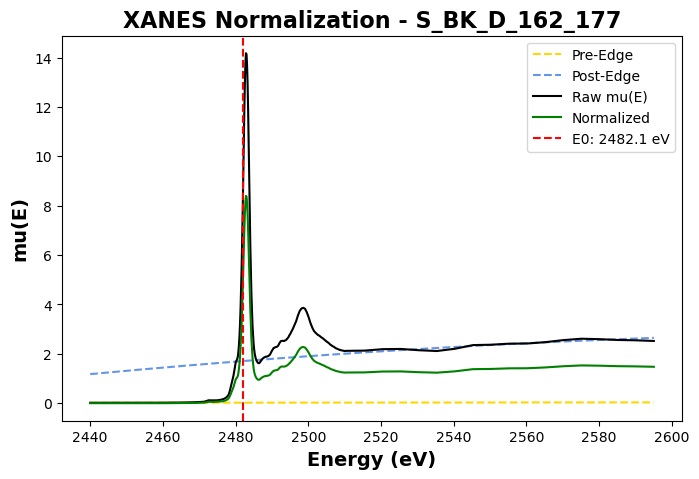

✅ Normalized S_BK_D_162_177 (E0 = 2482.1 eV)


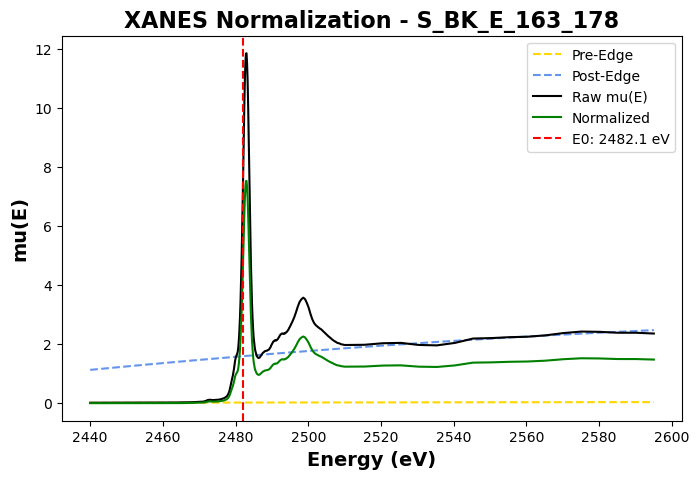

✅ Normalized S_BK_E_163_178 (E0 = 2482.1 eV)


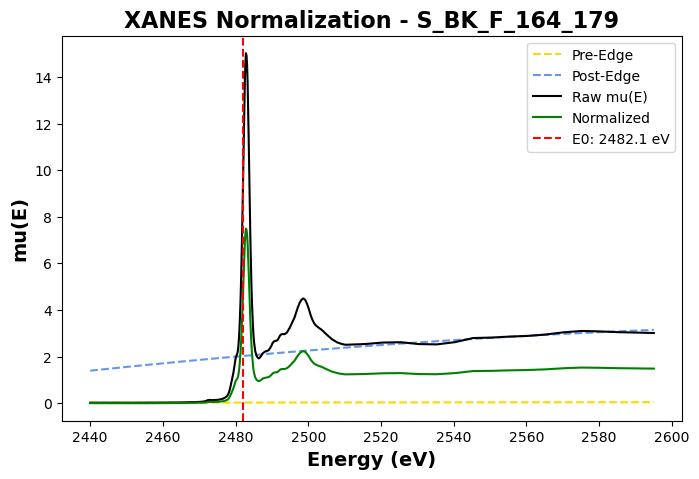

✅ Normalized S_BK_F_164_179 (E0 = 2482.1 eV)


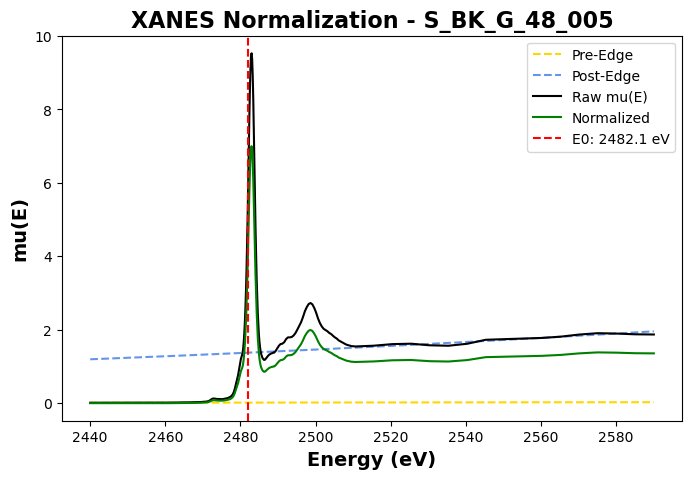

✅ Normalized S_BK_G_48_005 (E0 = 2482.1 eV)


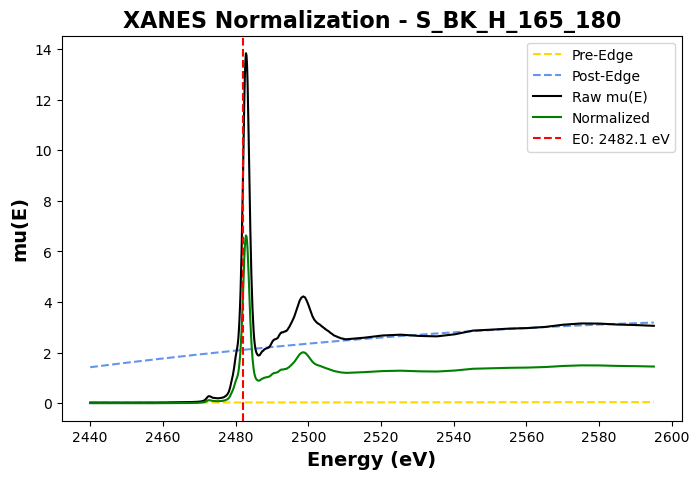

✅ Normalized S_BK_H_165_180 (E0 = 2482.1 eV)


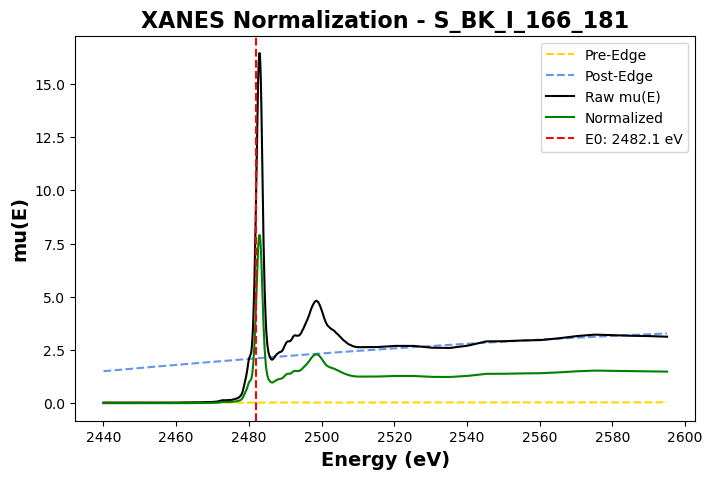

✅ Normalized S_BK_I_166_181 (E0 = 2482.1 eV)


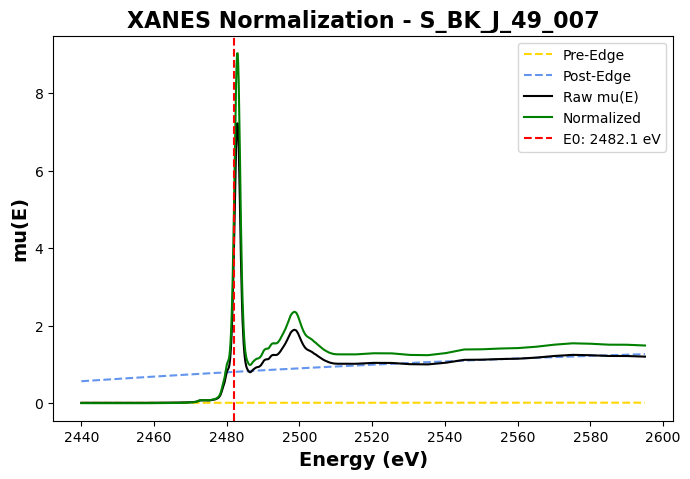

✅ Normalized S_BK_J_49_007 (E0 = 2482.1 eV)


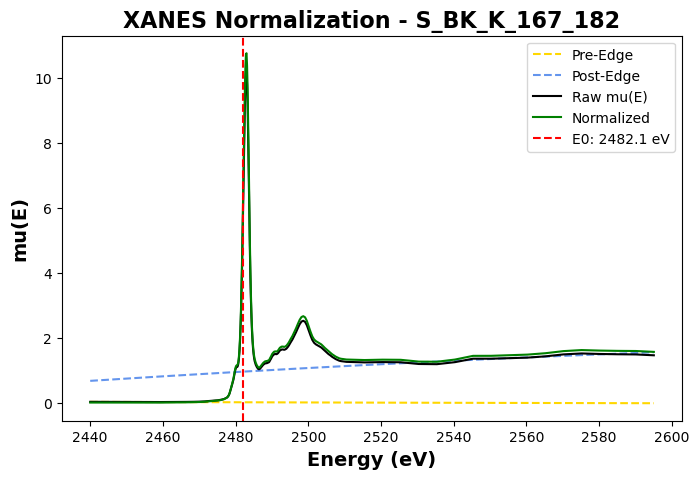

✅ Normalized S_BK_K_167_182 (E0 = 2482.1 eV)


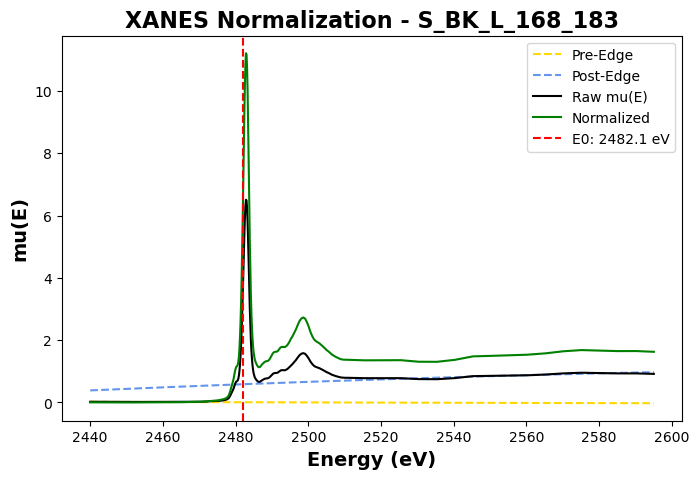

✅ Normalized S_BK_L_168_183 (E0 = 2482.1 eV)


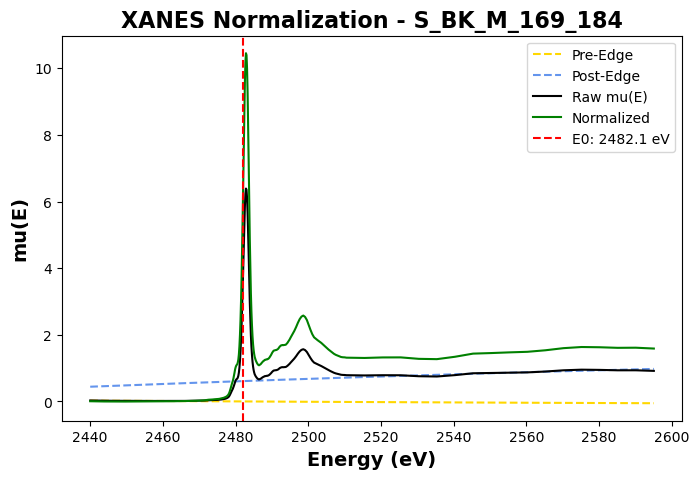

✅ Normalized S_BK_M_169_184 (E0 = 2482.1 eV)


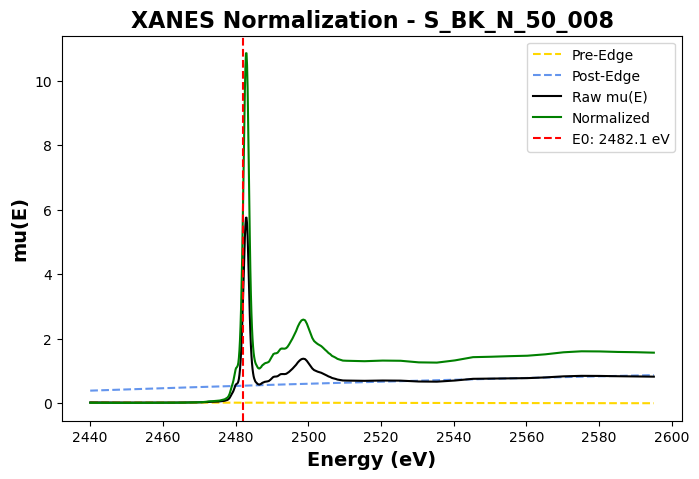

✅ Normalized S_BK_N_50_008 (E0 = 2482.1 eV)


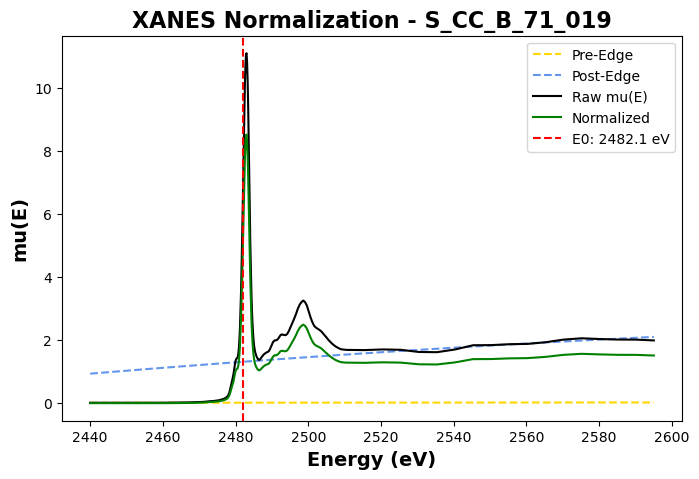

✅ Normalized S_CC_B_71_019 (E0 = 2482.1 eV)


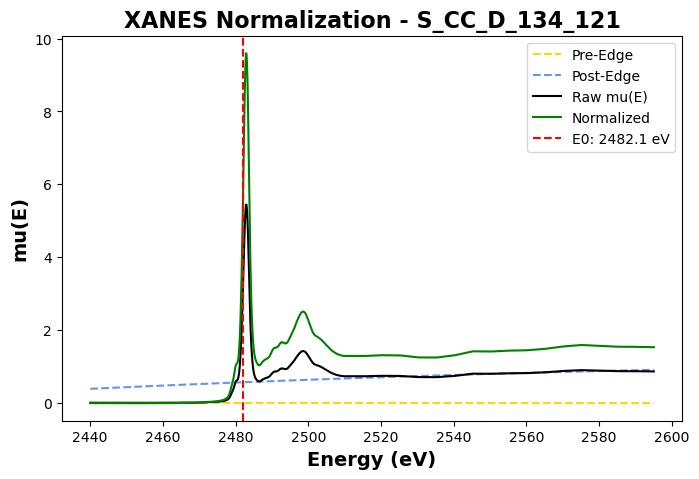

✅ Normalized S_CC_D_134_121 (E0 = 2482.1 eV)


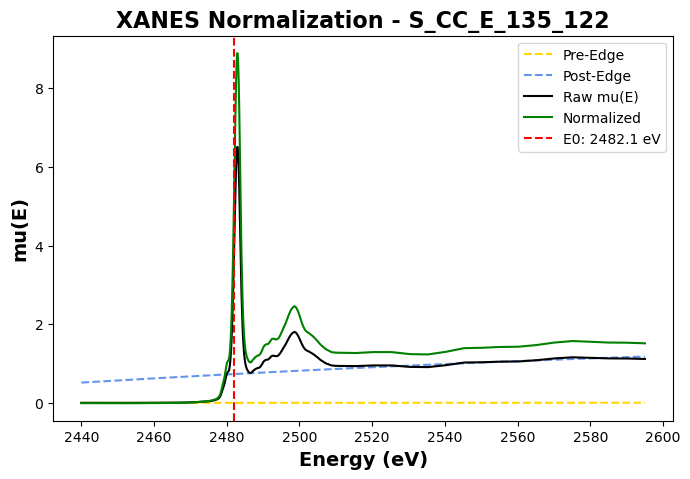

✅ Normalized S_CC_E_135_122 (E0 = 2482.1 eV)


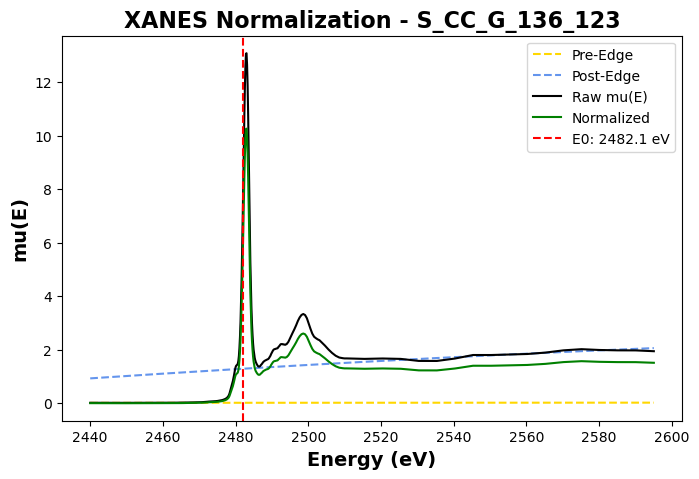

✅ Normalized S_CC_G_136_123 (E0 = 2482.1 eV)


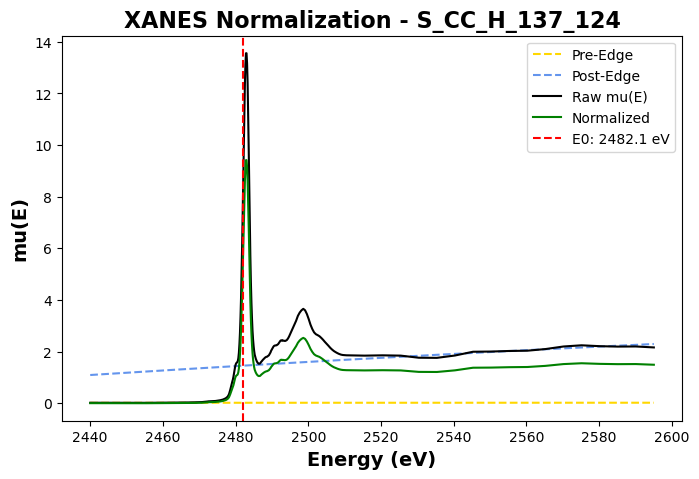

✅ Normalized S_CC_H_137_124 (E0 = 2482.1 eV)


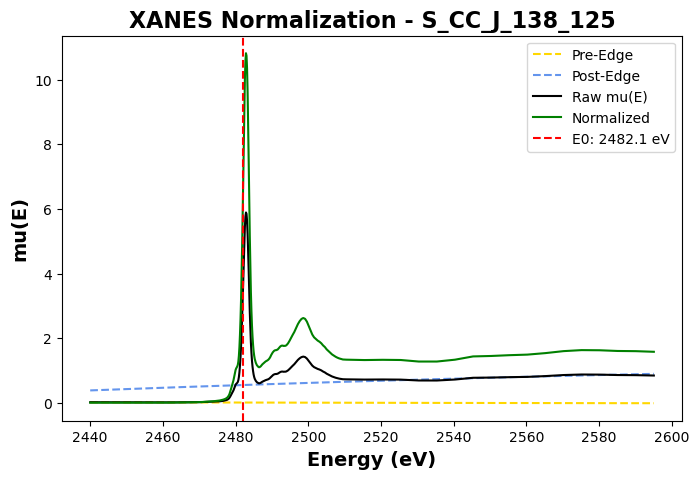

✅ Normalized S_CC_J_138_125 (E0 = 2482.1 eV)


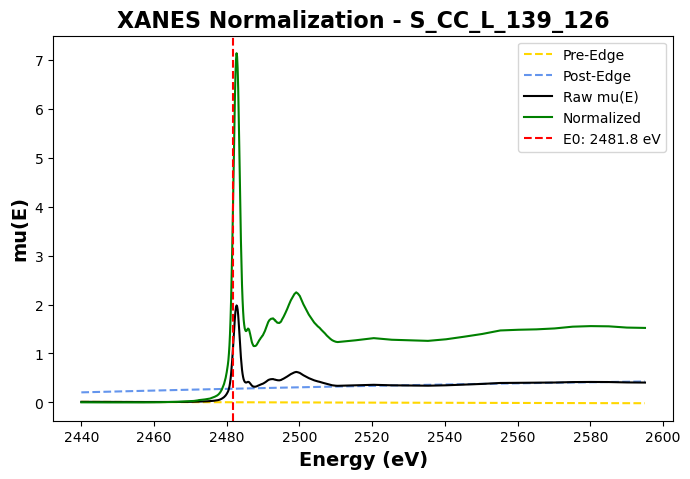

✅ Normalized S_CC_L_139_126 (E0 = 2481.8 eV)


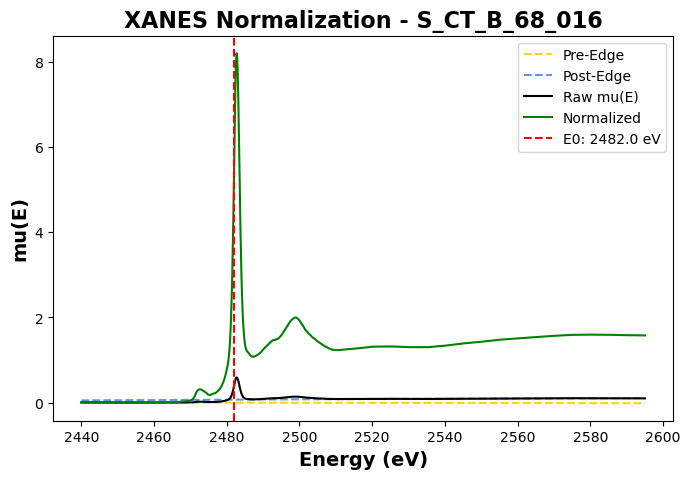

✅ Normalized S_CT_B_68_016 (E0 = 2482.0 eV)


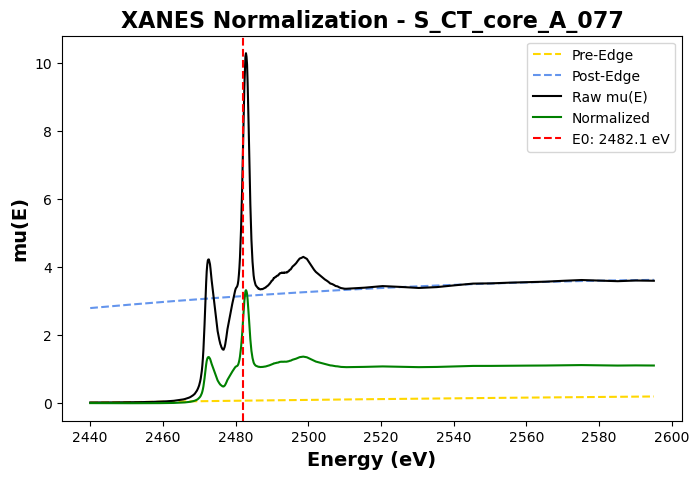

✅ Normalized S_CT_core_A_077 (E0 = 2482.1 eV)


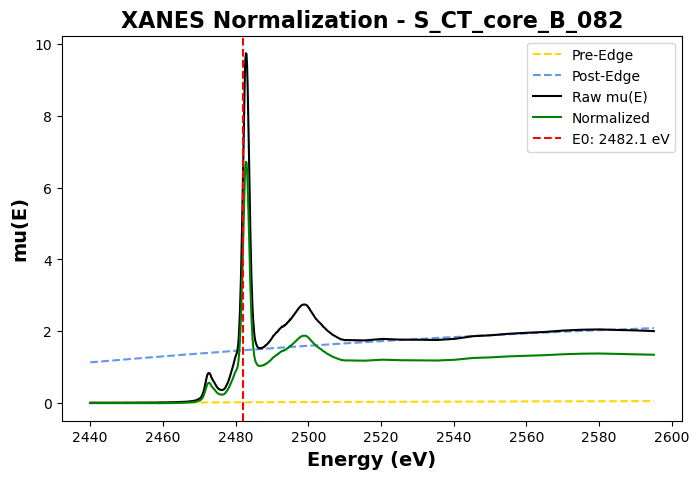

✅ Normalized S_CT_core_B_082 (E0 = 2482.1 eV)


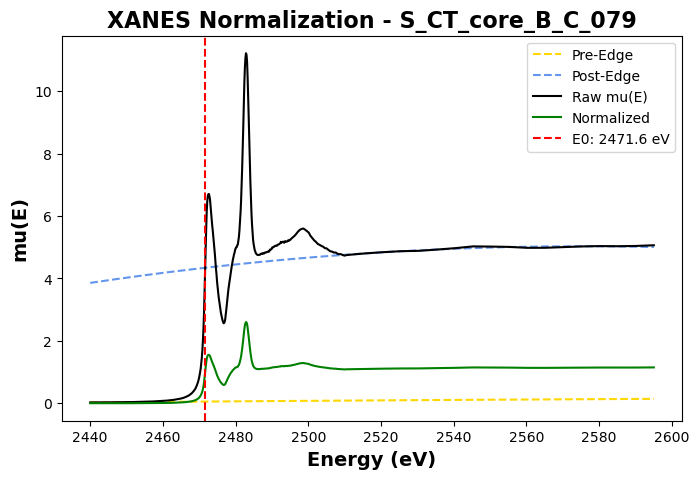

✅ Normalized S_CT_core_B_C_079 (E0 = 2471.6 eV)


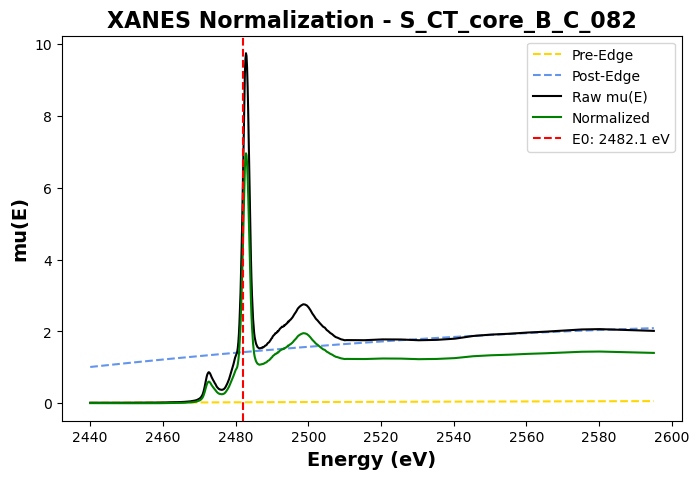

✅ Normalized S_CT_core_B_C_082 (E0 = 2482.1 eV)


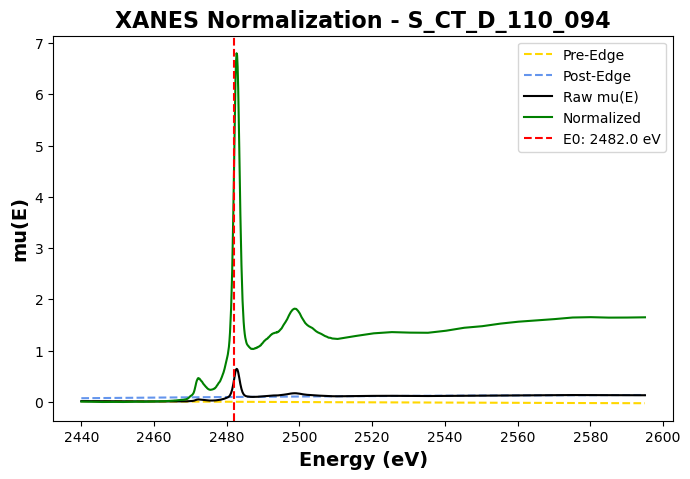

✅ Normalized S_CT_D_110_094 (E0 = 2482.0 eV)


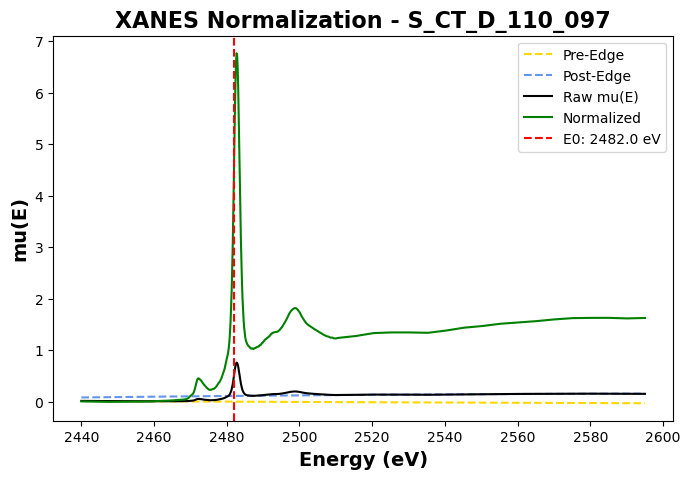

✅ Normalized S_CT_D_110_097 (E0 = 2482.0 eV)


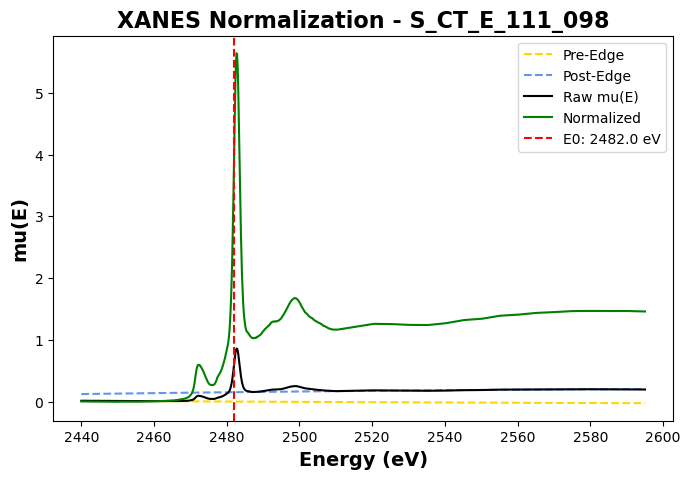

✅ Normalized S_CT_E_111_098 (E0 = 2482.0 eV)


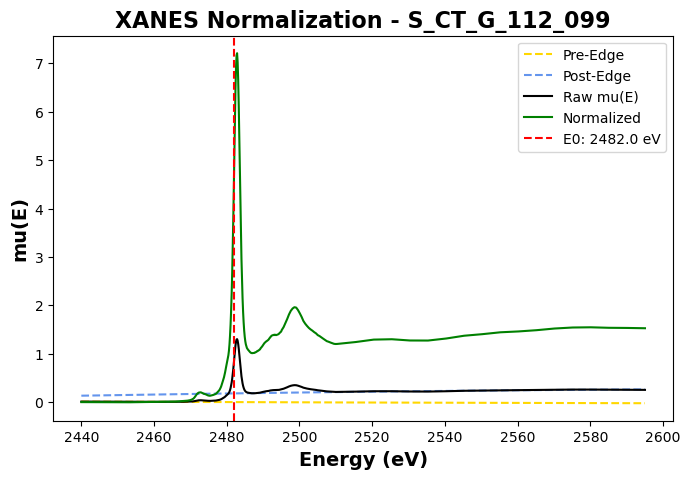

✅ Normalized S_CT_G_112_099 (E0 = 2482.0 eV)


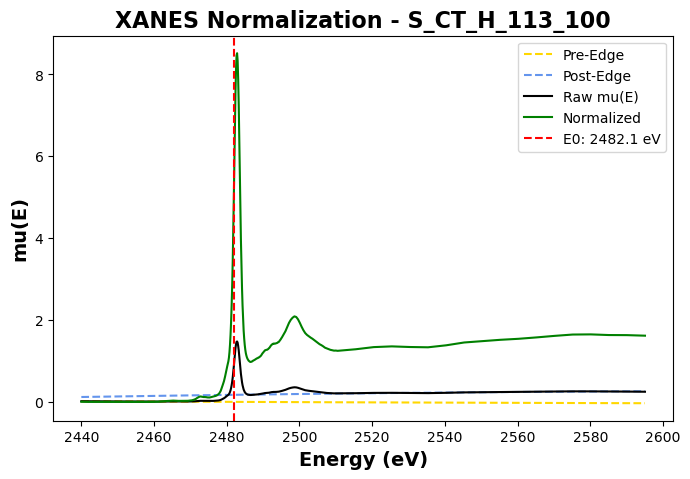

✅ Normalized S_CT_H_113_100 (E0 = 2482.1 eV)


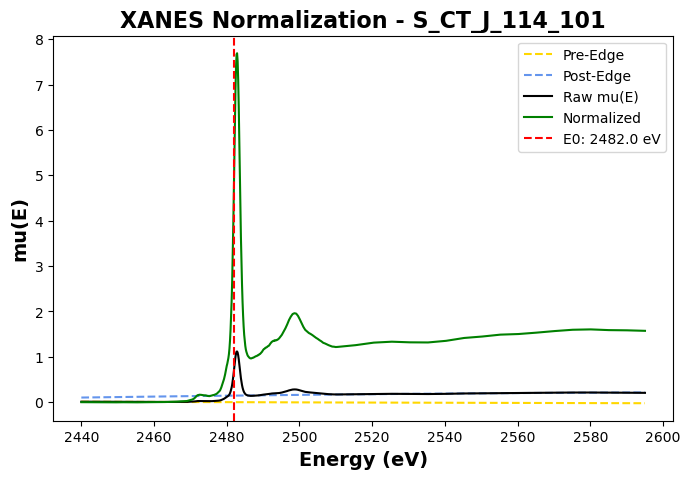

✅ Normalized S_CT_J_114_101 (E0 = 2482.0 eV)


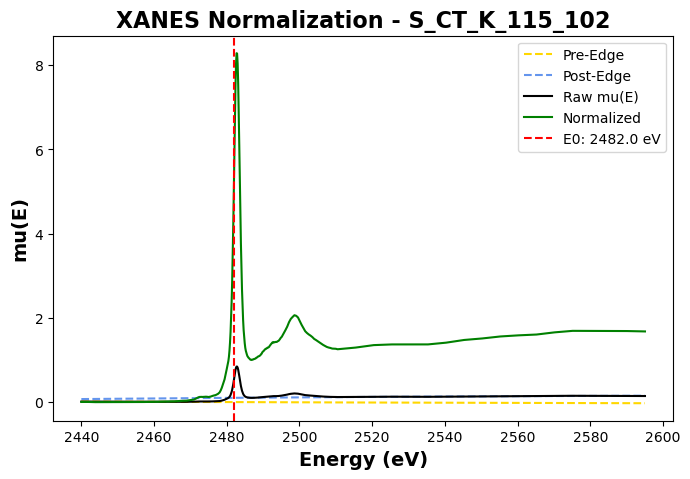

✅ Normalized S_CT_K_115_102 (E0 = 2482.0 eV)


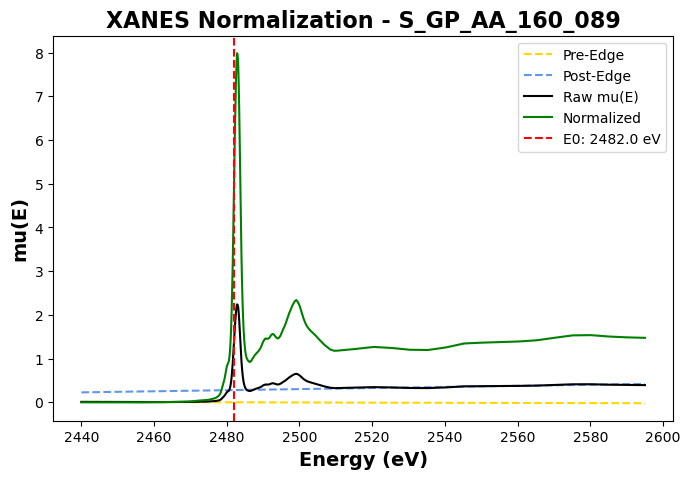

✅ Normalized S_GP_AA_160_089 (E0 = 2482.0 eV)


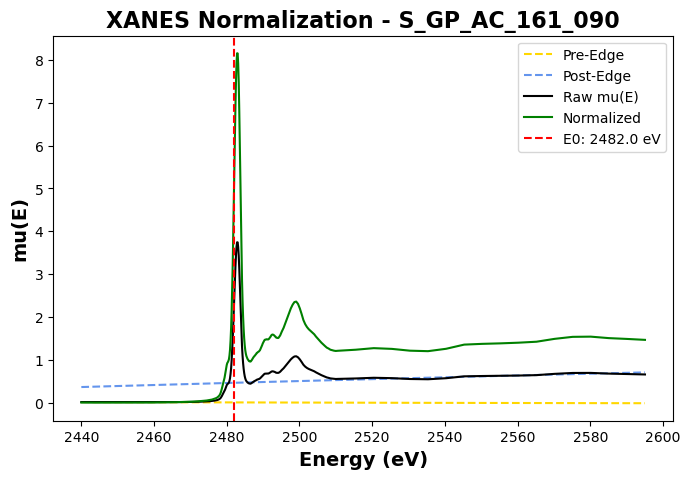

✅ Normalized S_GP_AC_161_090 (E0 = 2482.0 eV)


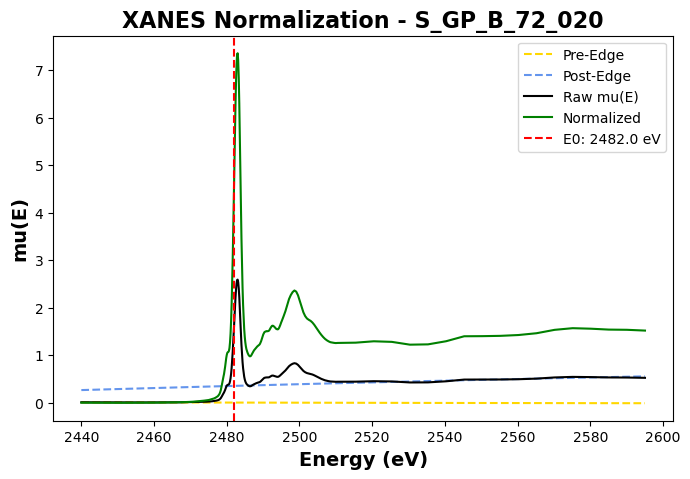

✅ Normalized S_GP_B_72_020 (E0 = 2482.0 eV)


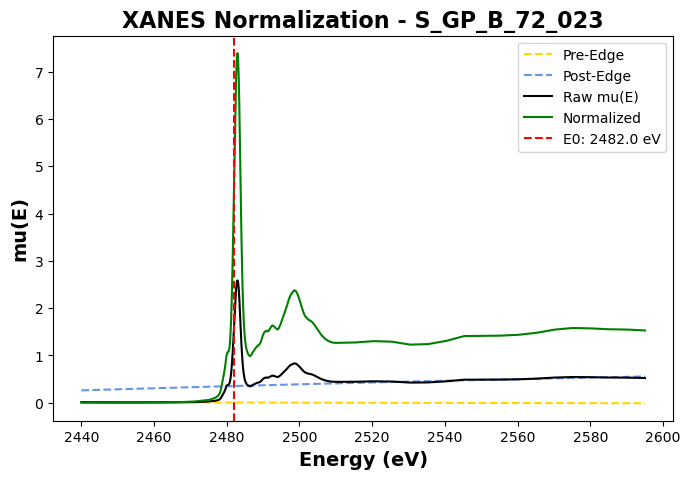

✅ Normalized S_GP_B_72_023 (E0 = 2482.0 eV)


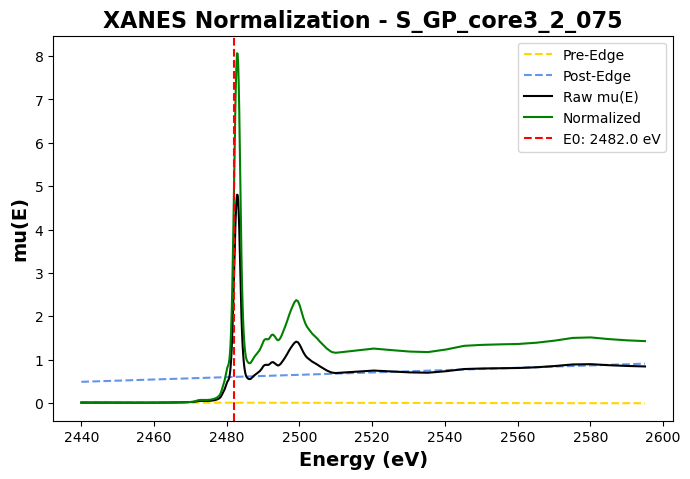

✅ Normalized S_GP_core3_2_075 (E0 = 2482.0 eV)


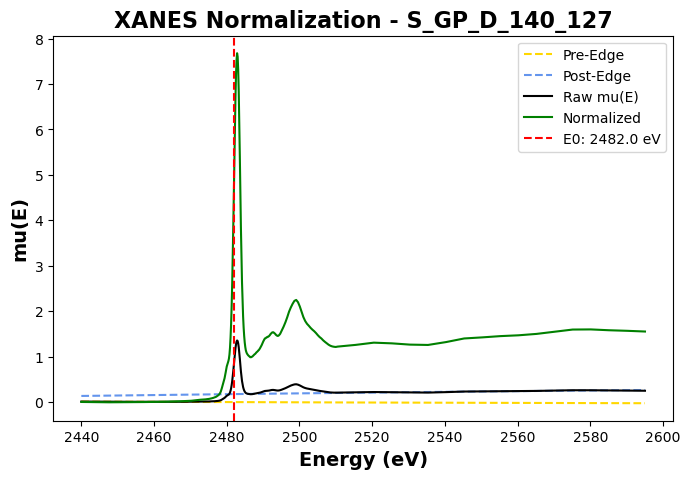

✅ Normalized S_GP_D_140_127 (E0 = 2482.0 eV)


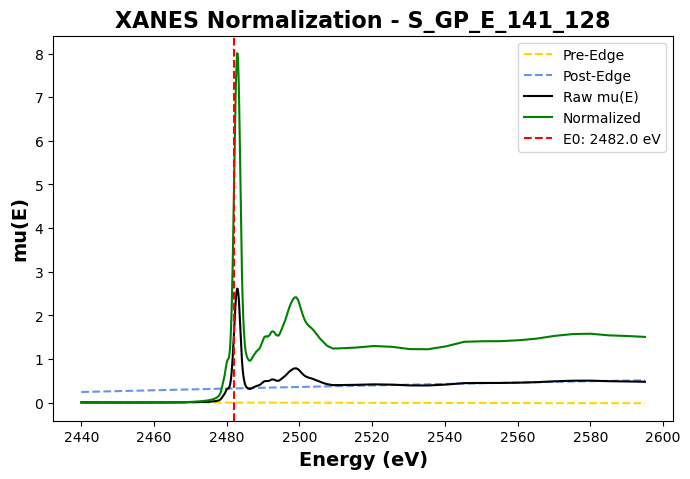

✅ Normalized S_GP_E_141_128 (E0 = 2482.0 eV)


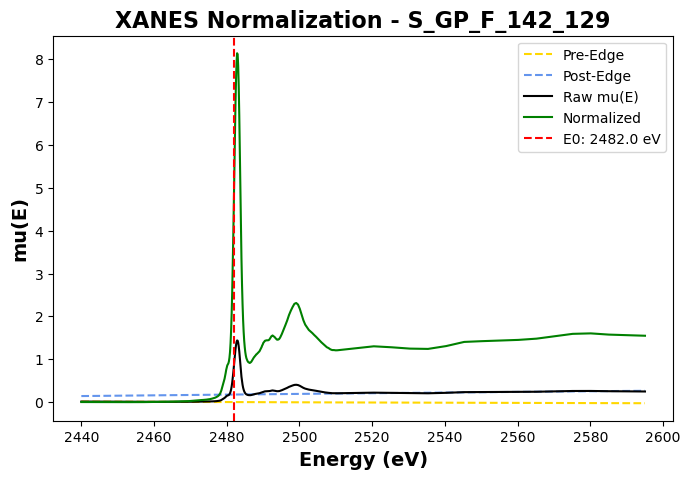

✅ Normalized S_GP_F_142_129 (E0 = 2482.0 eV)


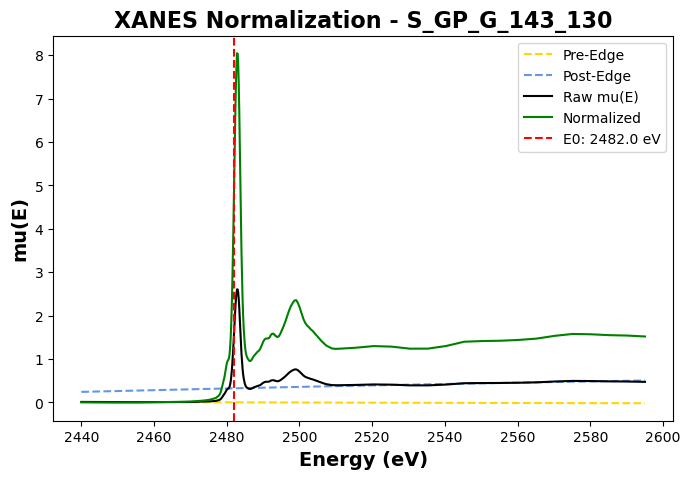

✅ Normalized S_GP_G_143_130 (E0 = 2482.0 eV)


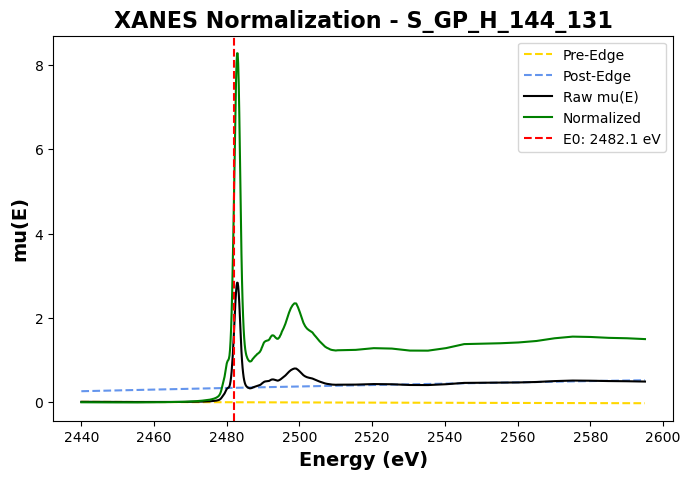

✅ Normalized S_GP_H_144_131 (E0 = 2482.1 eV)


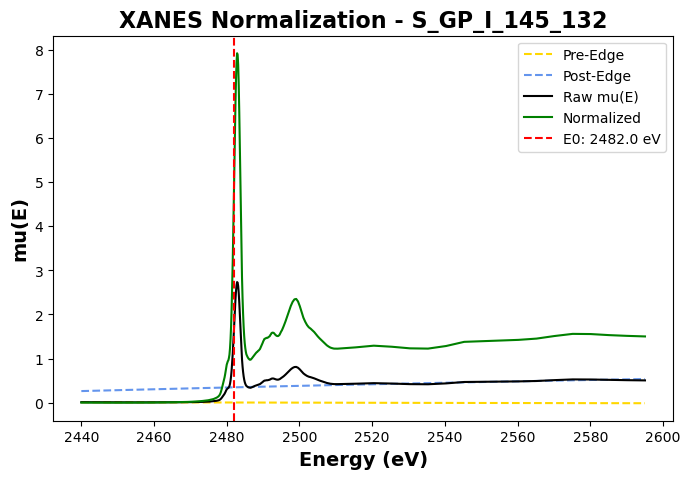

✅ Normalized S_GP_I_145_132 (E0 = 2482.0 eV)


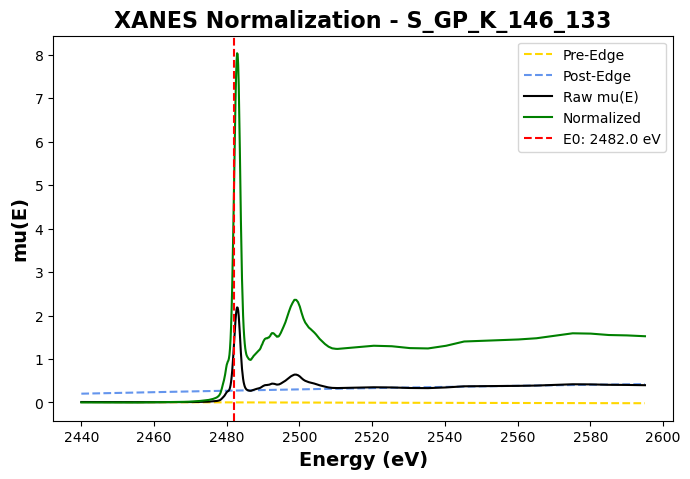

✅ Normalized S_GP_K_146_133 (E0 = 2482.0 eV)


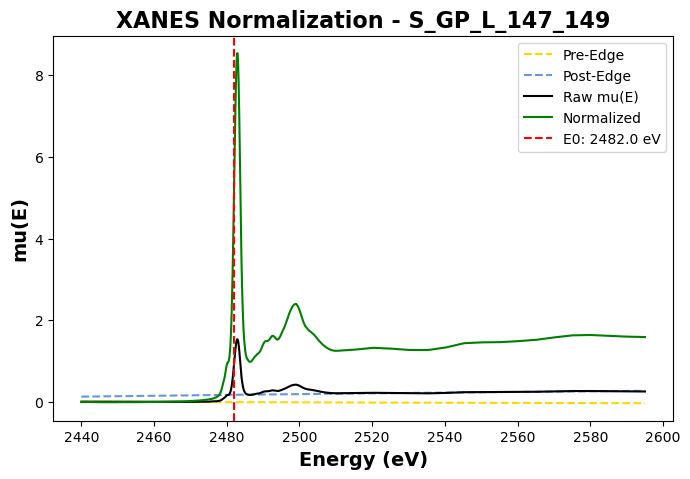

✅ Normalized S_GP_L_147_149 (E0 = 2482.0 eV)


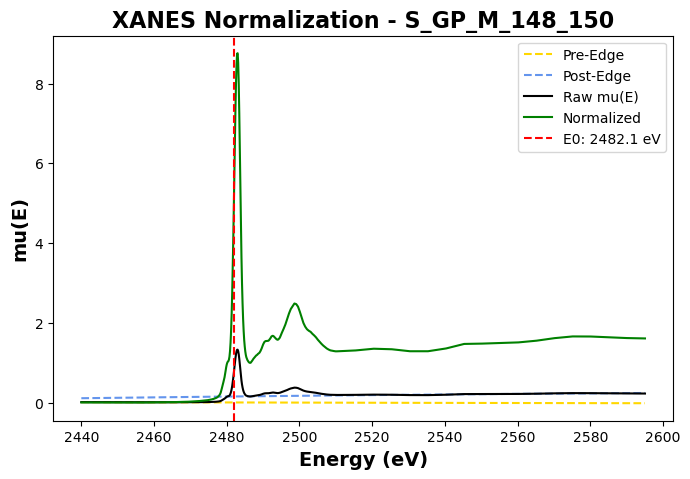

✅ Normalized S_GP_M_148_150 (E0 = 2482.1 eV)


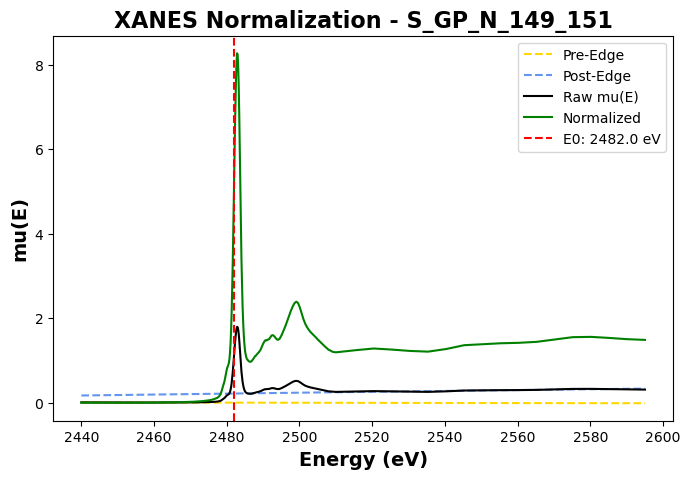

✅ Normalized S_GP_N_149_151 (E0 = 2482.0 eV)


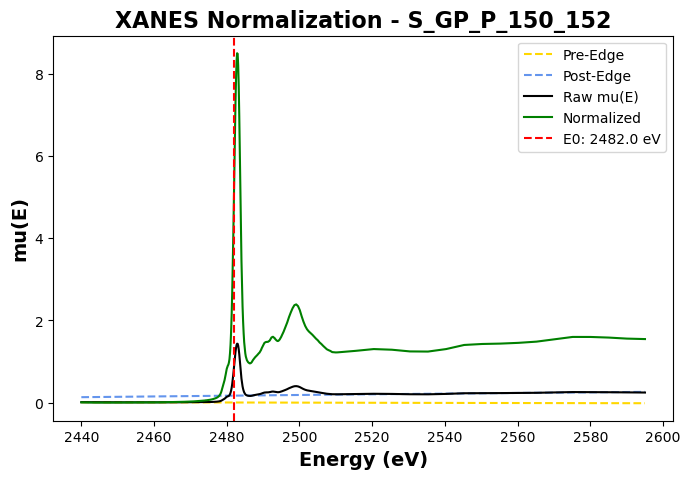

✅ Normalized S_GP_P_150_152 (E0 = 2482.0 eV)


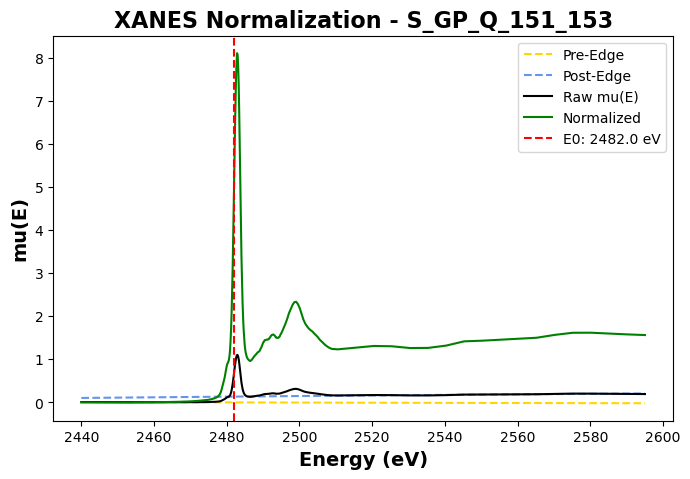

✅ Normalized S_GP_Q_151_153 (E0 = 2482.0 eV)


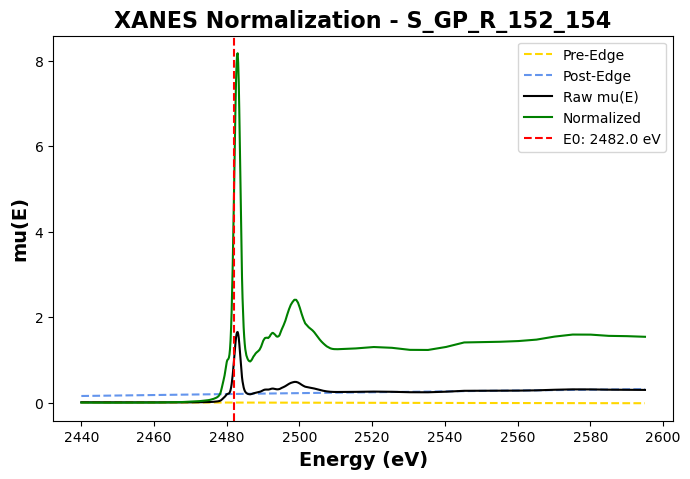

✅ Normalized S_GP_R_152_154 (E0 = 2482.0 eV)


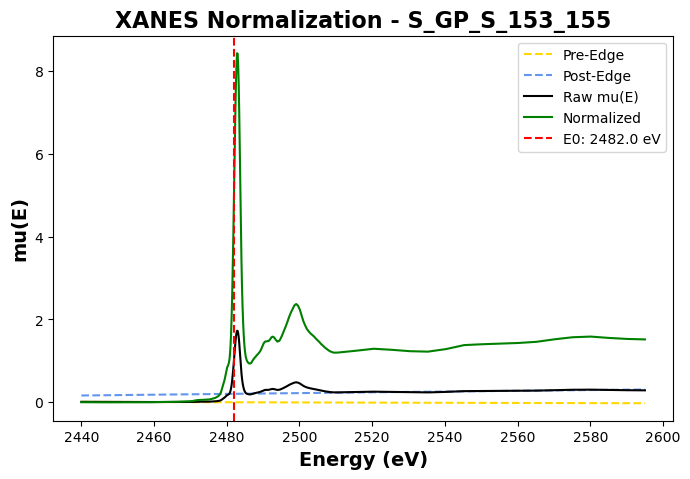

✅ Normalized S_GP_S_153_155 (E0 = 2482.0 eV)


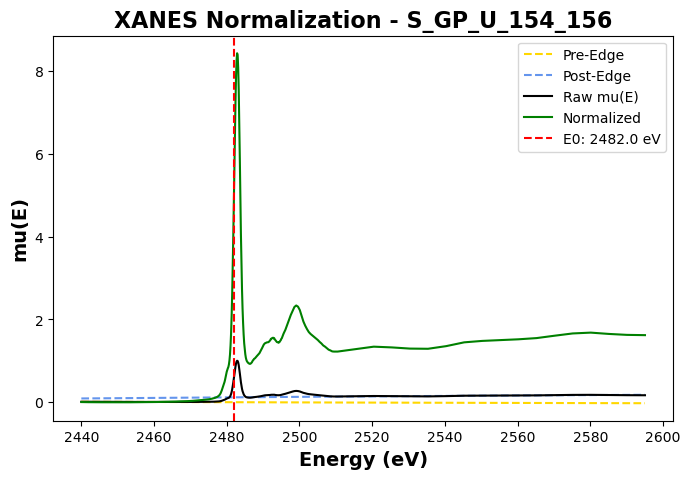

✅ Normalized S_GP_U_154_156 (E0 = 2482.0 eV)


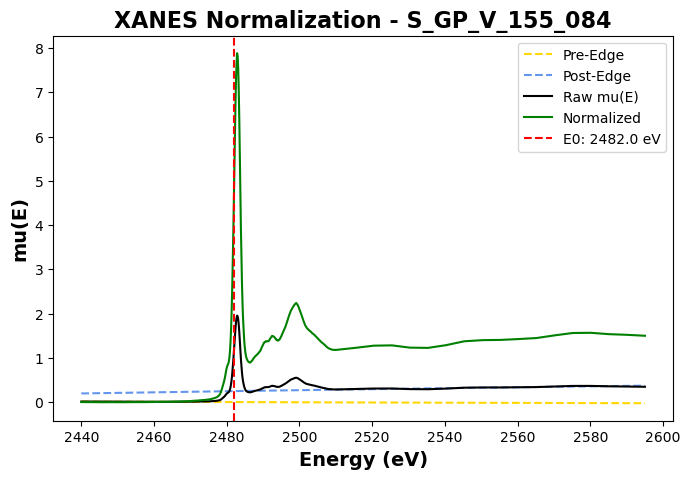

✅ Normalized S_GP_V_155_084 (E0 = 2482.0 eV)


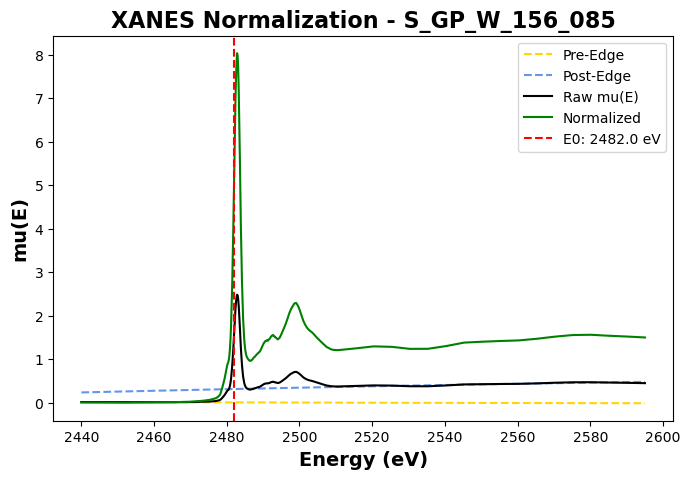

✅ Normalized S_GP_W_156_085 (E0 = 2482.0 eV)


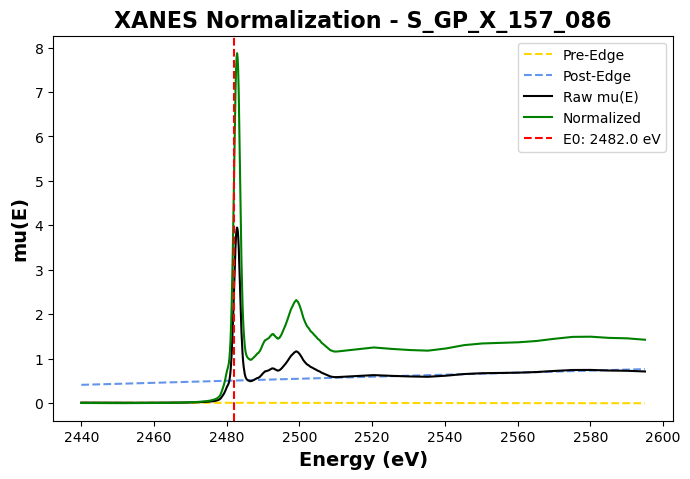

✅ Normalized S_GP_X_157_086 (E0 = 2482.0 eV)


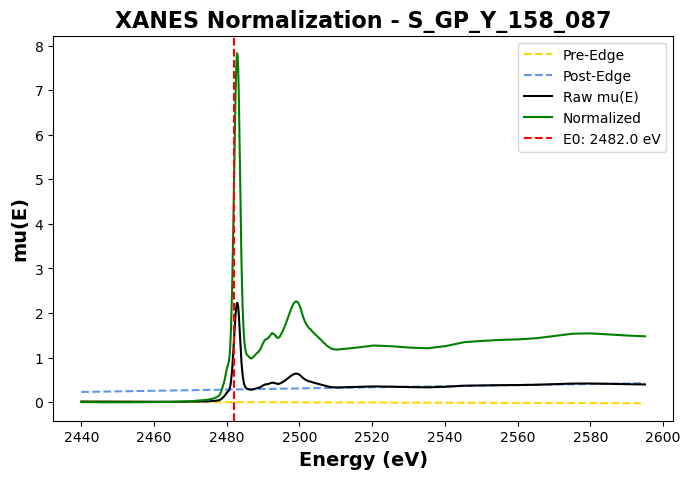

✅ Normalized S_GP_Y_158_087 (E0 = 2482.0 eV)


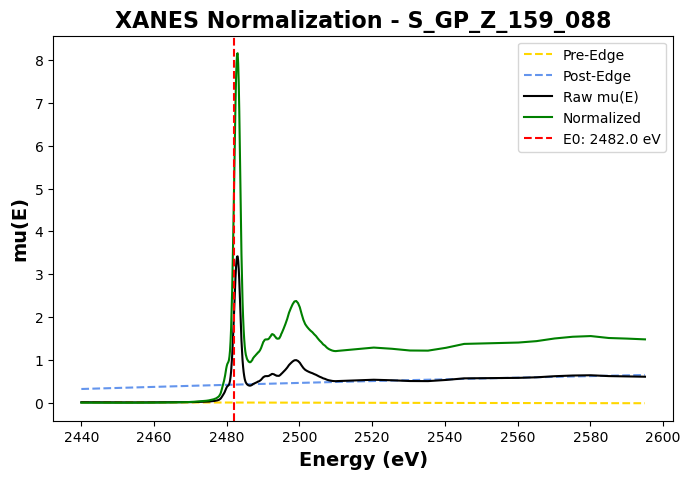

✅ Normalized S_GP_Z_159_088 (E0 = 2482.0 eV)


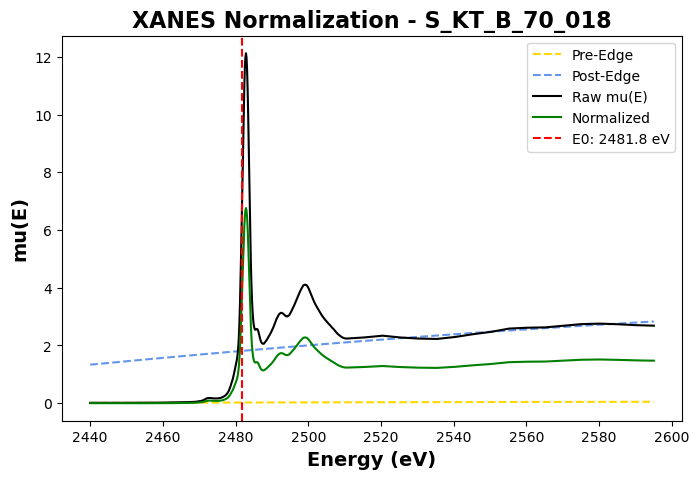

✅ Normalized S_KT_B_70_018 (E0 = 2481.8 eV)


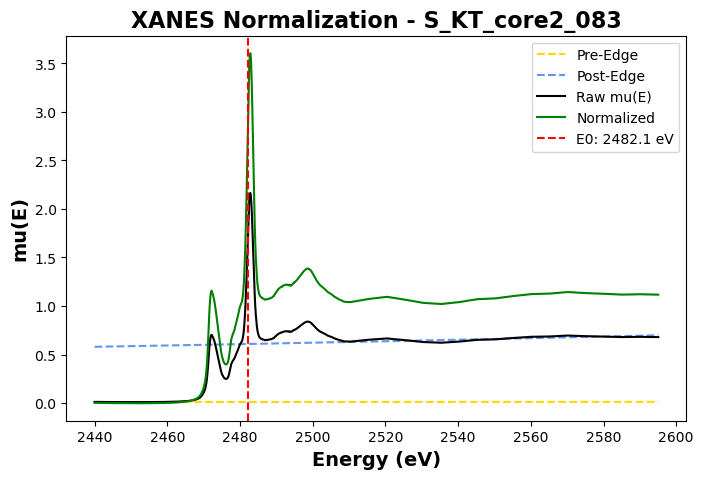

✅ Normalized S_KT_core2_083 (E0 = 2482.1 eV)


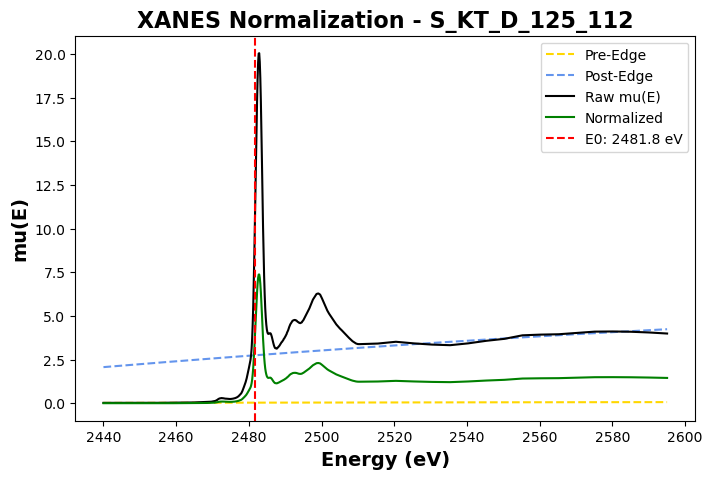

✅ Normalized S_KT_D_125_112 (E0 = 2481.8 eV)


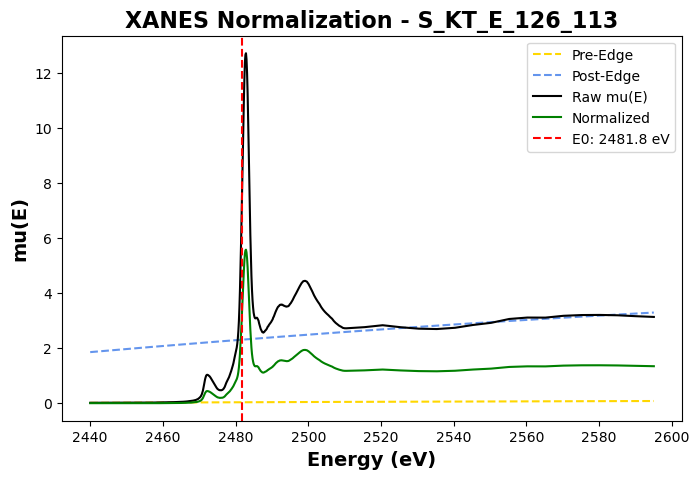

✅ Normalized S_KT_E_126_113 (E0 = 2481.8 eV)


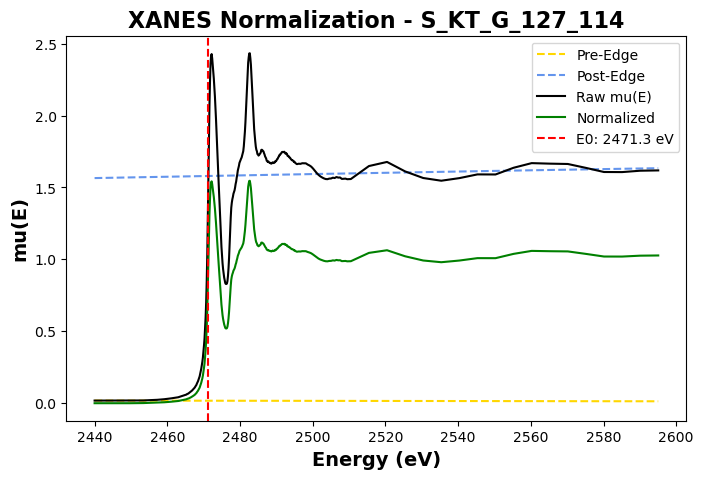

✅ Normalized S_KT_G_127_114 (E0 = 2471.3 eV)


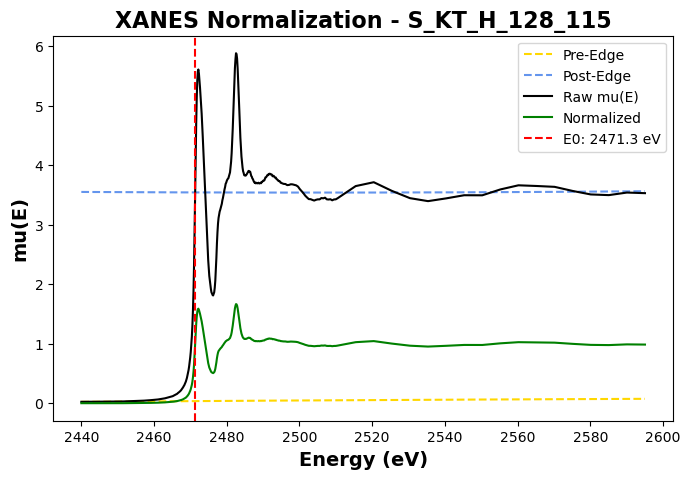

✅ Normalized S_KT_H_128_115 (E0 = 2471.3 eV)


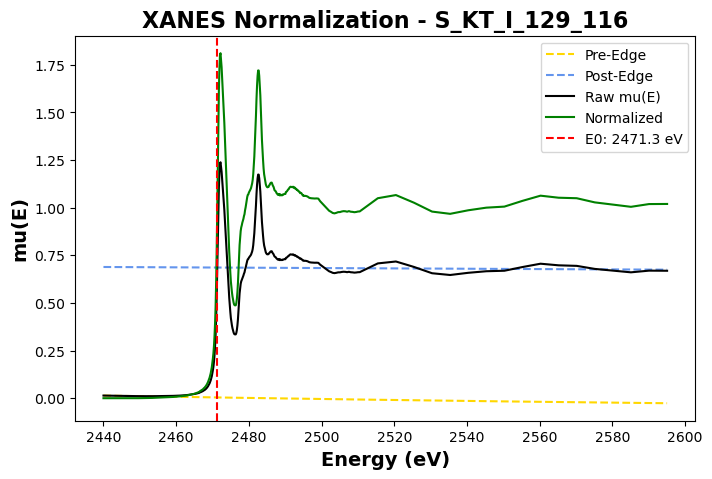

✅ Normalized S_KT_I_129_116 (E0 = 2471.3 eV)


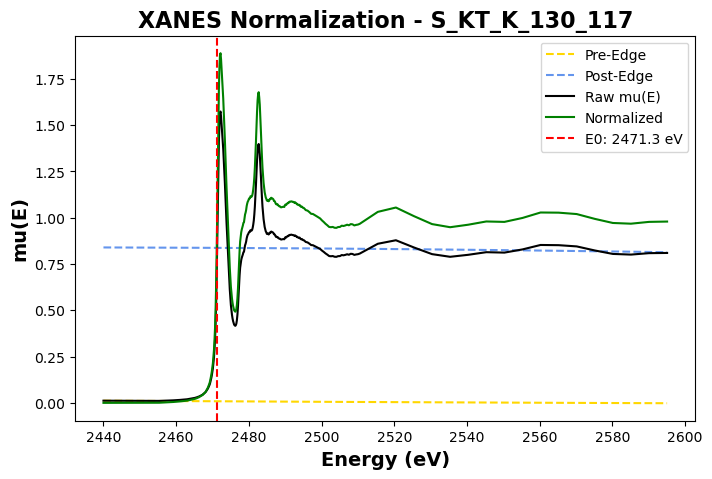

✅ Normalized S_KT_K_130_117 (E0 = 2471.3 eV)


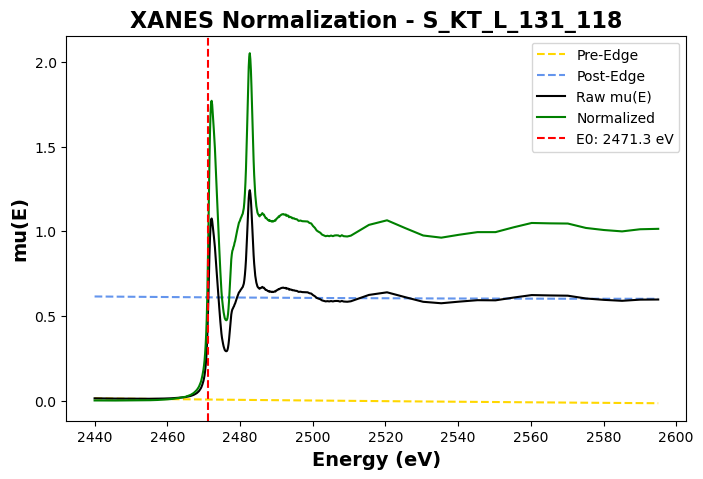

✅ Normalized S_KT_L_131_118 (E0 = 2471.3 eV)


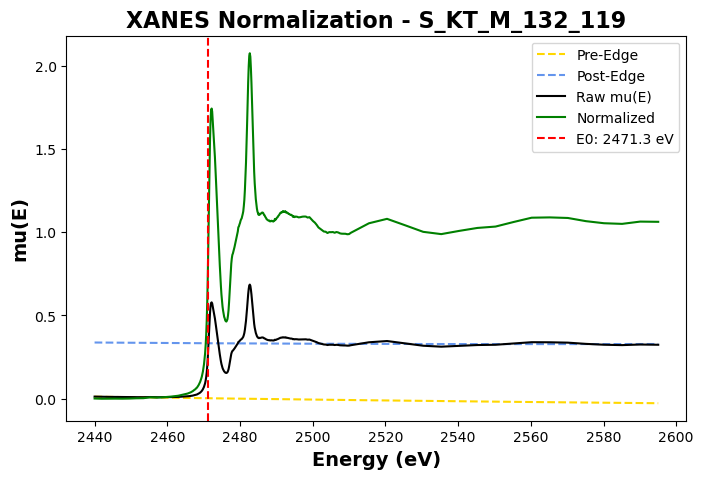

✅ Normalized S_KT_M_132_119 (E0 = 2471.3 eV)


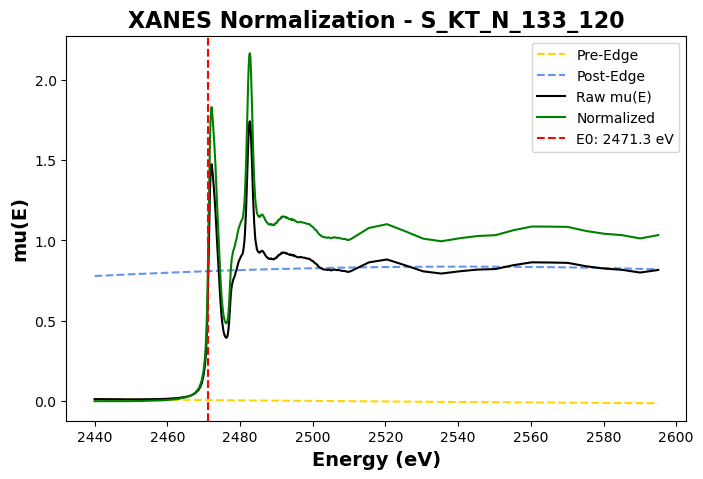

✅ Normalized S_KT_N_133_120 (E0 = 2471.3 eV)


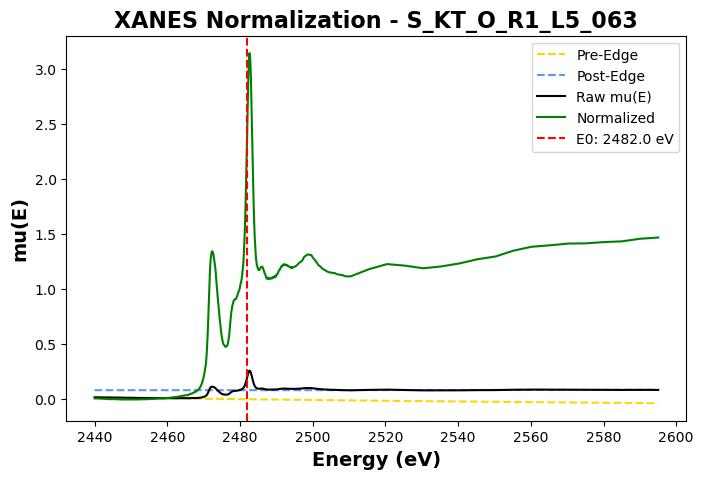

✅ Normalized S_KT_O_R1_L5_063 (E0 = 2482.0 eV)


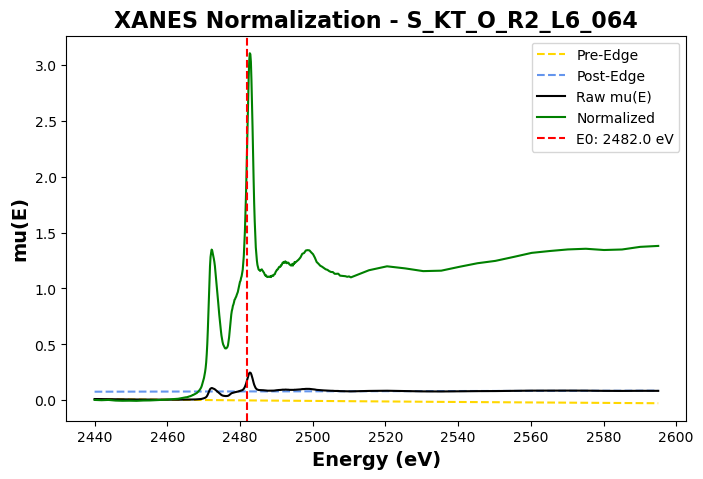

✅ Normalized S_KT_O_R2_L6_064 (E0 = 2482.0 eV)


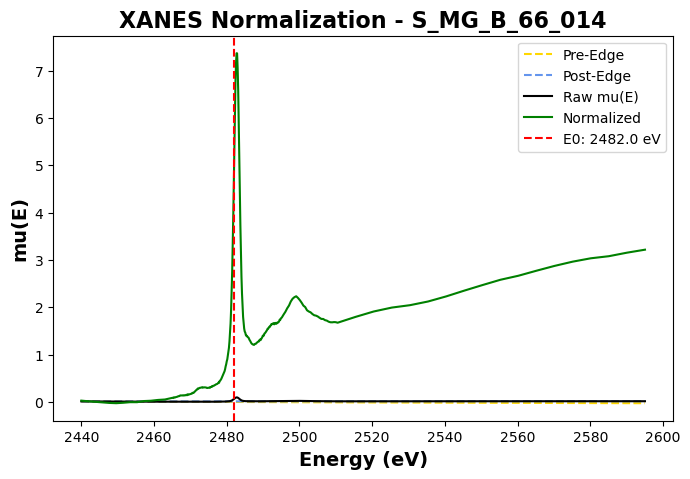

✅ Normalized S_MG_B_66_014 (E0 = 2482.0 eV)


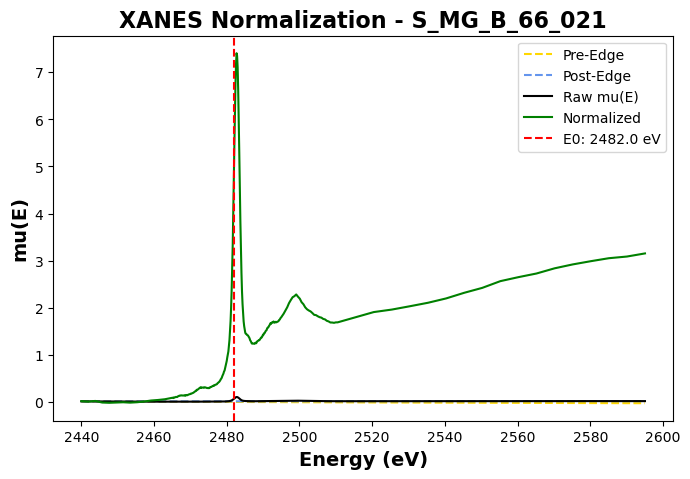

✅ Normalized S_MG_B_66_021 (E0 = 2482.0 eV)


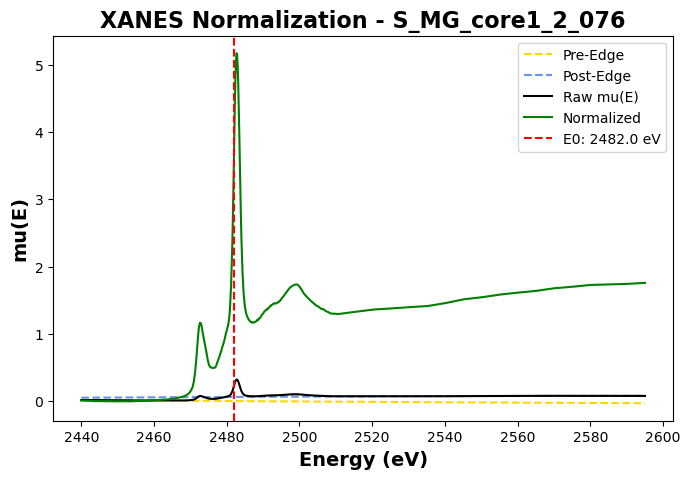

✅ Normalized S_MG_core1_2_076 (E0 = 2482.0 eV)


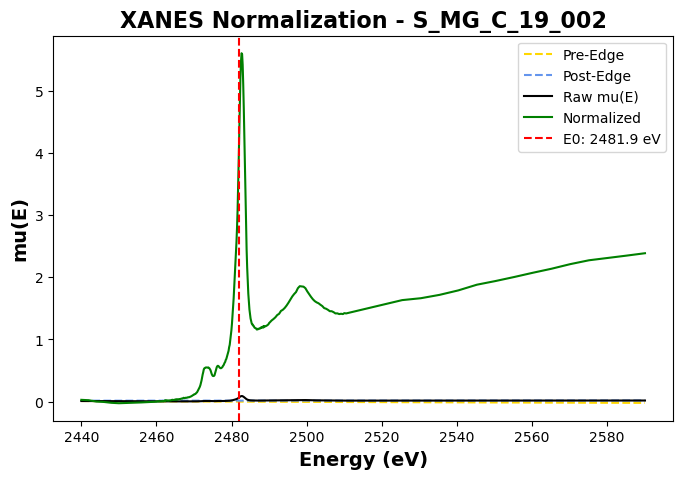

✅ Normalized S_MG_C_19_002 (E0 = 2481.9 eV)


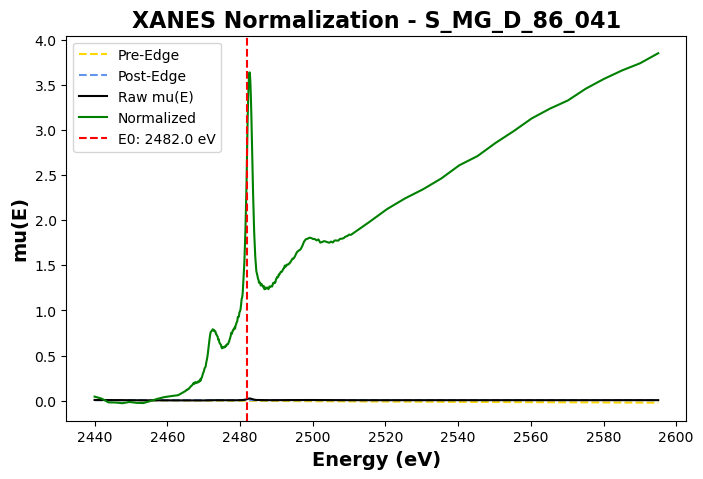

✅ Normalized S_MG_D_86_041 (E0 = 2482.0 eV)


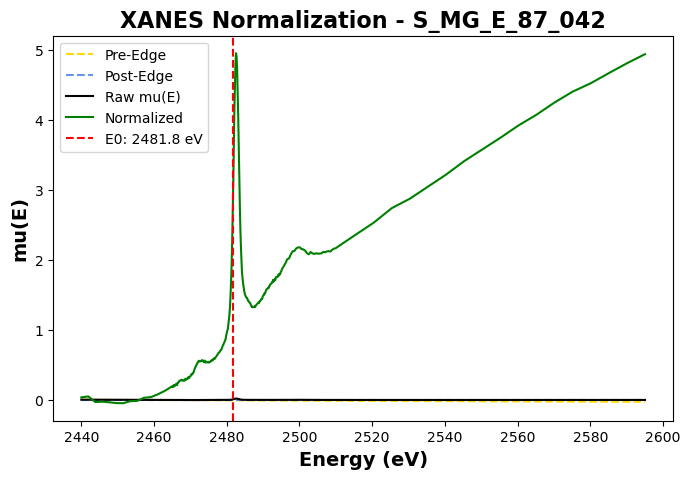

✅ Normalized S_MG_E_87_042 (E0 = 2481.8 eV)


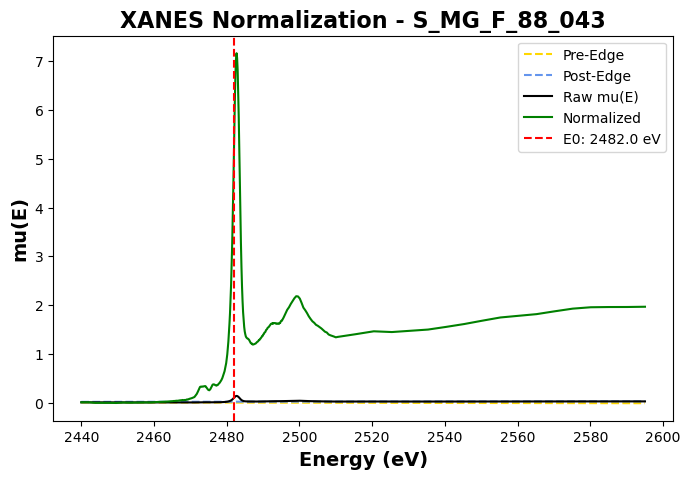

✅ Normalized S_MG_F_88_043 (E0 = 2482.0 eV)


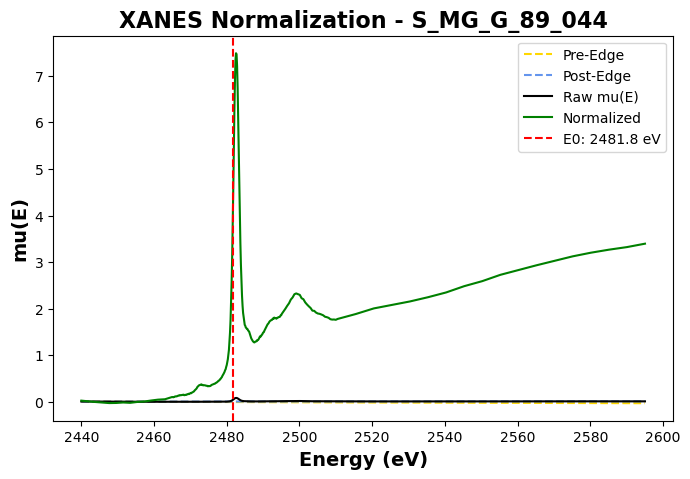

✅ Normalized S_MG_G_89_044 (E0 = 2481.8 eV)


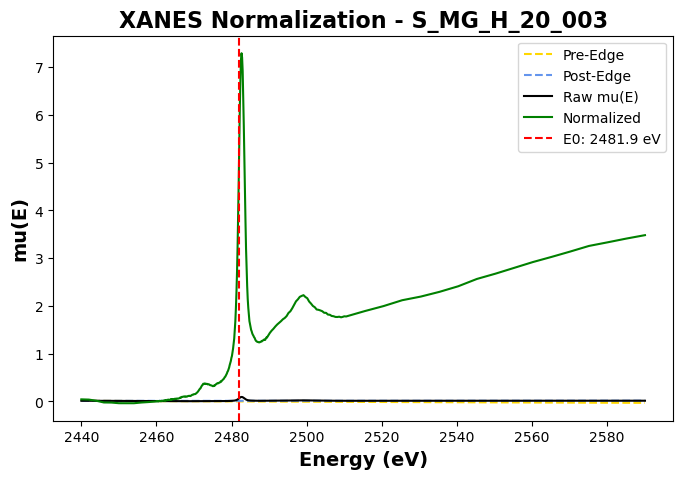

✅ Normalized S_MG_H_20_003 (E0 = 2481.9 eV)


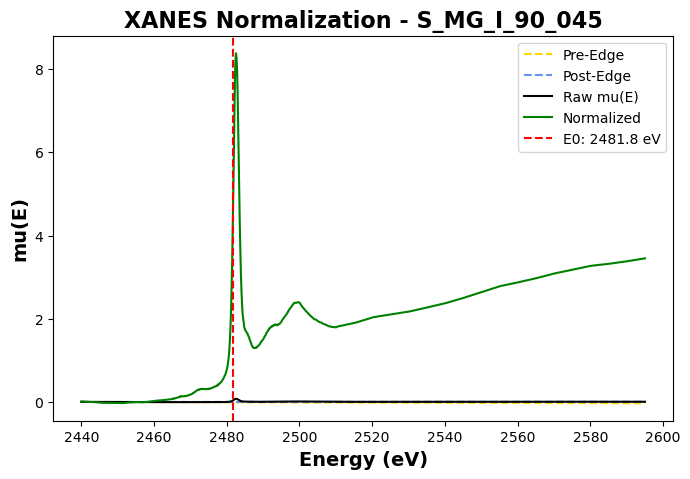

✅ Normalized S_MG_I_90_045 (E0 = 2481.8 eV)


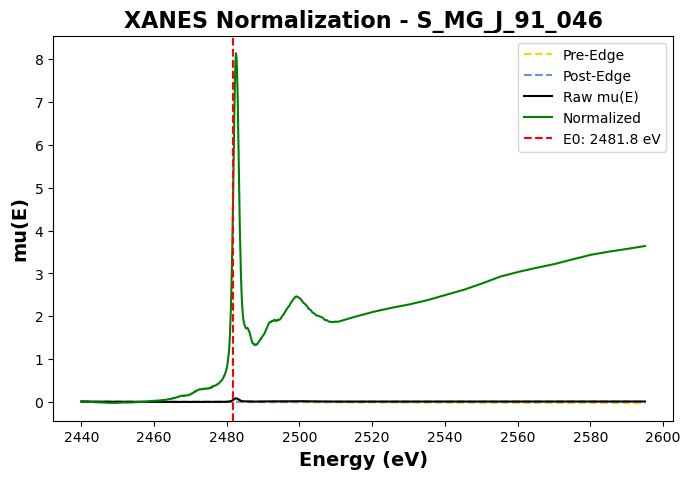

✅ Normalized S_MG_J_91_046 (E0 = 2481.8 eV)


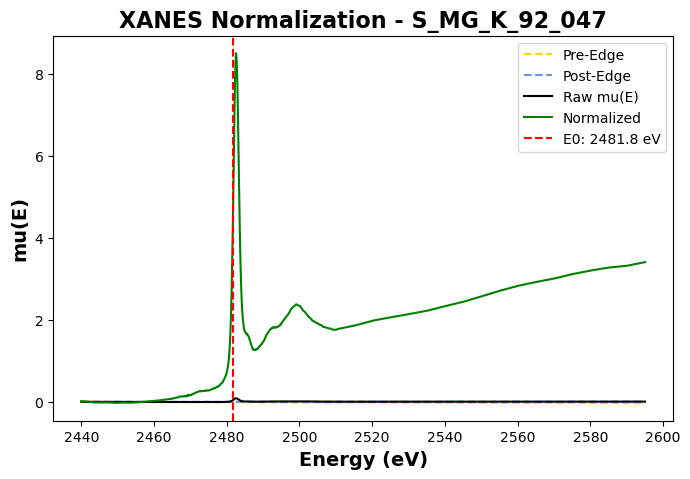

✅ Normalized S_MG_K_92_047 (E0 = 2481.8 eV)


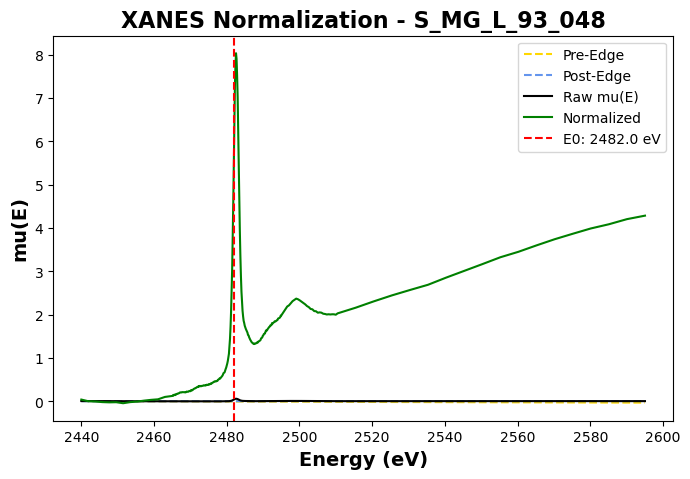

✅ Normalized S_MG_L_93_048 (E0 = 2482.0 eV)


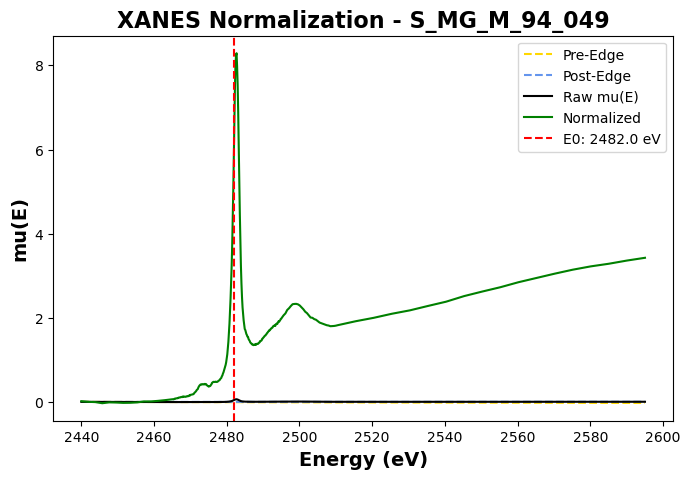

✅ Normalized S_MG_M_94_049 (E0 = 2482.0 eV)


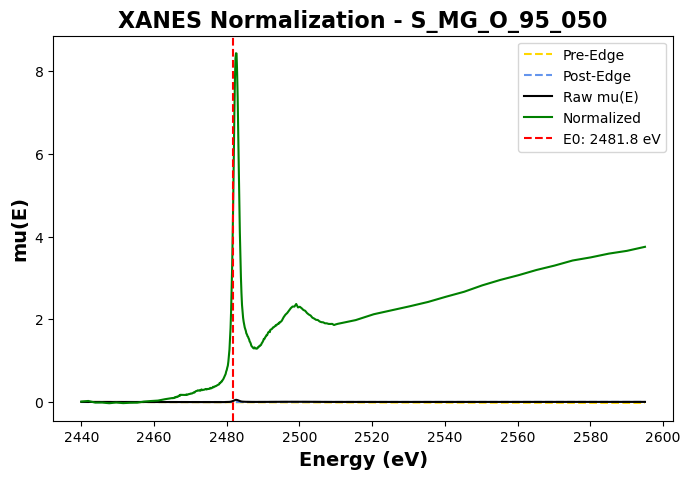

✅ Normalized S_MG_O_95_050 (E0 = 2481.8 eV)


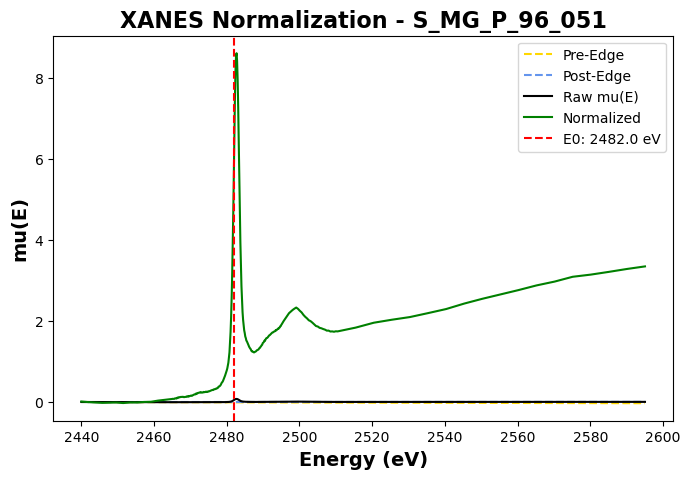

✅ Normalized S_MG_P_96_051 (E0 = 2482.0 eV)


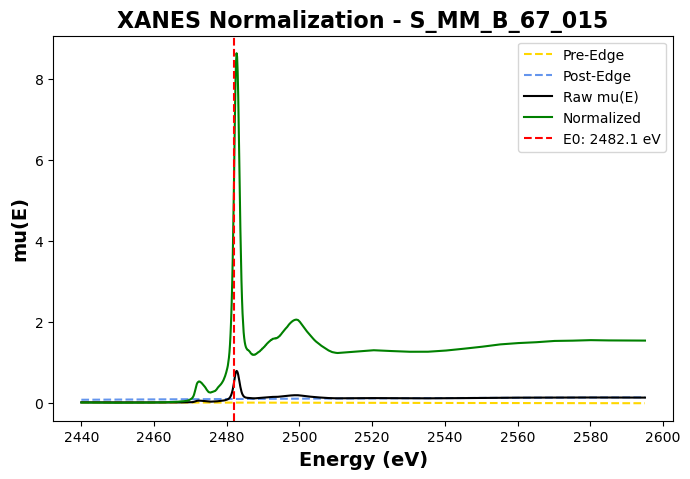

✅ Normalized S_MM_B_67_015 (E0 = 2482.1 eV)


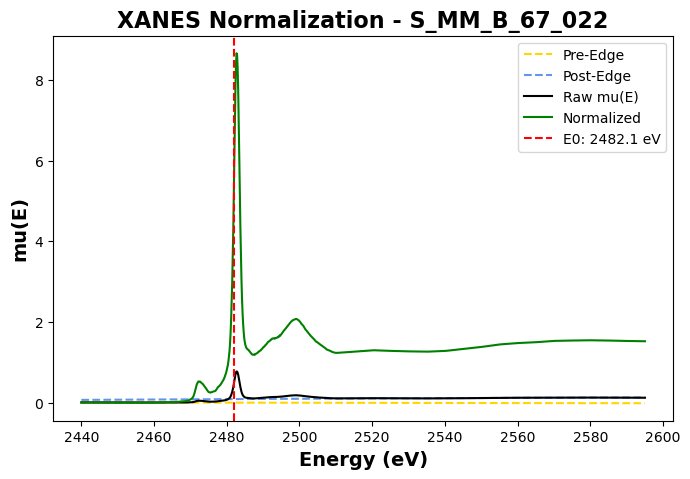

✅ Normalized S_MM_B_67_022 (E0 = 2482.1 eV)


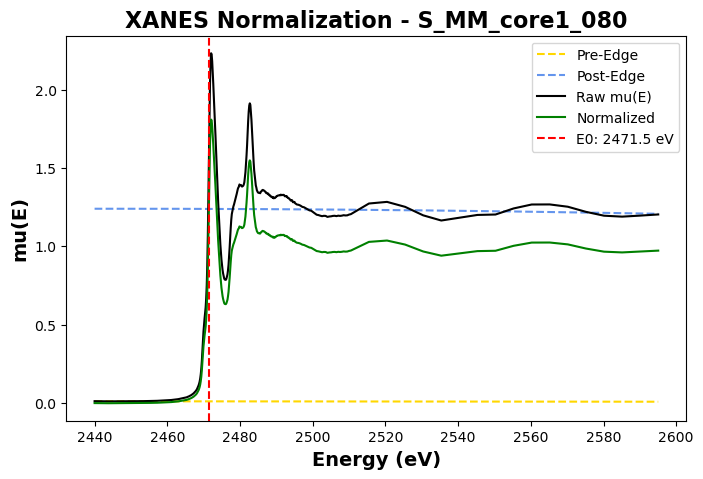

✅ Normalized S_MM_core1_080 (E0 = 2471.5 eV)


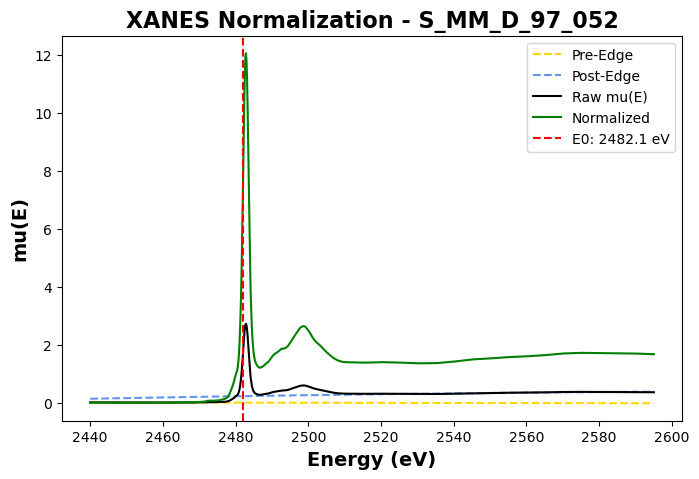

✅ Normalized S_MM_D_97_052 (E0 = 2482.1 eV)


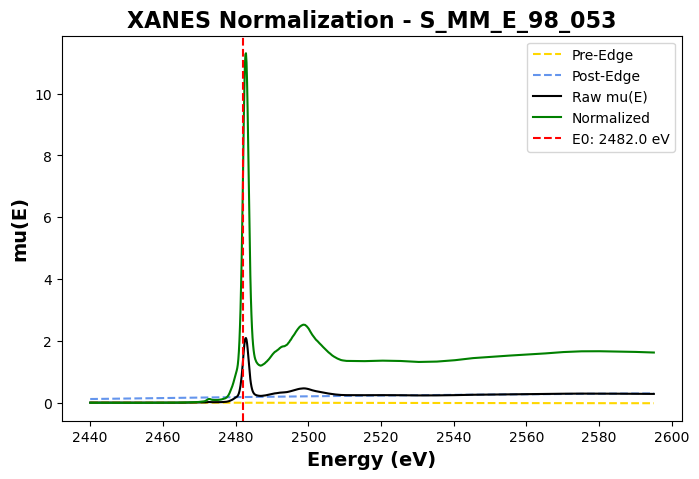

✅ Normalized S_MM_E_98_053 (E0 = 2482.0 eV)


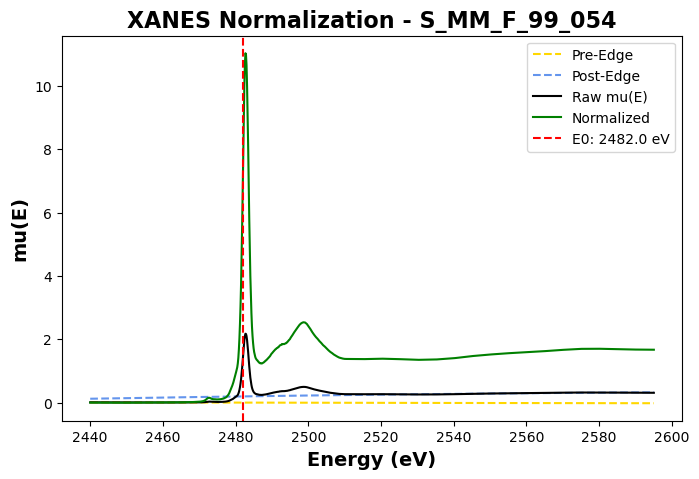

✅ Normalized S_MM_F_99_054 (E0 = 2482.0 eV)


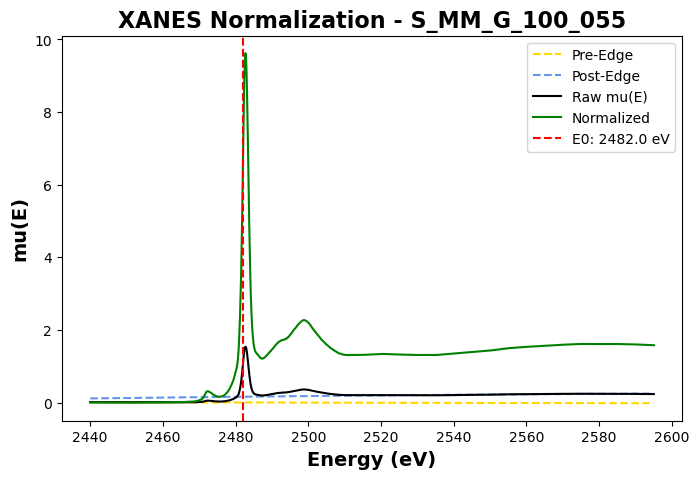

✅ Normalized S_MM_G_100_055 (E0 = 2482.0 eV)


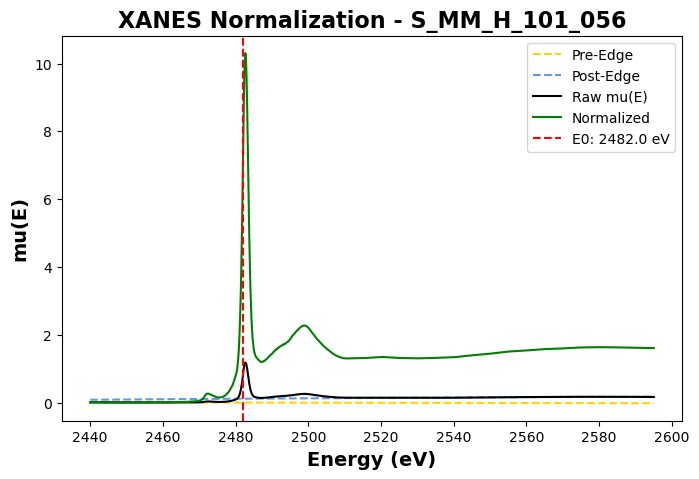

✅ Normalized S_MM_H_101_056 (E0 = 2482.0 eV)


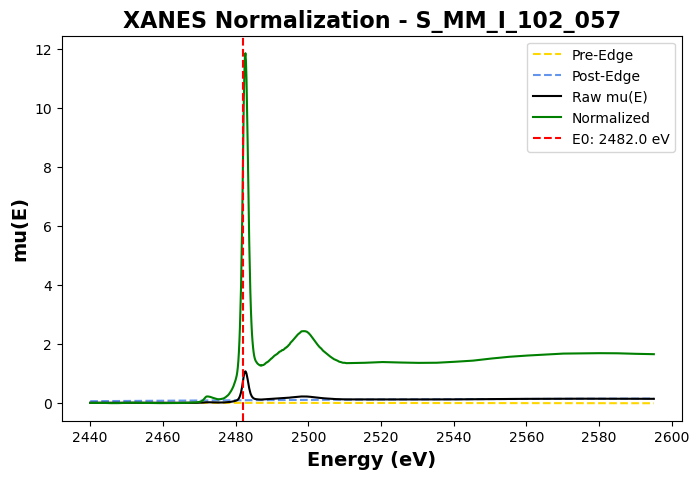

✅ Normalized S_MM_I_102_057 (E0 = 2482.0 eV)


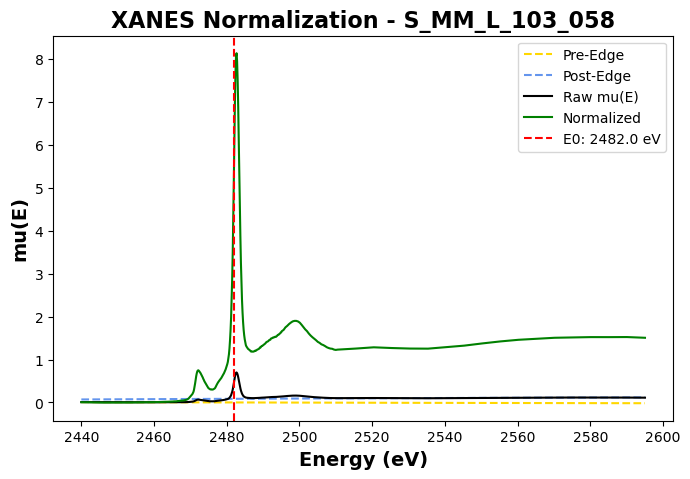

✅ Normalized S_MM_L_103_058 (E0 = 2482.0 eV)


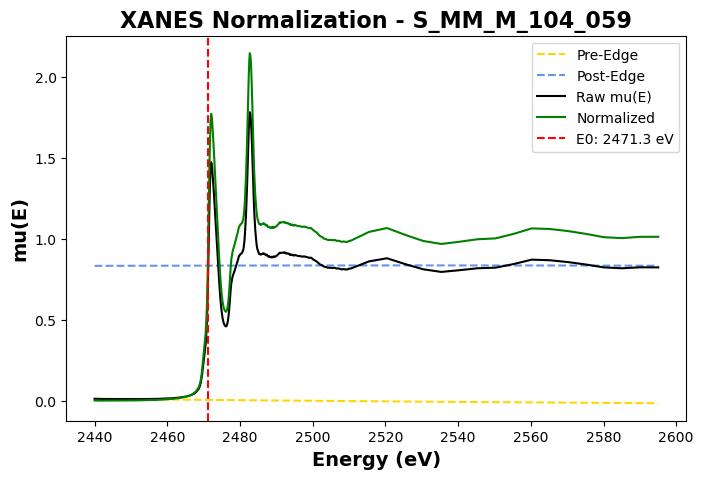

✅ Normalized S_MM_M_104_059 (E0 = 2471.3 eV)


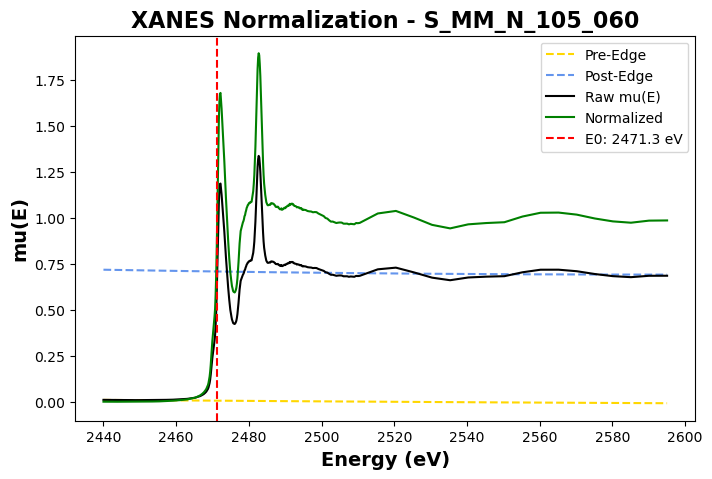

✅ Normalized S_MM_N_105_060 (E0 = 2471.3 eV)


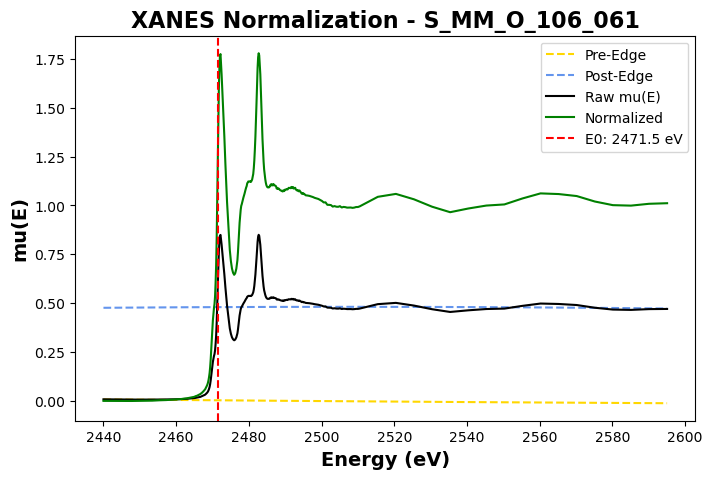

✅ Normalized S_MM_O_106_061 (E0 = 2471.5 eV)


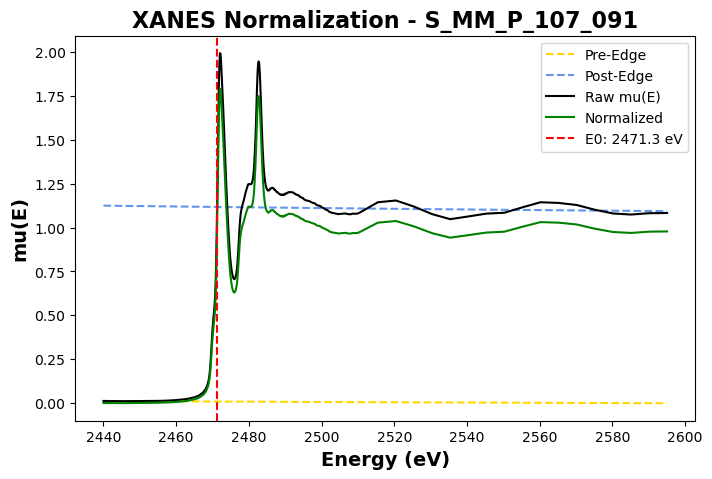

✅ Normalized S_MM_P_107_091 (E0 = 2471.3 eV)


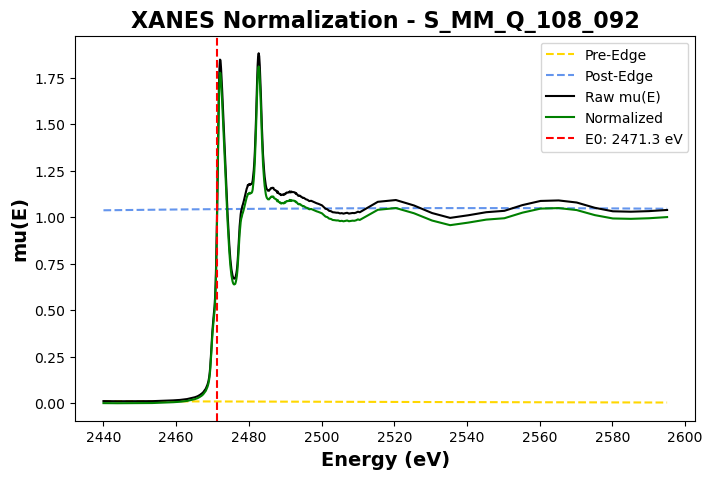

✅ Normalized S_MM_Q_108_092 (E0 = 2471.3 eV)


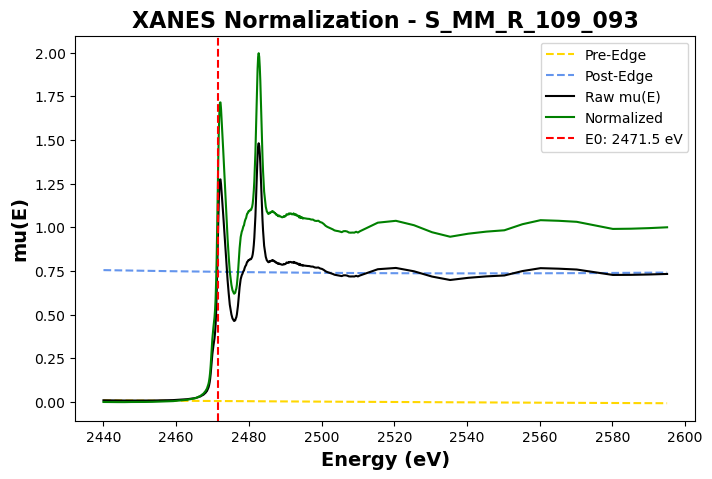

✅ Normalized S_MM_R_109_093 (E0 = 2471.5 eV)


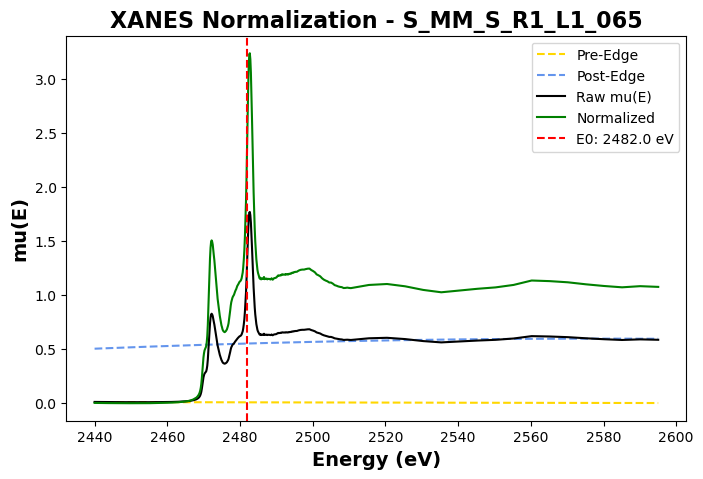

✅ Normalized S_MM_S_R1_L1_065 (E0 = 2482.0 eV)


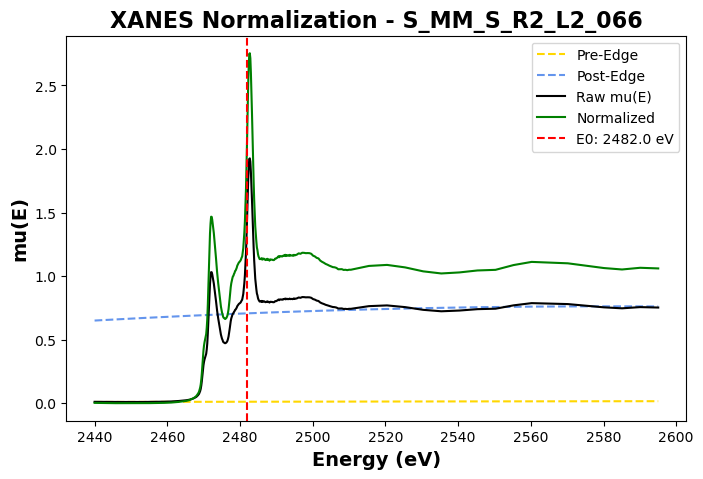

✅ Normalized S_MM_S_R2_L2_066 (E0 = 2482.0 eV)


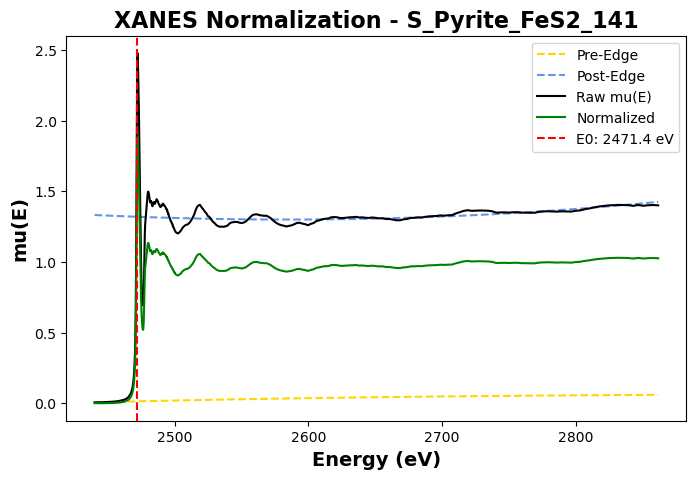

✅ Normalized S_Pyrite_FeS2_141 (E0 = 2471.4 eV)


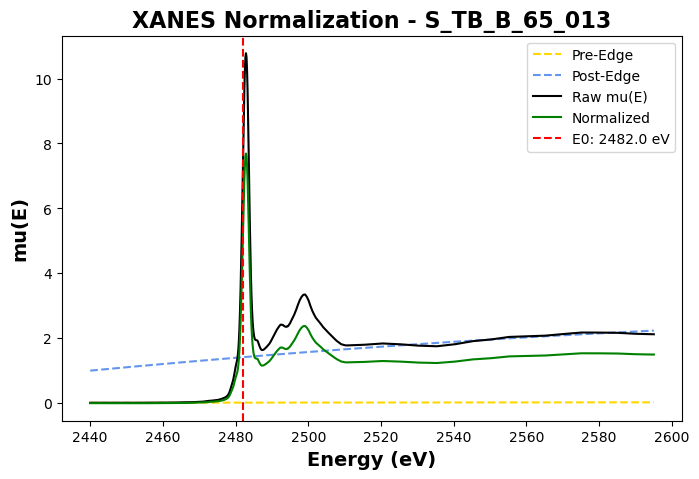

✅ Normalized S_TB_B_65_013 (E0 = 2482.0 eV)


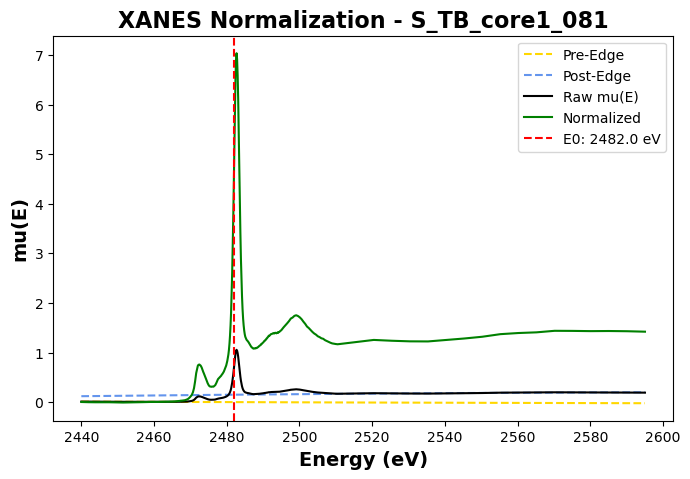

✅ Normalized S_TB_core1_081 (E0 = 2482.0 eV)


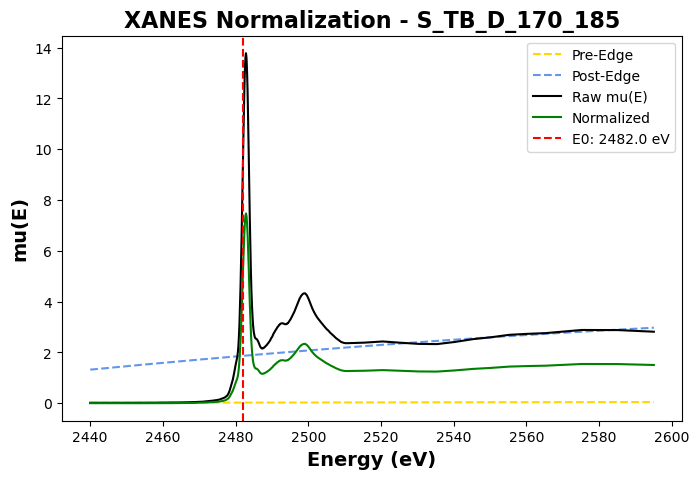

✅ Normalized S_TB_D_170_185 (E0 = 2482.0 eV)


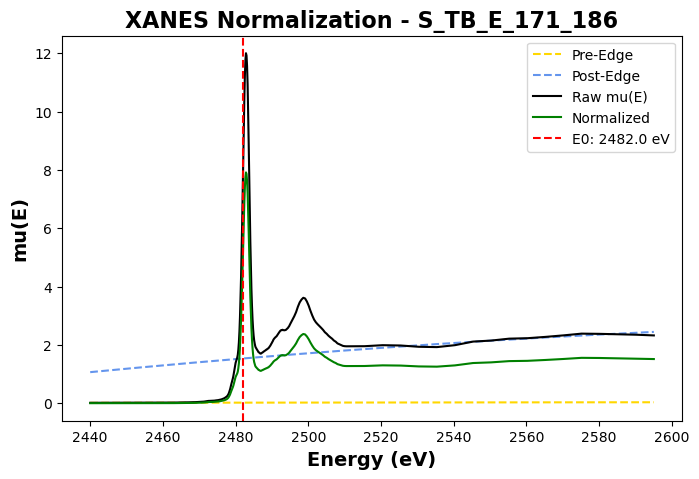

✅ Normalized S_TB_E_171_186 (E0 = 2482.0 eV)


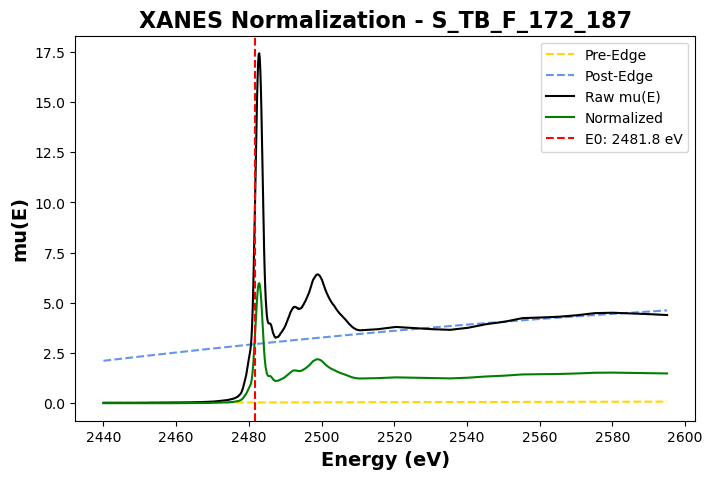

✅ Normalized S_TB_F_172_187 (E0 = 2481.8 eV)


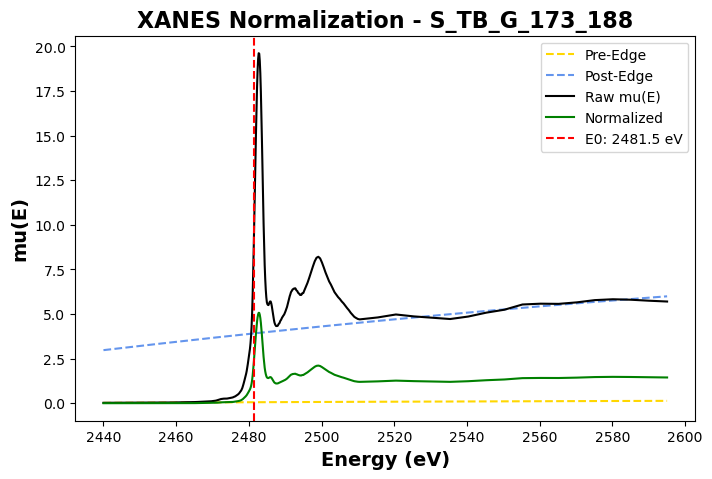

✅ Normalized S_TB_G_173_188 (E0 = 2481.5 eV)


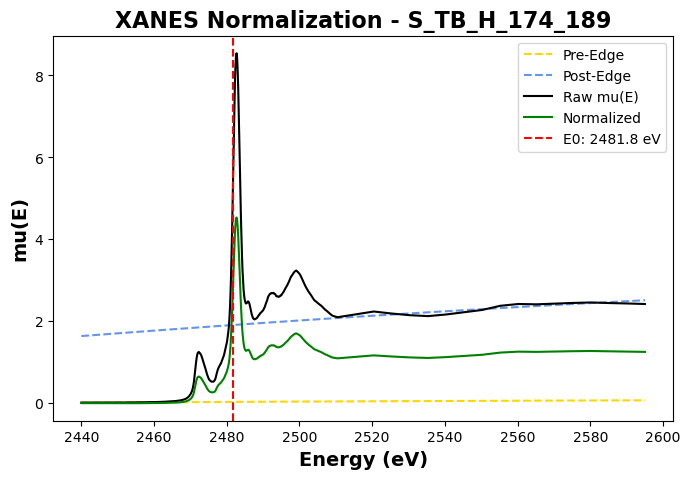

✅ Normalized S_TB_H_174_189 (E0 = 2481.8 eV)


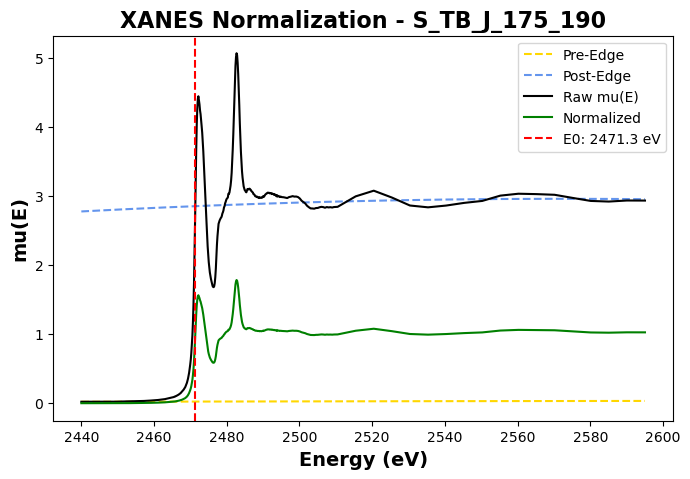

✅ Normalized S_TB_J_175_190 (E0 = 2471.3 eV)


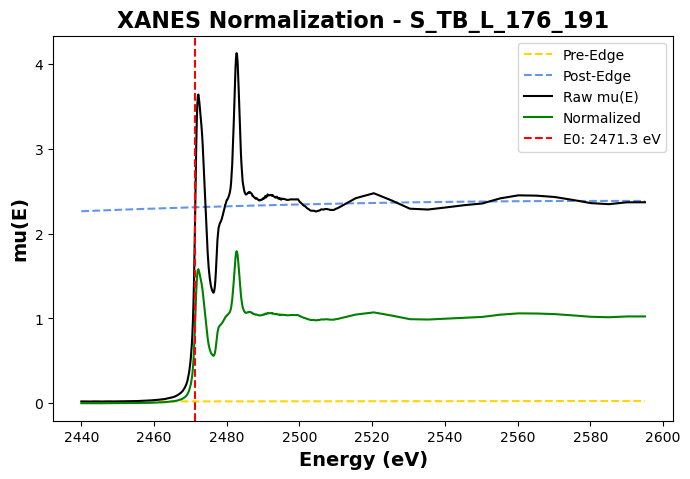

✅ Normalized S_TB_L_176_191 (E0 = 2471.3 eV)


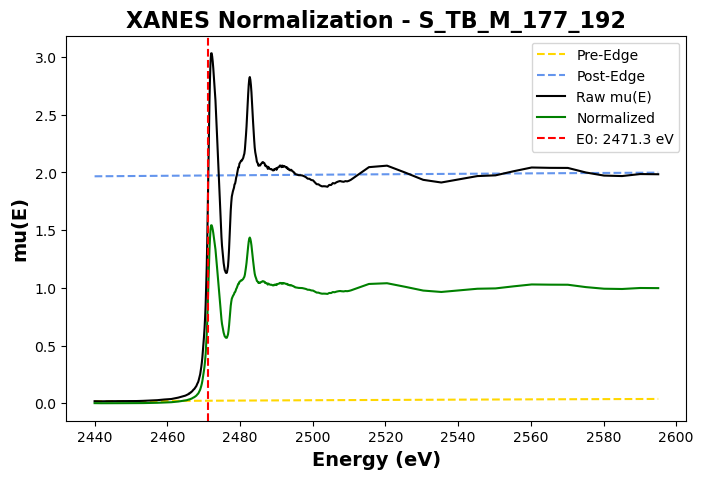

✅ Normalized S_TB_M_177_192 (E0 = 2471.3 eV)


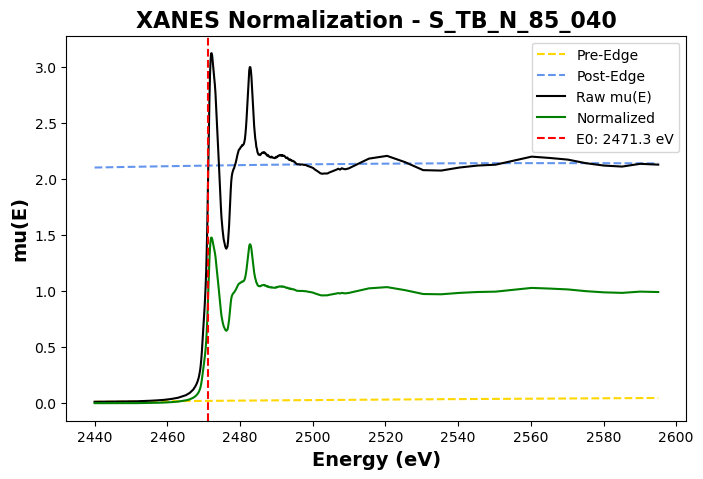

✅ Normalized S_TB_N_85_040 (E0 = 2471.3 eV)


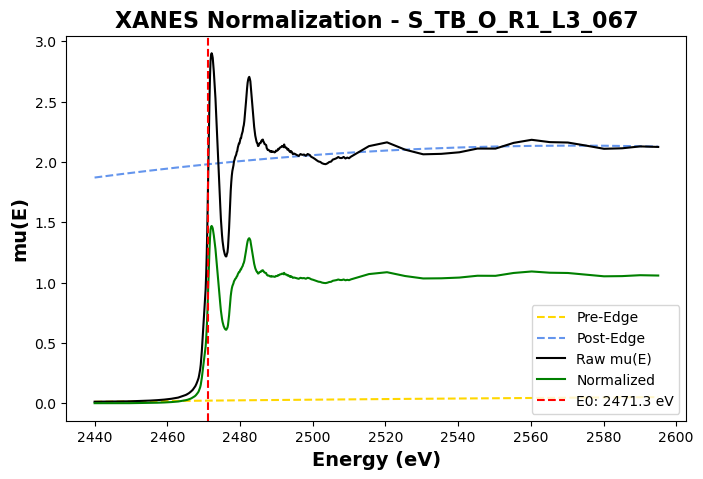

✅ Normalized S_TB_O_R1_L3_067 (E0 = 2471.3 eV)


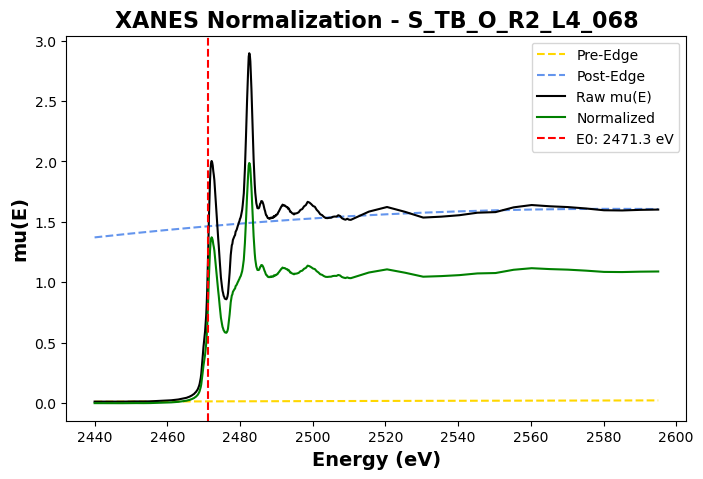

✅ Normalized S_TB_O_R2_L4_068 (E0 = 2471.3 eV)


In [222]:
# === 5️⃣ XANES NORMALIZATION & E0 FINDING ===
xanes_results = {}
for sample, df in averaged_data.items():
    energy = df['energy'].values
    mu = df['mu_avg'].values

    # Create a Larch Group and store data
    g = Group()
    g.energy = energy
    g.mu = mu

    # Apply pre-edge normalization (this modifies 'g' in place)
    pre_edge(g.energy, g.mu, group=g, # energy, intensity, and the group to treat
                    pre1 = -50, # the lower bond of the function to fit the pre-edge
                    pre2 = -20, # the upper bond of the function to fit the pre-edge
                    norm1 = 40, # the lower bond of the function to fit the post-edge
                    norm2= 1020, # the upper bond of the function to fit the post-edge
                    nnorm= 2, # degree for the polynomials
                    nvict= 4 # energy exponent to use for pre-edge fit.
                    )

    # Store results in DataFrame
    df_result = pd.DataFrame({
        'energy': g.energy,
        'mu': g.mu,
        'pre_edge': g.pre_edge,
        'post_edge': g.post_edge,
        'norm_mu': g.norm,
        'flat': g.flat,
    })

    # Plot XANES normalization
    plt.figure(figsize=(8, 5))
    plt.plot(g.energy, g.pre_edge, label='Pre-Edge', color='gold', linestyle='--')
    plt.plot(g.energy, g.post_edge, label='Post-Edge', color='cornflowerblue', linestyle='--')
    plt.plot(g.energy, g.mu, label='Raw mu(E)', color='black')
    plt.plot(g.energy, g.norm, label='Normalized', color='green')
    plt.axvline(g.e0, color='r', linestyle='--', label=f'E0: {g.e0:.1f} eV')
    plt.title(f'XANES Normalization - {sample}', fontsize=16, fontweight='bold')
    plt.xlabel('Energy (eV)', fontsize=14, fontweight='bold')
    plt.ylabel('mu(E)', fontsize=14, fontweight='bold')
    plt.legend()
    plt.show()

    # Store results
    xanes_results[sample] = {
        'df': df_result,
        'e0': g.e0
    }
    
    print(f"✅ Normalized {sample} (E0 = {g.e0:.1f} eV)")

#print(xanes_results)

# **EXAFS ANALYSIS (chi(k), FT(R-space))**

In [223]:
# === 6️⃣ EXAFS ANALYSIS (chi(k), chi(R)) ===
exafs_results = {}
for sample, result in xanes_results.items():
    df = result['df']

    # ✅ Ensure energy is sorted
    df = df.sort_values(by='energy').reset_index(drop=True)

    energy = df['energy'].values
    norm_mu = df['norm_mu'].values

    print(f"{sample}: is strictly increasing? {np.all(np.diff(energy) > 0)}")

    # Create a Larch Group and store data
    g = Group()
    g.energy = energy
    g.mu = norm_mu

    # Run EXAFS extraction with autobk (modifies 'g' in place)
    autobk(g, rbkg=1.0)

    # Fourier Transform to chi(R) (modifies 'g' in place)
    xftf(g, kmin=2, kmax=12)

    # Save results
    exafs_results[sample] = {
        'k': g.k,
        'chi_k': g.chi,
        'r': g.r,
        'chi_r': g.chir_mag
    }

    print(f"✅ EXAFS extracted for {sample}")

print("🎉 All samples processed!")

S_BC_B_69_017: is strictly increasing? True
✅ EXAFS extracted for S_BC_B_69_017
S_BC_D_116_103: is strictly increasing? True
✅ EXAFS extracted for S_BC_D_116_103
S_BC_E_117_104: is strictly increasing? True
✅ EXAFS extracted for S_BC_E_117_104
S_BC_G_118_105: is strictly increasing? True
✅ EXAFS extracted for S_BC_G_118_105
S_BC_H_119_106: is strictly increasing? True
✅ EXAFS extracted for S_BC_H_119_106
S_BC_J_120_107: is strictly increasing? True
✅ EXAFS extracted for S_BC_J_120_107
S_BC_K_121_108: is strictly increasing? True
✅ EXAFS extracted for S_BC_K_121_108
S_BC_L_122_109: is strictly increasing? True
✅ EXAFS extracted for S_BC_L_122_109
S_BC_M_123_110: is strictly increasing? True
✅ EXAFS extracted for S_BC_M_123_110
S_BC_O_124_111: is strictly increasing? True
✅ EXAFS extracted for S_BC_O_124_111
S_BC_test_core_078: is strictly increasing? True
✅ EXAFS extracted for S_BC_test_core_078
S_BK_A_63_009: is strictly increasing? True
✅ EXAFS extracted for S_BK_A_63_009
S_BK_B_73_03

# ***Defining mine tailings information***

In [224]:
# Defining mine site full names
mine_sites = [
    "Barker, MT", "Black Butte, OR", "Bonnie Claire, NV", "Charcoal Canyon, AZ",
    "Crystal, MT", "Formosa, OR", "Gold Point, NV", "Iron King, AZ",
    "Iron Mountain, CA", "Keating, MT", "Mammoth, MT", "Marigold, CA", "Tybo, NV"
]

# Defining its abbreviations
mine_abbreviations = ["BK", "BB", "BC", "CC", "CT", "FM", "GP", "IK", "IM", "KT", "MM", "MG", "TB"]

# Defining standard colors for each site
mine_colors = [
    "#FB9A99", "#7f7f7f", "#00CED1", "#9467bd", "#e377c2",
    "#FF1493", "#FF7F00", "#00FF00", "brown", "#ffcc33",
    "#0000FF", "#87CEEB", "#008B00"
]

# Mapping from full name to color
mine_color_mapping = dict(zip(mine_sites, mine_colors))

# Mapping abbreviation to color if needed
mine_abbrev_color_mapping = dict(zip(mine_abbreviations, mine_colors))




# **Sorting and plotting**
Reading samples from different sites, identifyng the ones from the same site, grouping them the same plot to plot them stacked.

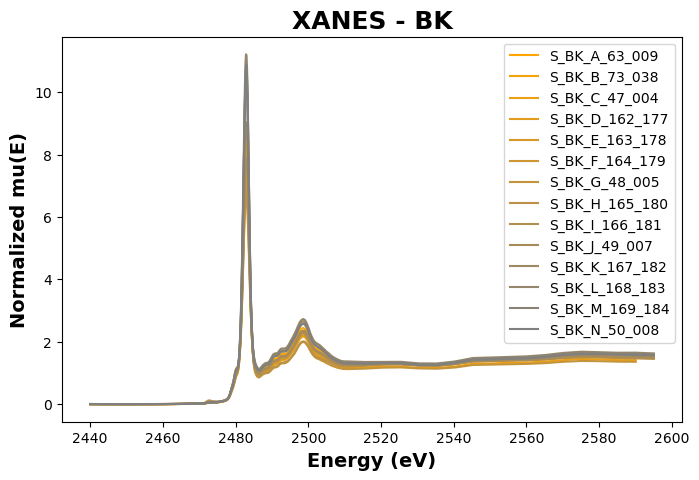

⚠️ No samples found for BB


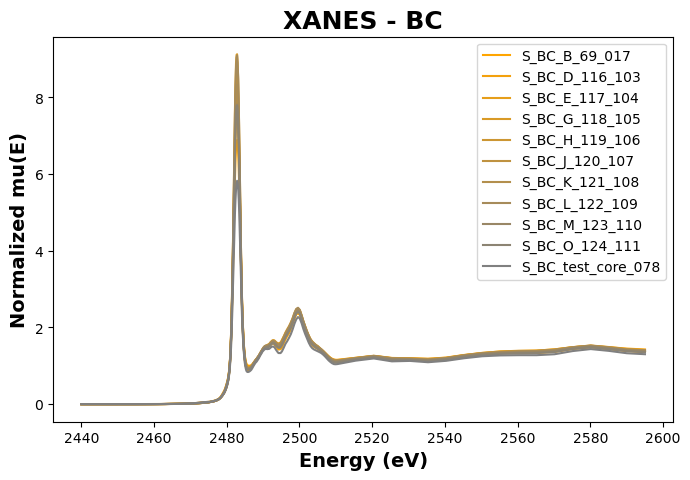

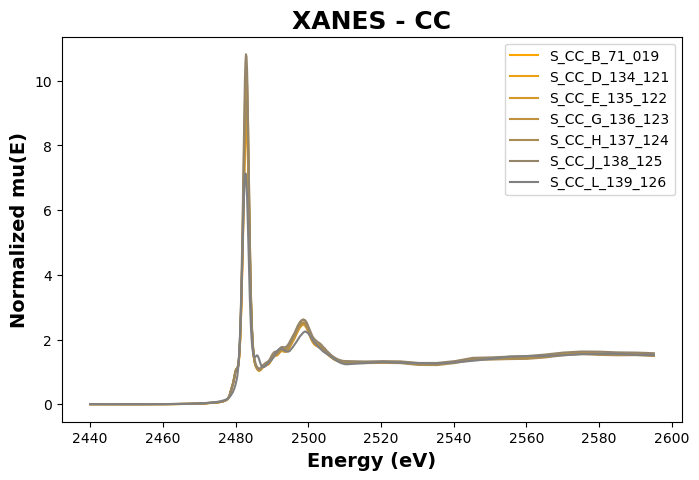

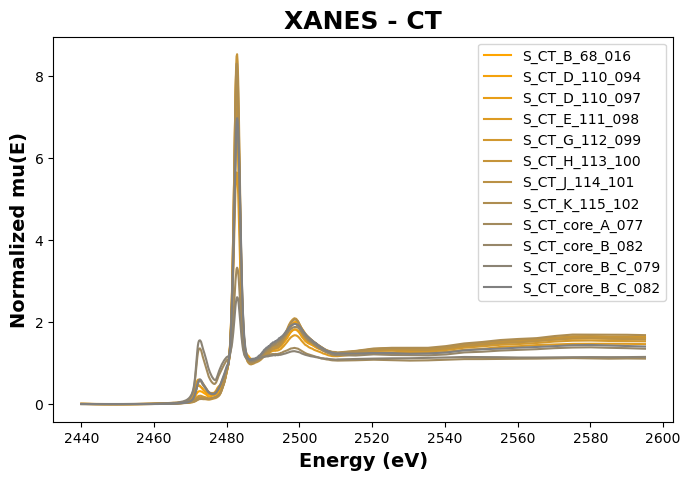

⚠️ No samples found for FM


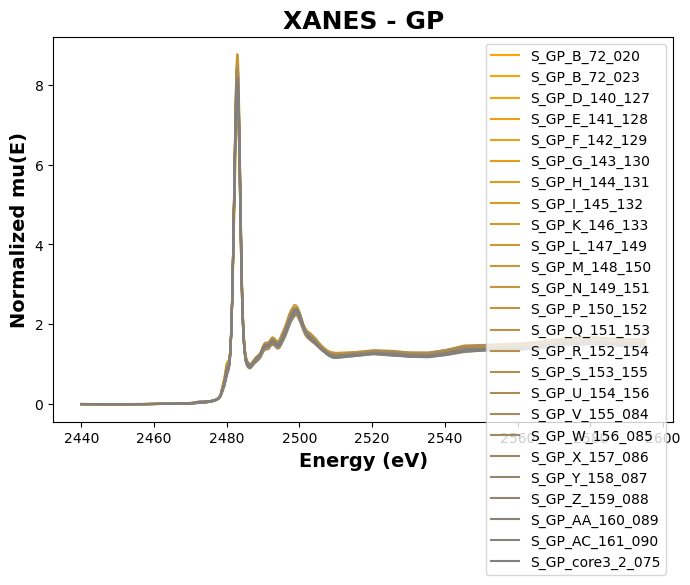

⚠️ No samples found for IK
⚠️ No samples found for IM


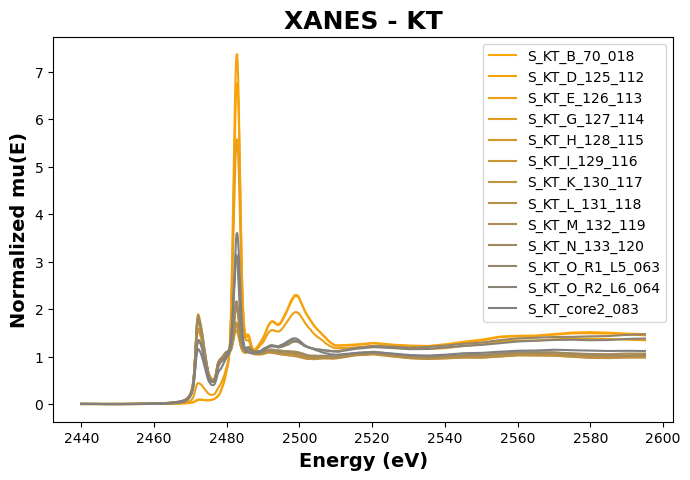

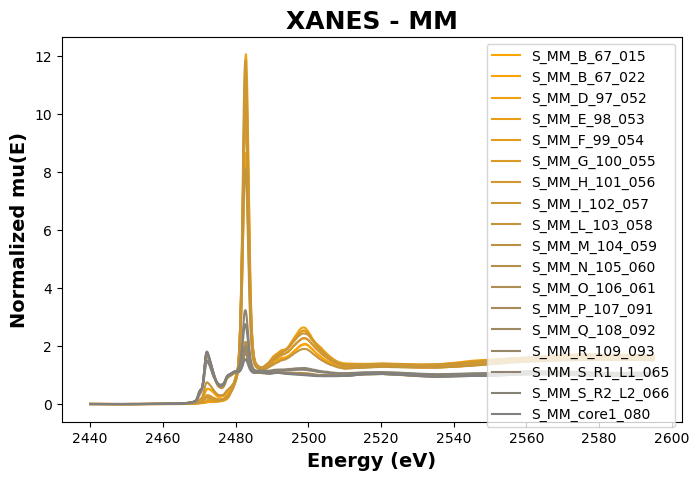

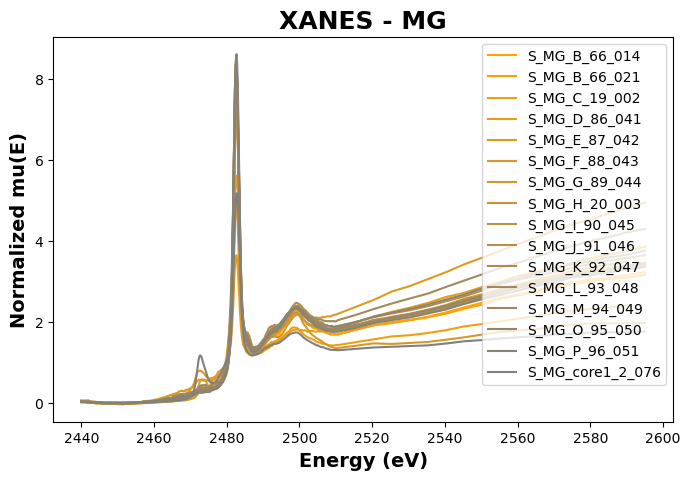

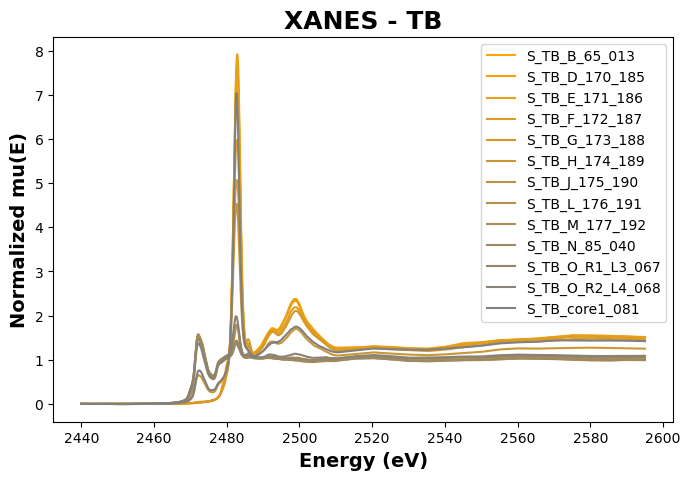

In [225]:
import re

# List of sample names
sample_names = list(xanes_results.keys()) 

# Extracting the mine abbreviation from the sample name (e.g., 'S_BC_A_001_001')
def extract_abbreviation(sample_name):
    match = re.search(r'_([A-Z]{2})_', sample_name)
    return match.group(1) if match else None

# Looping over mines and plotting all samples from the same mine together
for mine_abbrev, color in mine_abbrev_color_mapping.items():
    # Getting sample names that belong to this mine site
    mine_samples = [s for s in sample_names if extract_abbreviation(s) == mine_abbrev]

#Custom sort order that:
    #✅ Sorts samples alphabetically by their full names;
    #✅ But any samples starting with AA, AB, AC come after Z;
    #✅ And samples that include "core" also come after everything else.

    def custom_sort_key(sample_name):
        name_upper = sample_name.upper()

        # Checking if 'core' is in the name (like core, core1, core2, coreX...)
        if any(part.startswith('CORE') for part in name_upper.split('_')):
            category = 2
        # Detecting if AA / AB / AC after the mine abbrev
        elif any(part in ('AA', 'AB', 'AC') for part in name_upper.split('_')):
            category = 1
        else:
            category = 0  # normal sample
        
        return (category, name_upper)

    # ✅ Applying custom sort
    mine_samples = sorted(mine_samples, key=custom_sort_key)
    
    # Creating a custom colormap from orange to grey
    colors = ["orange", "grey"]
    cmap = LinearSegmentedColormap.from_list("orange_grey", colors)

    # Generating N colors (N = number of samples)
    n_samples = len(mine_samples)
    color_list = [cmap(i / (n_samples - 1)) for i in range(n_samples)]
    
    # Assigning colors based on sorted order
    sample_color_map = {sample: color_list[idx] for idx, sample in enumerate(mine_samples)}

    
    if not mine_samples:
        print(f"⚠️ No samples found for {mine_abbrev}")
        continue

    # Plotting XANES
    plt.figure(figsize=(8, 5))
    for sample in mine_samples:
        df = xanes_results[sample]['df']
        plt.plot(df['energy'], df['norm_mu'], label=sample, color=sample_color_map[sample])
    plt.title(f"XANES - {mine_abbrev}", fontsize=18, fontweight='bold')
    plt.xlabel('Energy (eV)', fontsize=14, fontweight='bold')
    plt.ylabel('Normalized mu(E)', fontsize=14, fontweight='bold')
    plt.legend()
    plt.show()



# **Alphabetical order**
Function to sort the samples on the correct horizon order

In [226]:
#Custom sort order that:
#✅ Sorts samples alphabetically by their full names;
#✅ But any samples starting with AA, AB, AC come after Z;
#✅ And samples that include "core" also come after everything else.

def custom_sort_key(sample_name):
    name_upper = sample_name.upper()

    # Detect if it's a 'core' sample
    if 'CORE' in name_upper:
        category = 2
    # Detect if AA / AB / AC after the mine abbrev (split by '_')
    else:
        # Split by underscore to find the part after the mine abbrev
        parts = name_upper.split('_')
        # Safe: look for AA/AB/AC in any part
        found_special = any(p in ('AA', 'AB', 'AC') for p in parts)
        
        if found_special:
            category = 1
        else:
            category = 0  # normal sample
    
    return (category, name_upper)


# Example usage:
mine_samples_sorted = sorted(mine_samples, key=custom_sort_key)
print(mine_samples_sorted)

['S_TB_B_65_013', 'S_TB_D_170_185', 'S_TB_E_171_186', 'S_TB_F_172_187', 'S_TB_G_173_188', 'S_TB_H_174_189', 'S_TB_J_175_190', 'S_TB_L_176_191', 'S_TB_M_177_192', 'S_TB_N_85_040', 'S_TB_O_R1_L3_067', 'S_TB_O_R2_L4_068', 'S_TB_core1_081']


# Compute second derivative of pre-edge

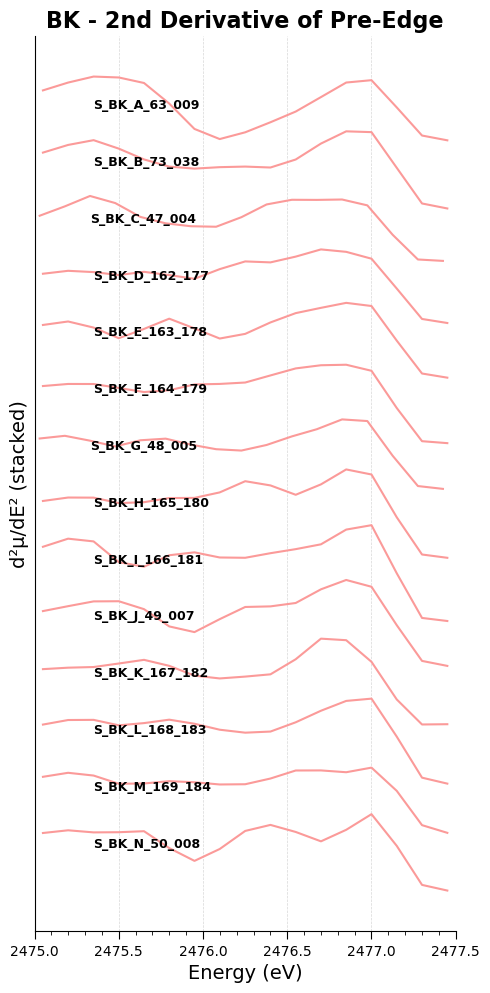

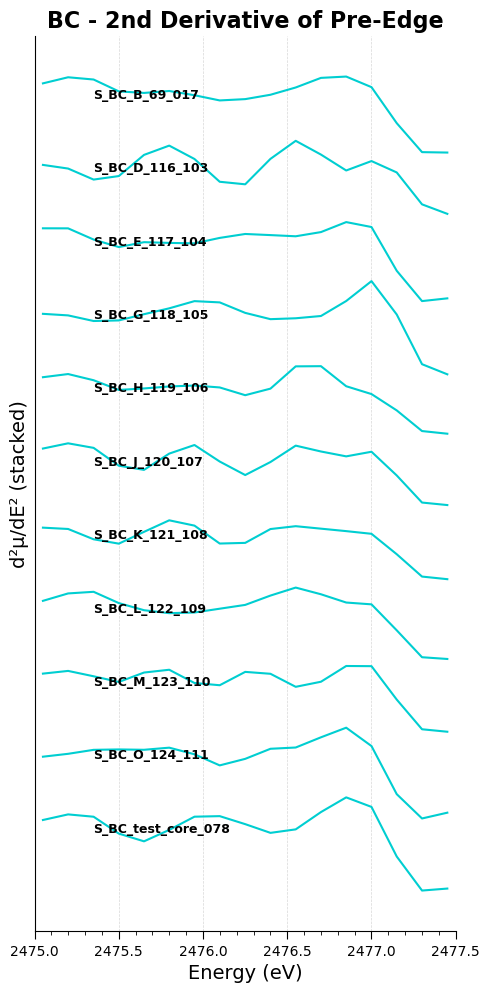

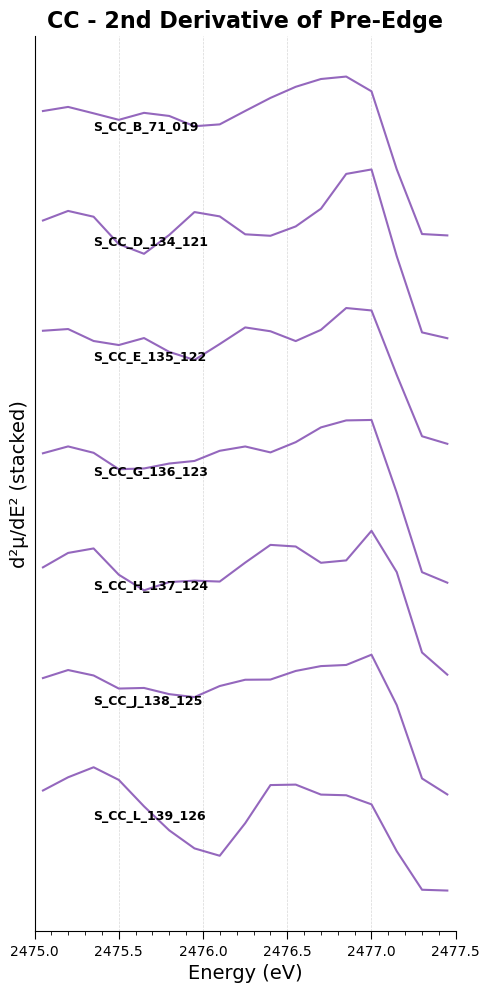

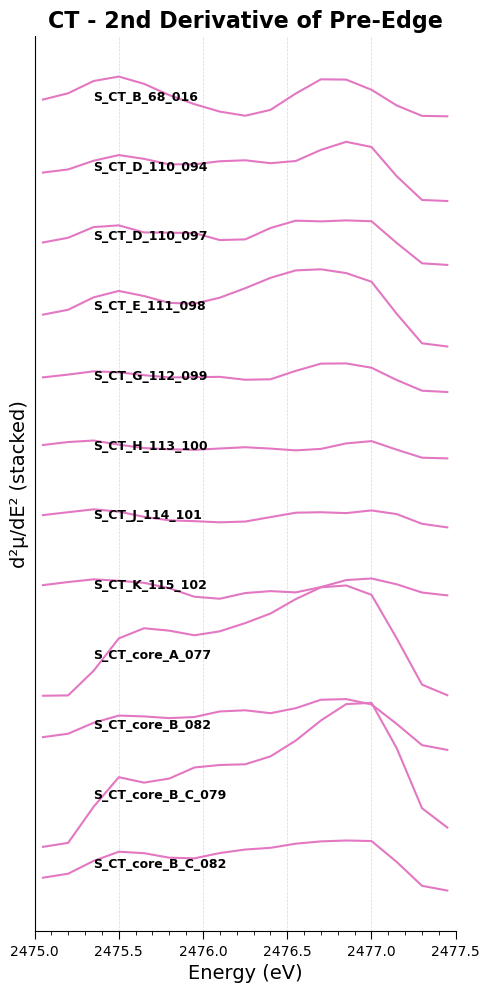

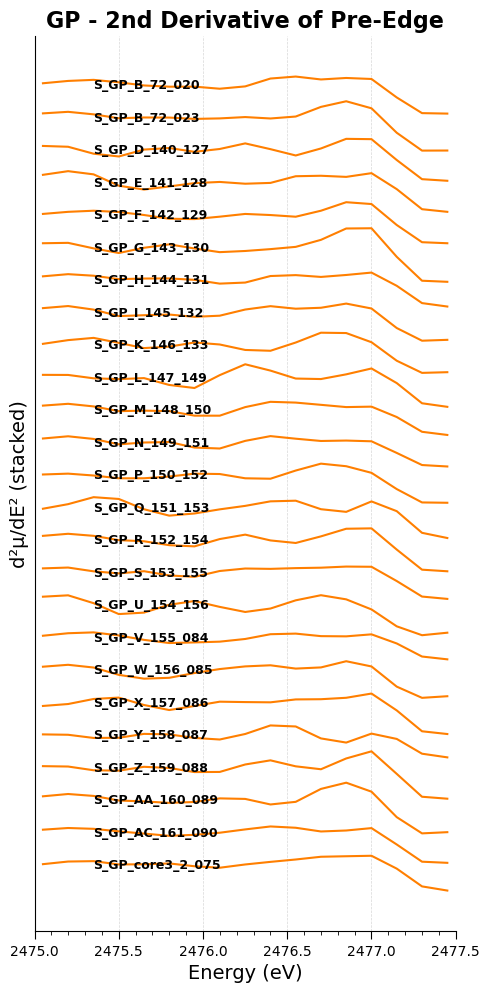

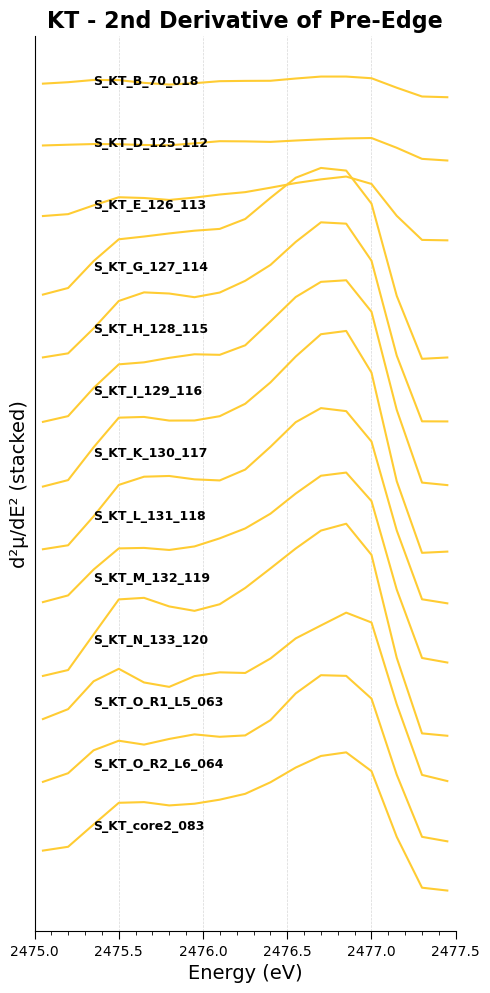

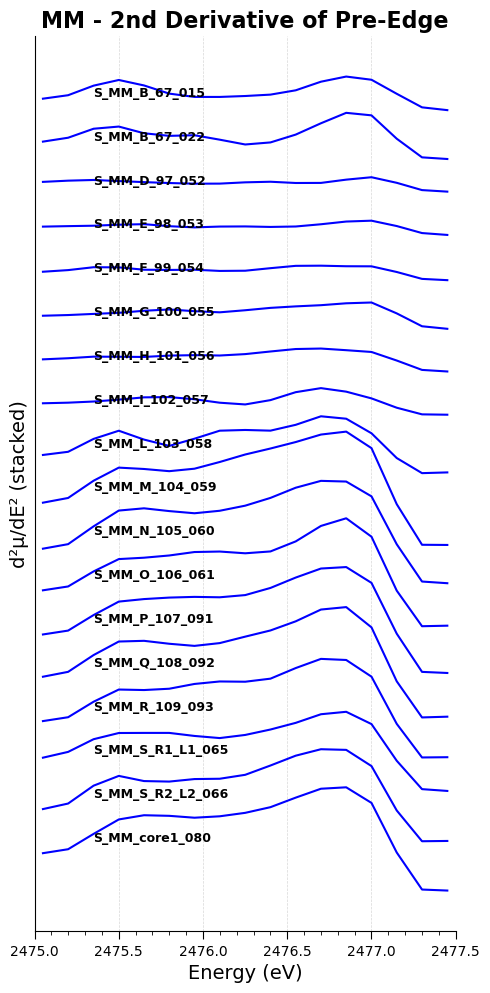

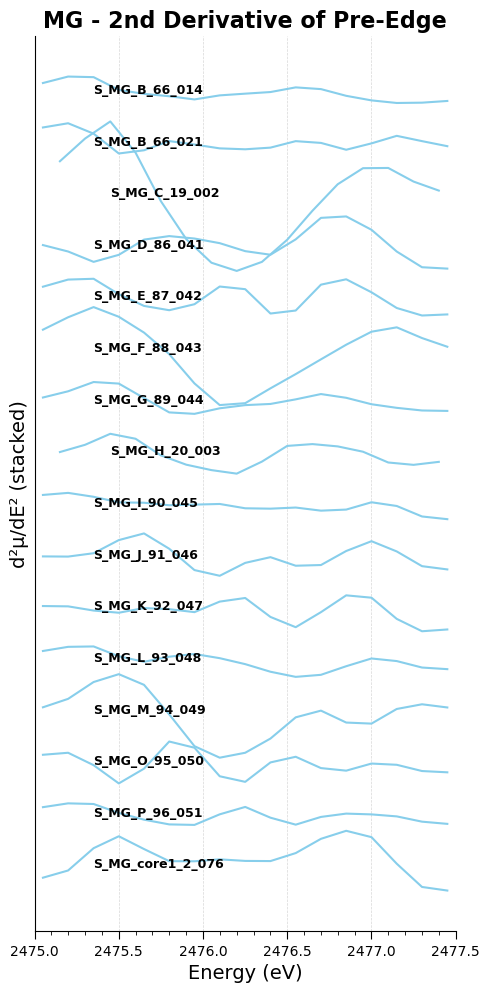

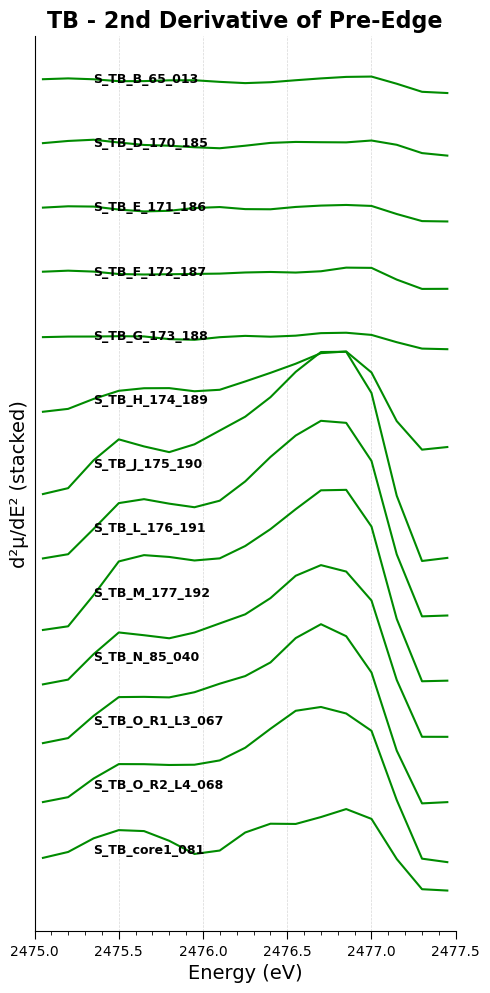

In [227]:
from scipy.ndimage import gaussian_filter1d

# Pre-edge range for derivative
pre_edge_min = 2475
pre_edge_max = 2477.5

# Offset for stacked plot
# Mines that need larger vertical spacing between curves
wide_offset_mines = ['TB', 'MG', 'MM', 'KT', 'CT']
offset_big = 0.3
offset_small = 0.06



for mine_abbrev in mine_abbreviations:
    # Get all samples for this mine
    mine_samples = [sample for sample in xanes_results.keys() if mine_abbrev in sample]
    mine_samples = sorted(mine_samples, key=custom_sort_key)

    if not mine_samples:
        continue

    color = mine_abbrev_color_mapping[mine_abbrev]
    
    # Use larger offset only for specific mines
    offset_step = offset_big if mine_abbrev in wide_offset_mines else offset_small

    plt.figure(figsize=(5, 10))  # wider for better x resolution

    for idx, sample in enumerate(mine_samples):
        df = xanes_results[sample]['df']
        energy = df['energy'].values
        norm_mu = df['norm_mu'].values

        # Apply pre-edge mask
        mask = (energy >= pre_edge_min) & (energy <= pre_edge_max)
        energy_pre = energy[mask]
        mu_pre = norm_mu[mask]

        # Smooth and compute second derivative
        mu_smooth = gaussian_filter1d(mu_pre, sigma=1.0)
        d1 = np.gradient(mu_smooth, energy_pre)
        d2 = np.gradient(d1, energy_pre)

        # Apply vertical offset for stacking
        offset = idx * offset_step
        plt.plot(energy_pre, d2 - offset, label=sample, color=color, lw=1.5)

        # Label each curve
        plt.text(energy_pre.min() + 0.3, -offset + 0.005, sample,
                 color='black', fontsize=9, fontweight='bold')

    # Styling
    plt.title(f"{mine_abbrev} - 2nd Derivative of Pre-Edge", fontsize=16, fontweight='bold')
    plt.xlabel("Energy (eV)", fontsize=14)
    plt.ylabel("d²μ/dE² (stacked)", fontsize=14)
    plt.xlim(pre_edge_min, pre_edge_max)
    #plt.xticks(np.arange(pre_edge_min, pre_edge_max + 0.1, 0.1))  # tick positions
    #plt.tick_params(axis='x', which='both', bottom=True, top=False, labelbottom=False)  # hide numbers  # ticks every 0.1 eV
    plt.yticks([])  # Hide y-axis ticks for stacked view
    plt.grid(True, linestyle='--', linewidth=0.5, alpha=0.5)
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.tight_layout()

    ax = plt.gca()  # get current axis object

    # X-axis ticks every 0.1 (minor) and labels every 0.5 (major)
    ax.set_xlim(pre_edge_min, pre_edge_max)
    ax.set_xticks(np.arange(pre_edge_min, pre_edge_max + 0.1, 0.1), minor=True)  # minor ticks
    ax.set_xticks(np.arange(pre_edge_min, pre_edge_max + 0.5, 0.5))  # major ticks with labels

    # Keep tick marks, but label only the major ones
    ax.tick_params(axis='x', which='major', bottom=True, labelbottom=True, length=6)
    ax.tick_params(axis='x', which='minor', bottom=True, labelbottom=False, length=3)

    # Disable vertical grid lines, enable horizontal grid lines
    ax.grid(axis='y', linestyle='--', linewidth=0.5, alpha=0.5)


    # Save plot
    #plt.savefig(f"{save_folder}\\{mine_abbrev}_S_preedge_2nd_deriv.png", dpi=300, bbox_inches='tight')
    plt.show()



# **Plotting XANES**

In [228]:
#Adding E0 values for sulfates, sulfides and pyrite, to plot as reference vertical lines

# Import pandas to work with dataframes
import pandas as pd

# Create the sulfur K-edge table as a pandas DataFrame
sulfur_edges_table = pd.DataFrame({
    "Mineral": [
        "Anglesite", "Chalcopyrite", "Coquimbite", "Galena", "Gypsum", "Jarosite",
        "Marcasite", "Melanterite", "Natrojarosite", "Pyrite", "Pyrrhotite-4C", "Sphalerite"
    ],
    "Sulfur_K_edge_eV": [
        2481.8, 2472.0, 2482.6, 2472.7, 2482.5, 2482.8,
        2472.0, 2482.2, 2482.7, 2472.1, 2470.2, 2473.8
    ],
    "Reference": [
        "https://www.esrf.fr/files/live/sites/www/files/UsersAndScience/Experiments/XNP/ID21/php/anglesite/anglesite.pdf",
        "https://xasdb.lightsource.ca/",
        "https://www.esrf.fr/files/live/sites/www/files/UsersAndScience/Experiments/XNP/ID21/php/coquimbite/coquimbite.pdf",
        "https://www.esrf.fr/files/live/sites/www/files/UsersAndScience/Experiments/XNP/ID21/php/galena/galena.pdf",
        "https://www.esrf.fr/files/live/sites/www/files/UsersAndScience/Experiments/XNP/ID21/php/gypsum/gypsum.pdf",
        "https://www.esrf.fr/files/live/sites/www/files/UsersAndScience/Experiments/XNP/ID21/php/jarosite/jarosite.pdf",
        "https://www.esrf.fr/files/live/sites/www/files/UsersAndScience/Experiments/XNP/ID21/php/marcassite/marcassite.pdf",
        "https://www.esrf.fr/files/live/sites/www/files/UsersAndScience/Experiments/XNP/ID21/php/melanterite/melanterite.pdf",
        "https://www.esrf.fr/files/live/sites/www/files/UsersAndScience/Experiments/XNP/ID21/php/natrojarosite/natrojarosite.pdf",
        "https://www.esrf.fr/files/live/sites/www/files/UsersAndScience/Experiments/XNP/ID21/php/pyrite/pyrite.pdf",
        "https://www.esrf.fr/files/live/sites/www/files/UsersAndScience/Experiments/XNP/ID21/php/pyrrhotite-4C/pyrrhotite4C.pdf",
        "https://www.esrf.fr/files/live/sites/www/files/UsersAndScience/Experiments/XNP/ID21/php/sphalerite/sphalerite.pdf"
    ]
})

#Eliminate desired minerals from table
sulfur_edges_table = sulfur_edges_table[sulfur_edges_table["Mineral"] != "Marcasite"]

# Display the table
sulfur_edges_table





,Mineral,Sulfur_K_edge_eV,Reference
0,Anglesite,2481.8,https://www.esrf.fr/files/live/sites/www/files...
1,Chalcopyrite,2472.0,https://xasdb.lightsource.ca/
2,Coquimbite,2482.6,https://www.esrf.fr/files/live/sites/www/files...
3,Galena,2472.7,https://www.esrf.fr/files/live/sites/www/files...
4,Gypsum,2482.5,https://www.esrf.fr/files/live/sites/www/files...
5,Jarosite,2482.8,https://www.esrf.fr/files/live/sites/www/files...
7,Melanterite,2482.2,https://www.esrf.fr/files/live/sites/www/files...
8,Natrojarosite,2482.7,https://www.esrf.fr/files/live/sites/www/files...
9,Pyrite,2472.1,https://www.esrf.fr/files/live/sites/www/files...
10,Pyrrhotite-4C,2470.2,https://www.esrf.fr/files/live/sites/www/files...


In [229]:

# Define a custom color mapping for selected minerals (you can expand it)
color_map = {
    "Gypsum": "#CCCC00",           # approximation of "yellow3"
    "Pyrite": "#CAB2D6",           # already valid hex
    "Chalcopyrite": "#FFD700",     # "gold" instead of "gold1"
    "Sphalerite": "darkturquoise", # standard name
    "Jarosite": "deeppink",        # closest valid to "deeppink1"
    "Natrojarosite": "blue",     # valid
    "Anglesite": "lightcoral",     # valid
    "Galena": "darkolivegreen",    # valid (no "darkolivegreen4" in Python)
    "Coquimbite": "orchid",        # closest to "orchid3"
    "Melanterite": "orange",       # valid
    "Marcasite": "#FB9A99",        # valid hex from your R palette
    "Pyrrhotite-4C": "gray"        # closest to "gray40"
}



# Generate the vertical_lines list
vertical_lines = []

for _, row in sulfur_edges_table.iterrows():
    mineral = row["Mineral"]
    e0 = row["Sulfur_K_edge_eV"]
    label = f"{mineral} (~{e0:.1f} eV)"
    color = color_map.get(mineral, "gray")  # default color if not in map
    vertical_lines.append({'e0': e0, 'label': label, 'color': color})

# Preview the list
#vertical_lines


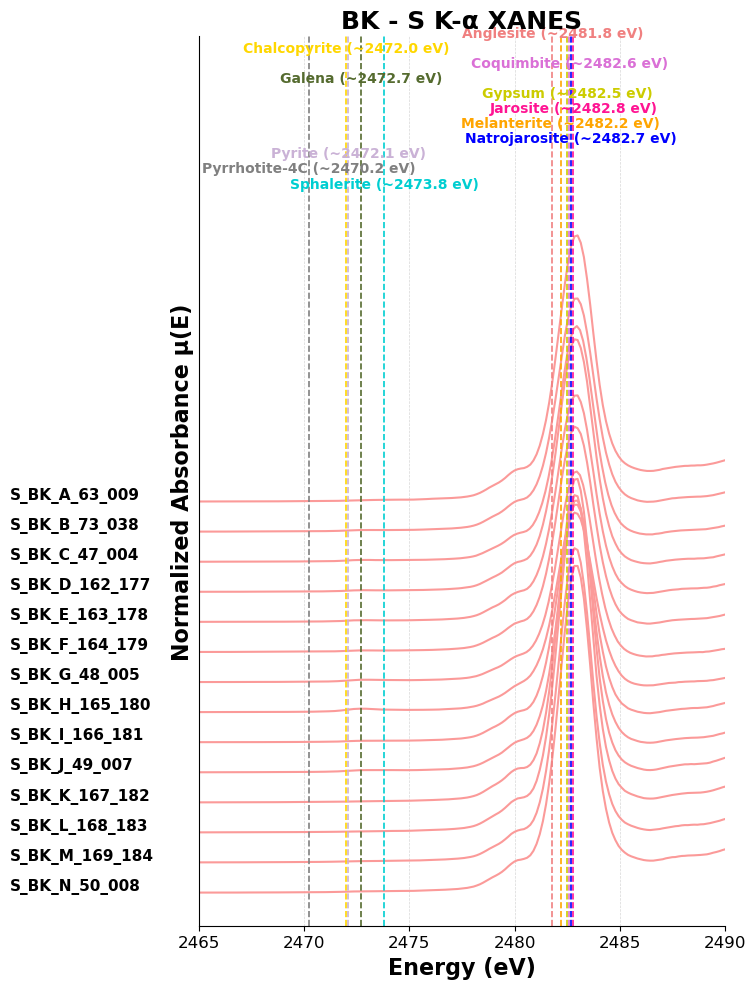

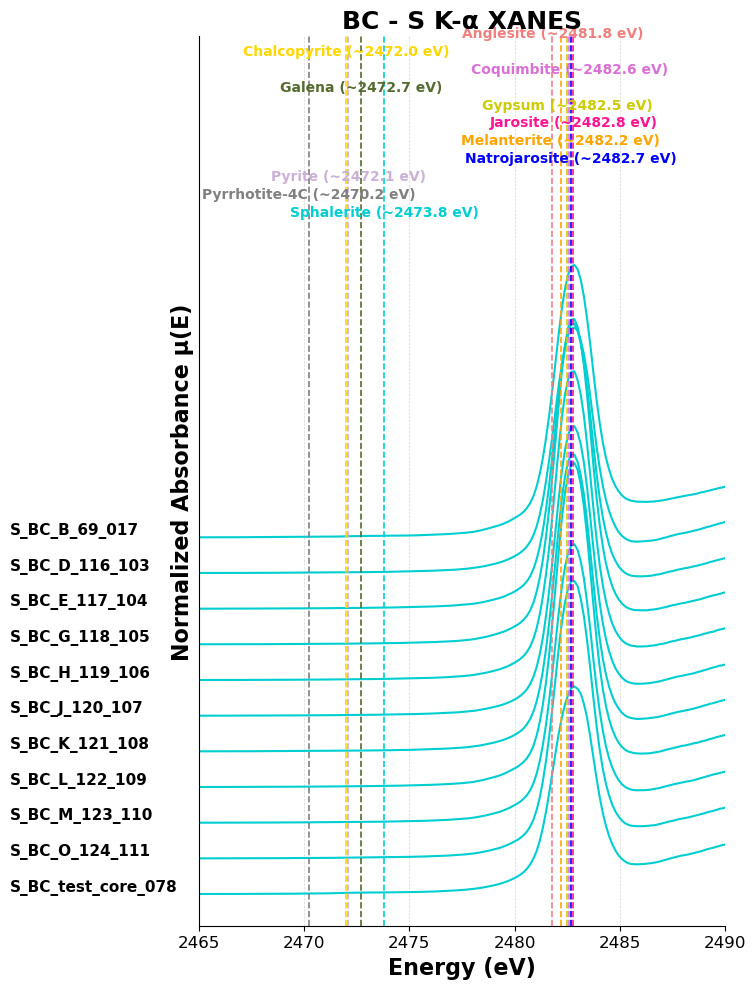

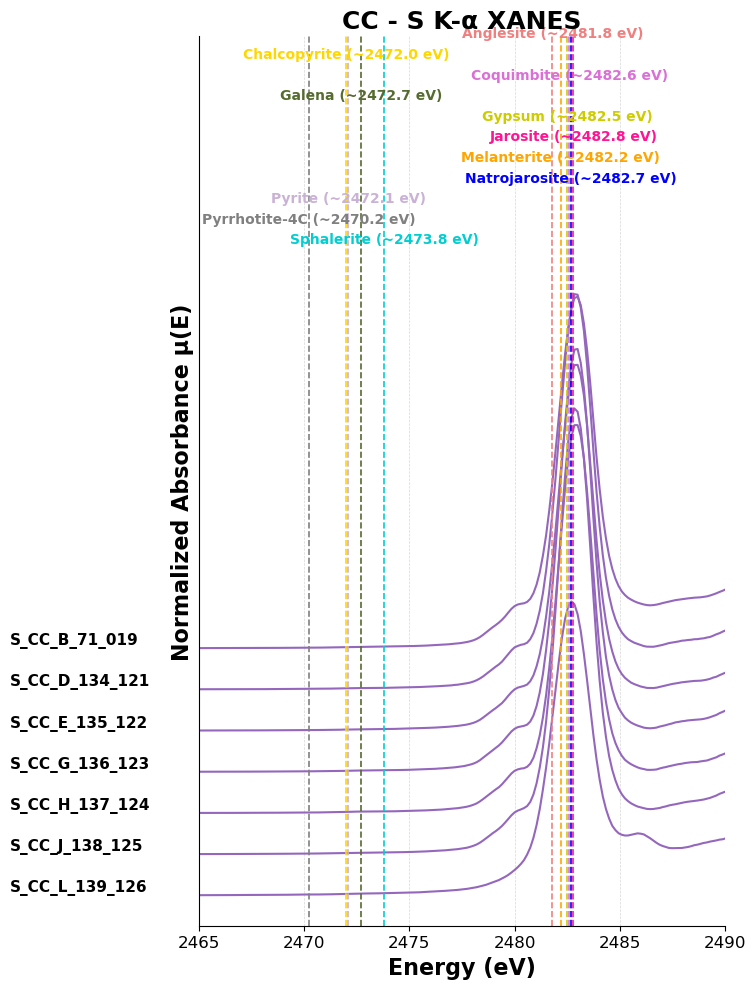

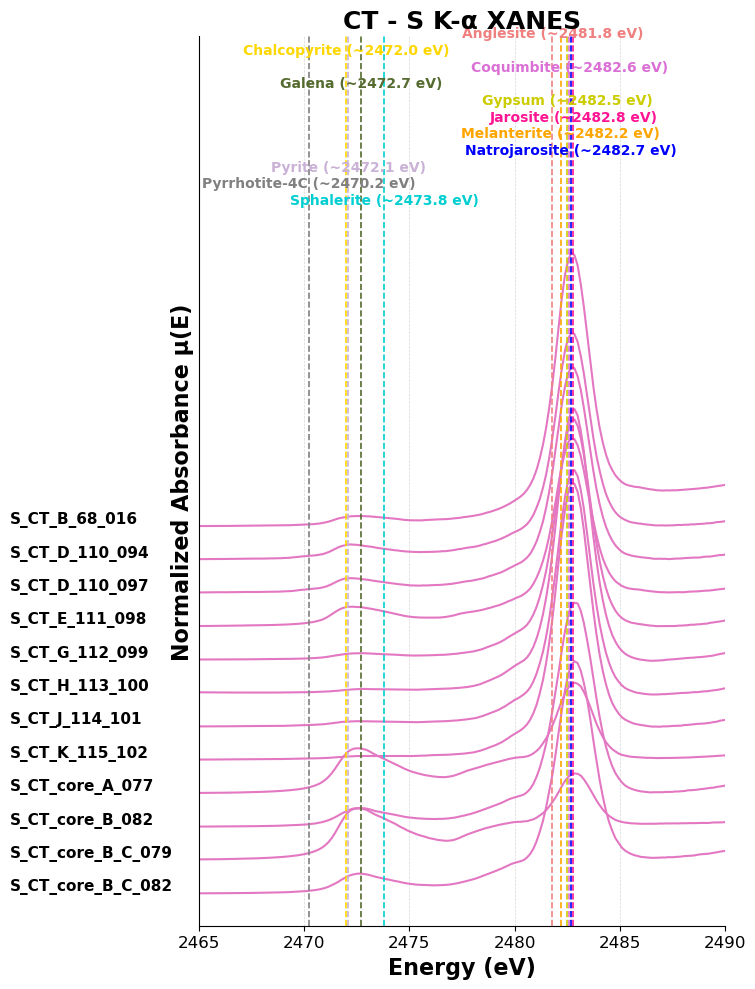

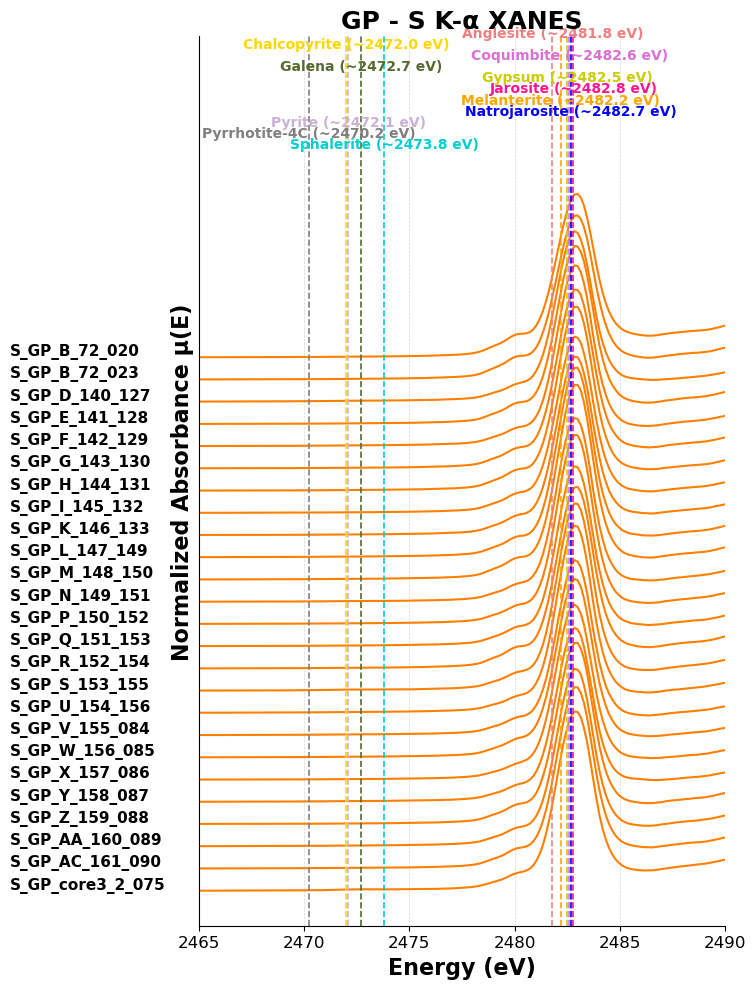

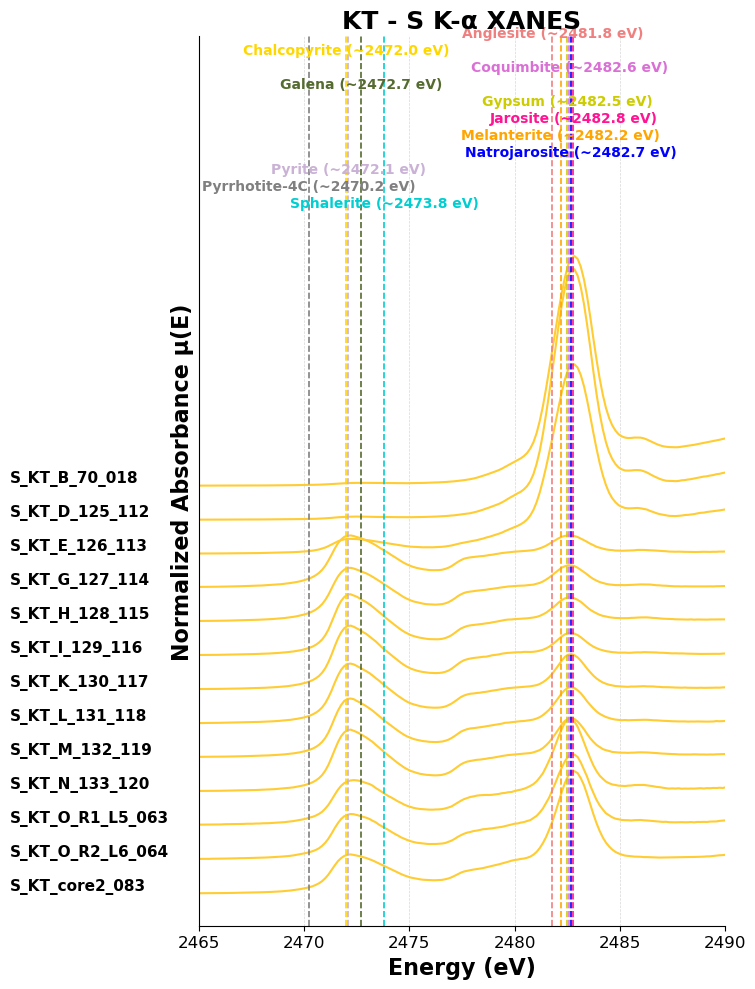

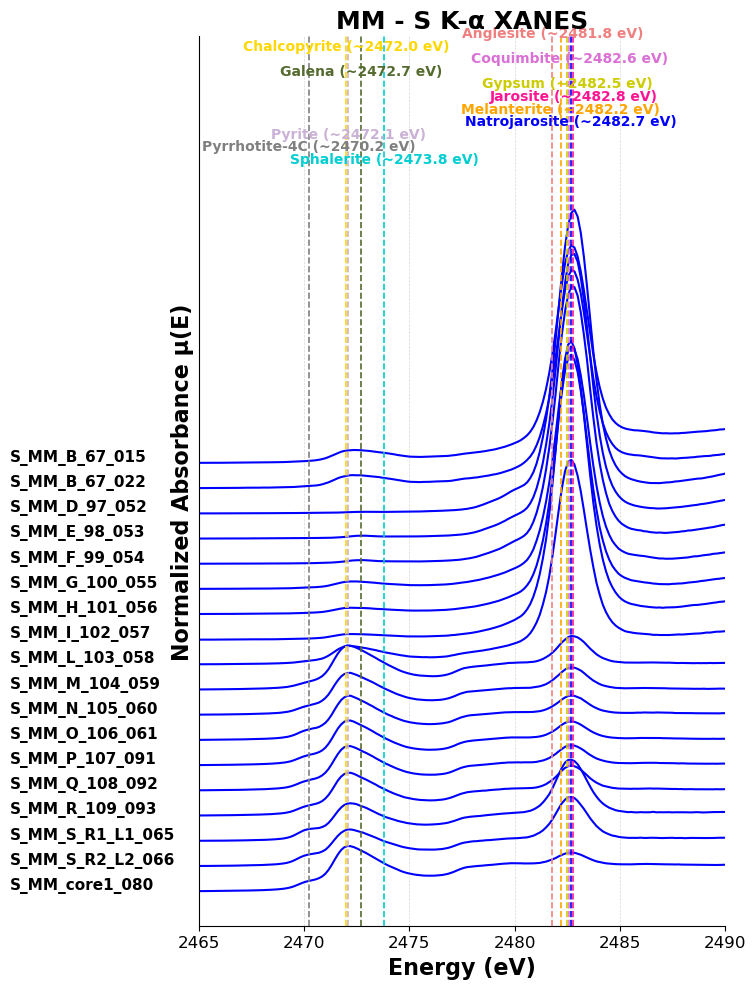

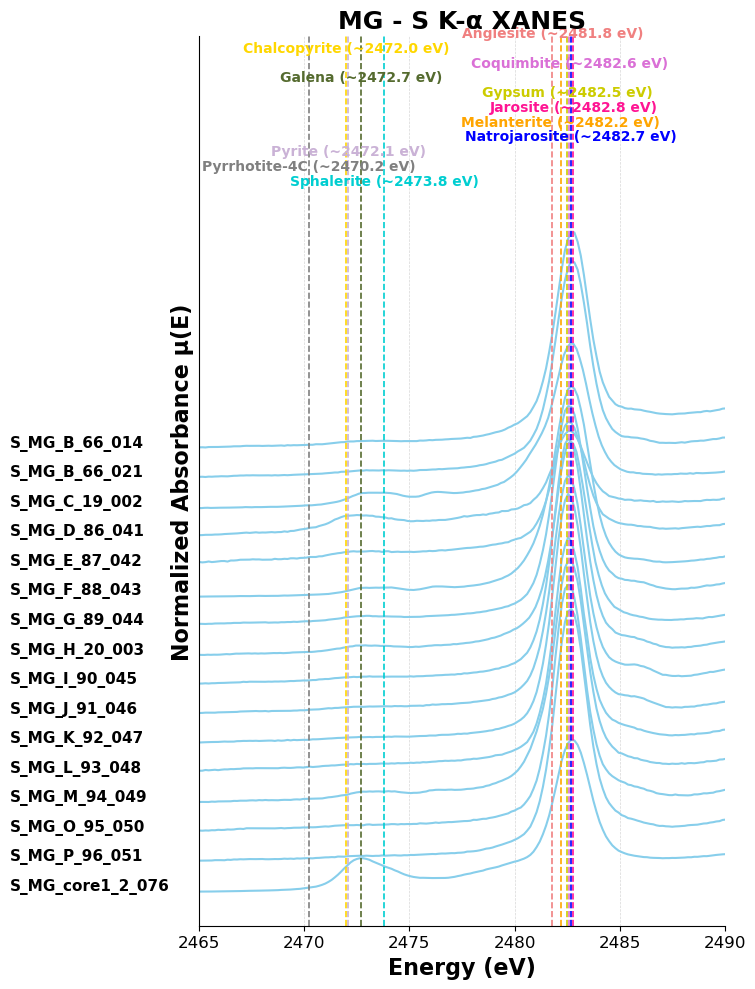

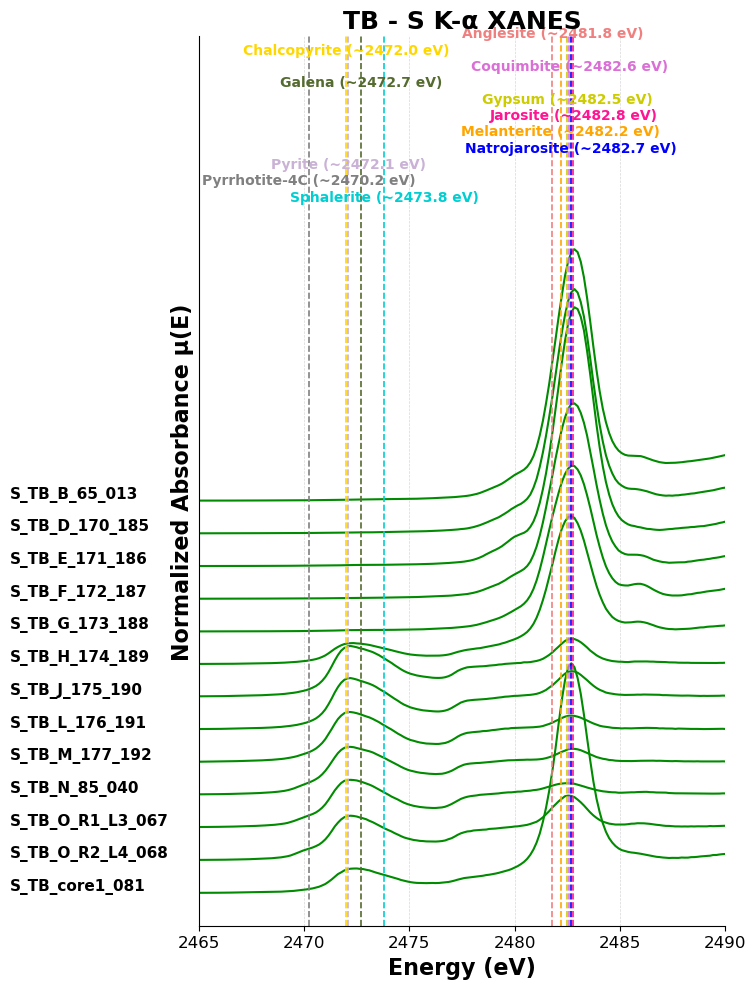

In [230]:
# ===========================================
# 2️⃣ Plotting Function: XANES
# ===========================================

# Set the offset for stacking plots
offset_step = 1

# Loop through mine abbreviations
for mine_abbrev in mine_abbreviations:
    # Find all samples that include this abbreviation
    mine_samples = [sample for sample in xanes_results.keys() if mine_abbrev in sample]
    
    # Custom sort
    mine_samples = sorted(mine_samples, key=custom_sort_key)
    
    if not mine_samples:
        continue  # skip if no samples found
    
    color = mine_abbrev_color_mapping[mine_abbrev]
    
    plt.figure(figsize=(8, 10))
    
    for idx, sample in enumerate(mine_samples):
        df = xanes_results[sample]['df']
        # Offset each plot vertically
        offset = idx * offset_step
        # Plot normalized mu(E) with offset
        plt.plot(df['energy'], df['norm_mu'] - offset, label=sample, color=color, lw=1.5, alpha=1)
        # Add label next to each curve
        plt.text(df['energy'].min()+16, -offset + 0.1, sample, color='black', fontsize=11, fontweight='bold')
    
    
    # Get Y-axis upper limit to place the label at the top
    y_max = plt.gca().get_ylim()[1]

    # ➕ Add vertical lines + repel labels
    spacing = 0.5  # adjust this for more/less space between labels
    for i, line in enumerate(vertical_lines):
        plt.axvline(line['e0'], color=line['color'], linestyle='--', lw=1.2)
        plt.text(line['e0'], y_max + spacing * (len(vertical_lines) - i),
                line['label'], color=line['color'],
                ha='center', fontsize=10, fontweight='bold')

    # Expand Y-limit to fit the tallest label
    plt.ylim(top=y_max + spacing * (len(vertical_lines) + 0.05))

    # Styling
    plt.title(f"{mine_abbrev} - S K-α XANES", fontsize=18, weight='bold')
    plt.xlabel("Energy (eV)", fontsize=16, weight='bold')
    plt.ylabel("Normalized Absorbance μ(E)", fontsize=16, weight='bold')
    plt.xlim(2465, 2490)  # <-- set energy range here
    plt.xticks(fontsize=12)
    plt.yticks([])  # hide y-axis ticks (stacked style)
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.grid(True, linestyle='--', linewidth=0.5, alpha=0.5)
    #plt.ylim(top=y_max + 0.5) # Expand y-limit to fit top labels if needed
    
    plt.tight_layout()
    # Save XANES plot
    plt.savefig(f"{save_folder}\\{mine_abbrev}_S_XANES_plot.png", dpi=300, bbox_inches='tight')
    plt.show()


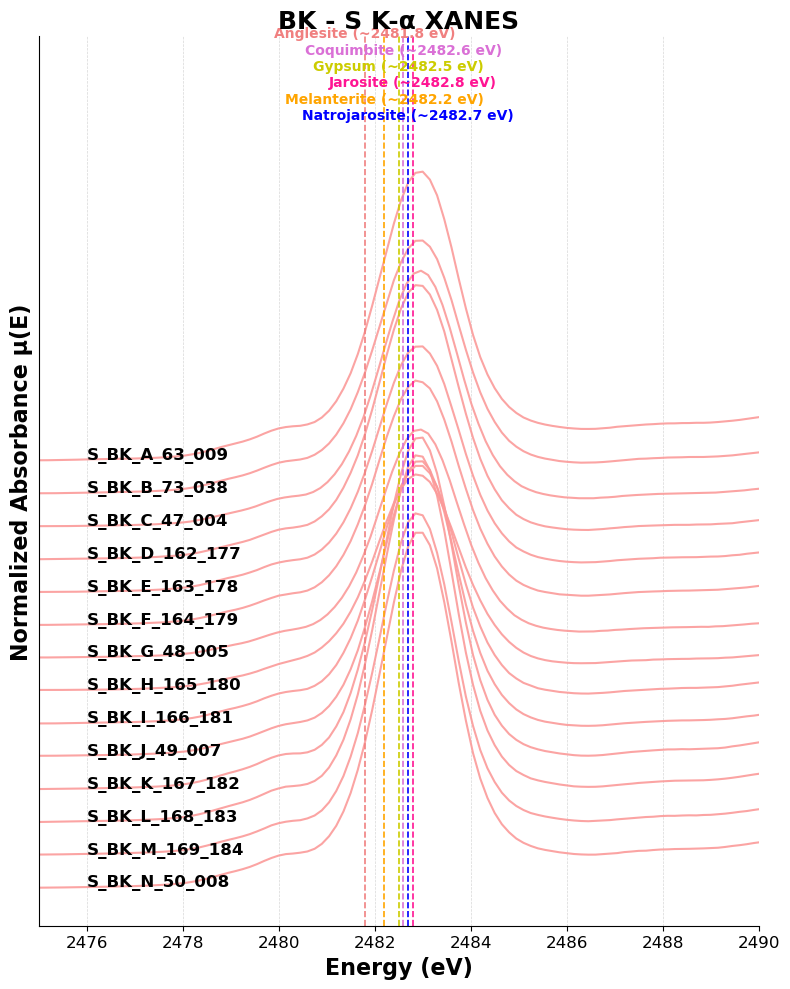

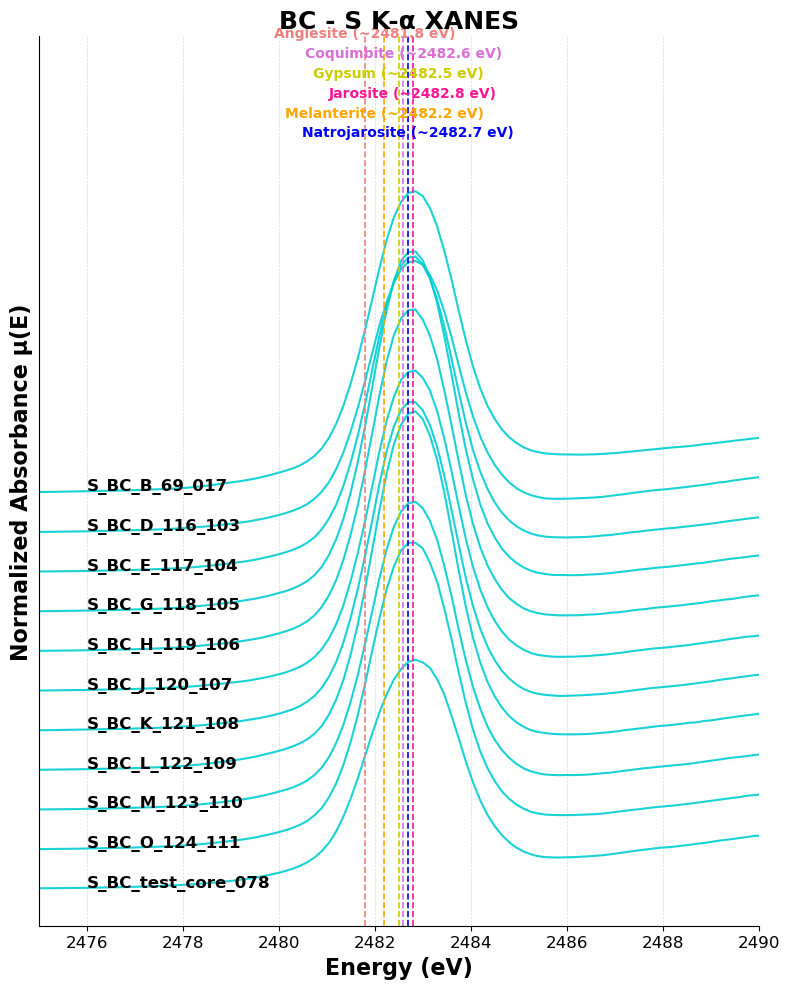

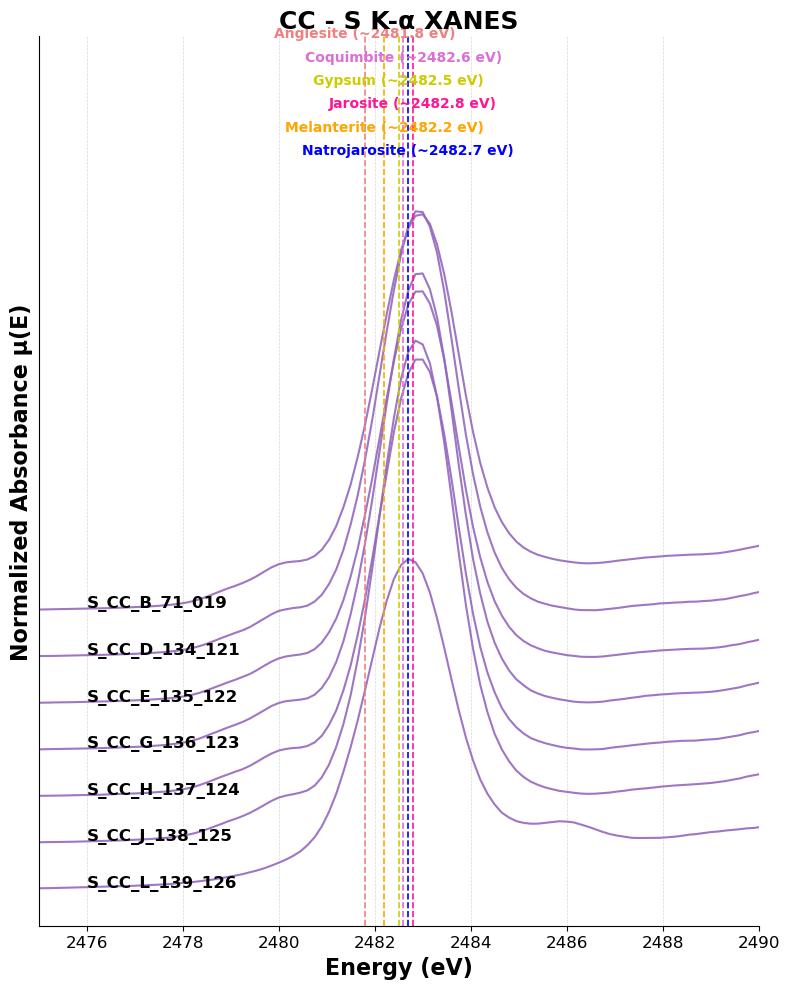

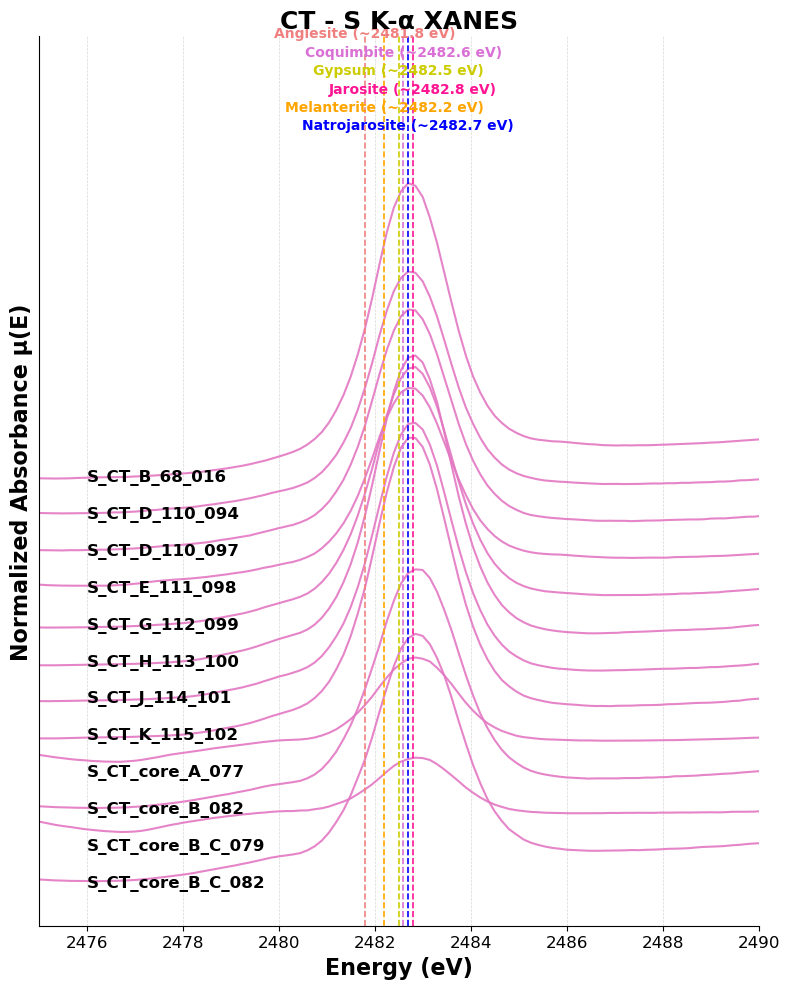

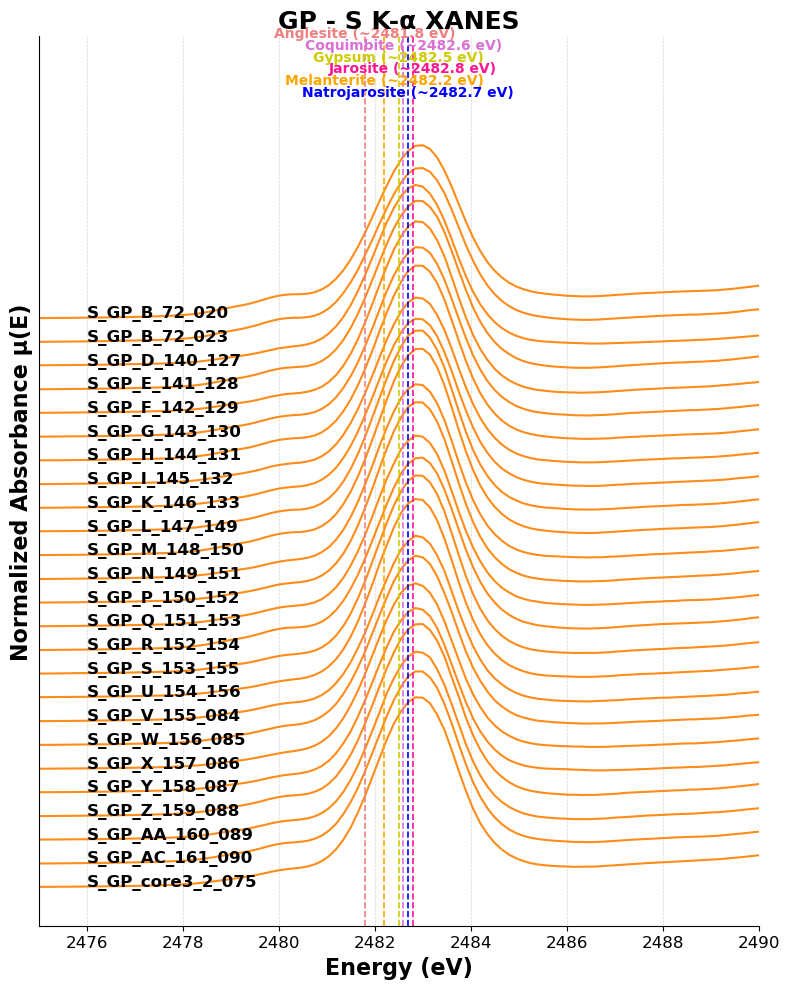

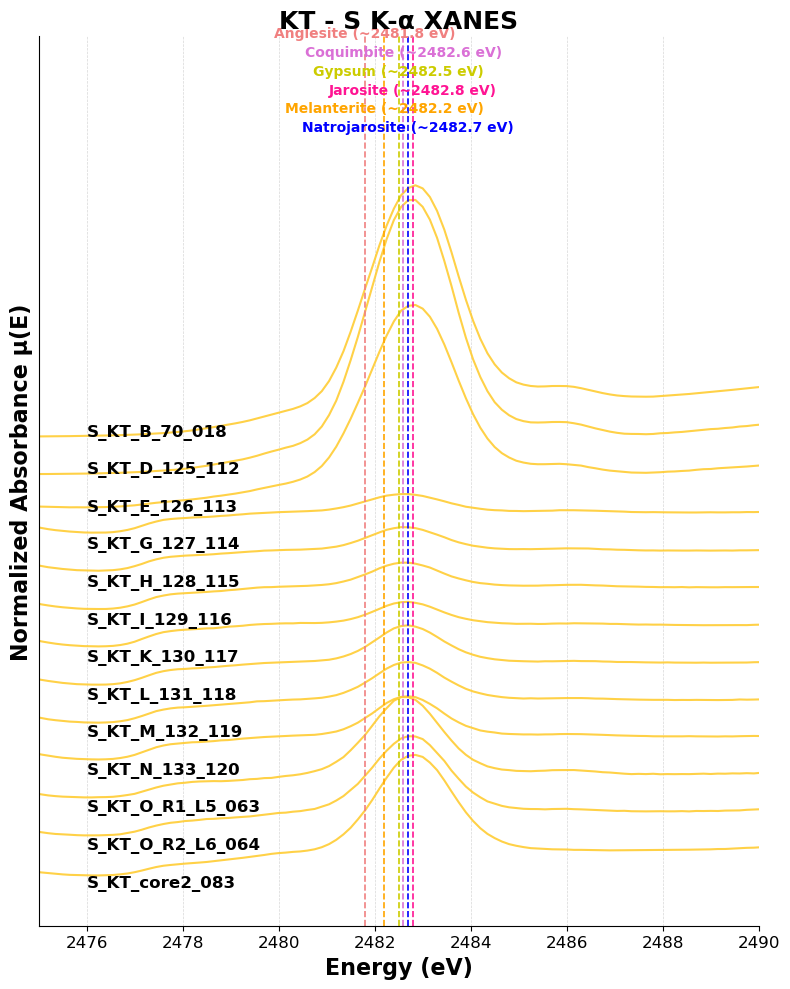

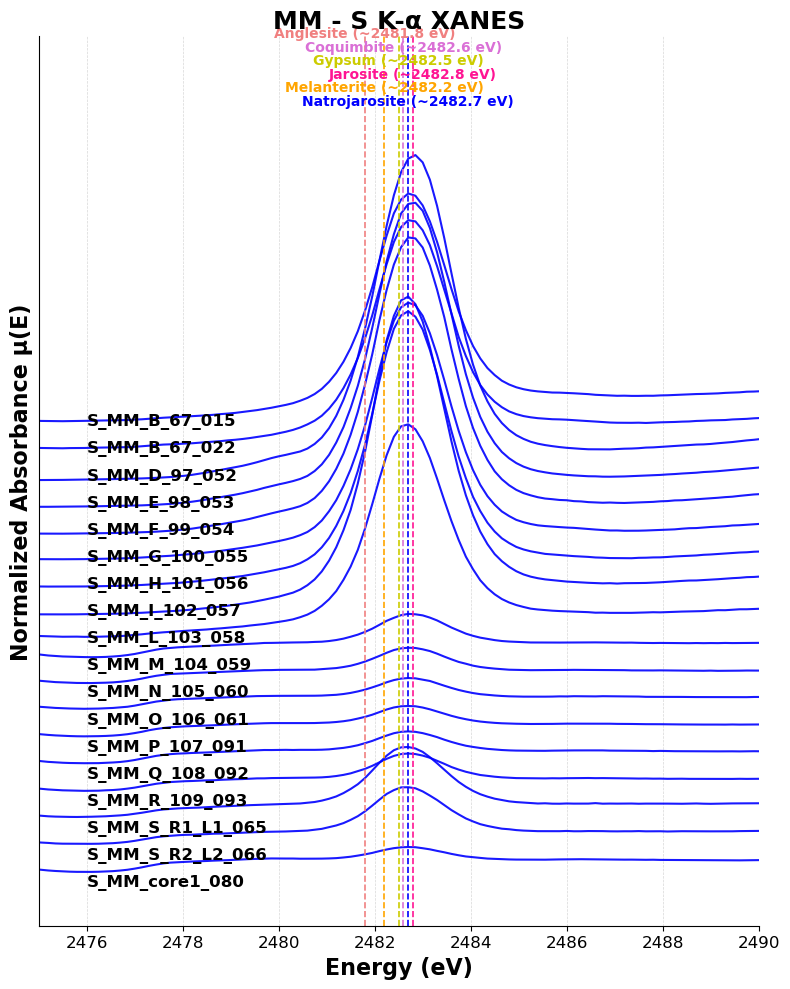

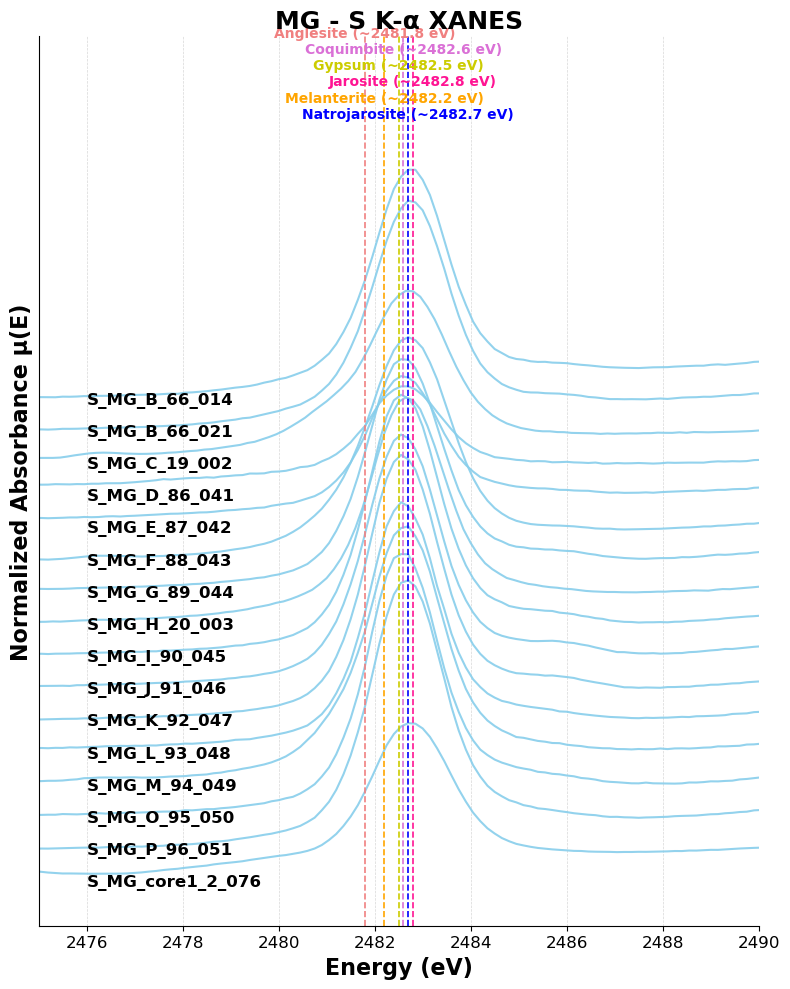

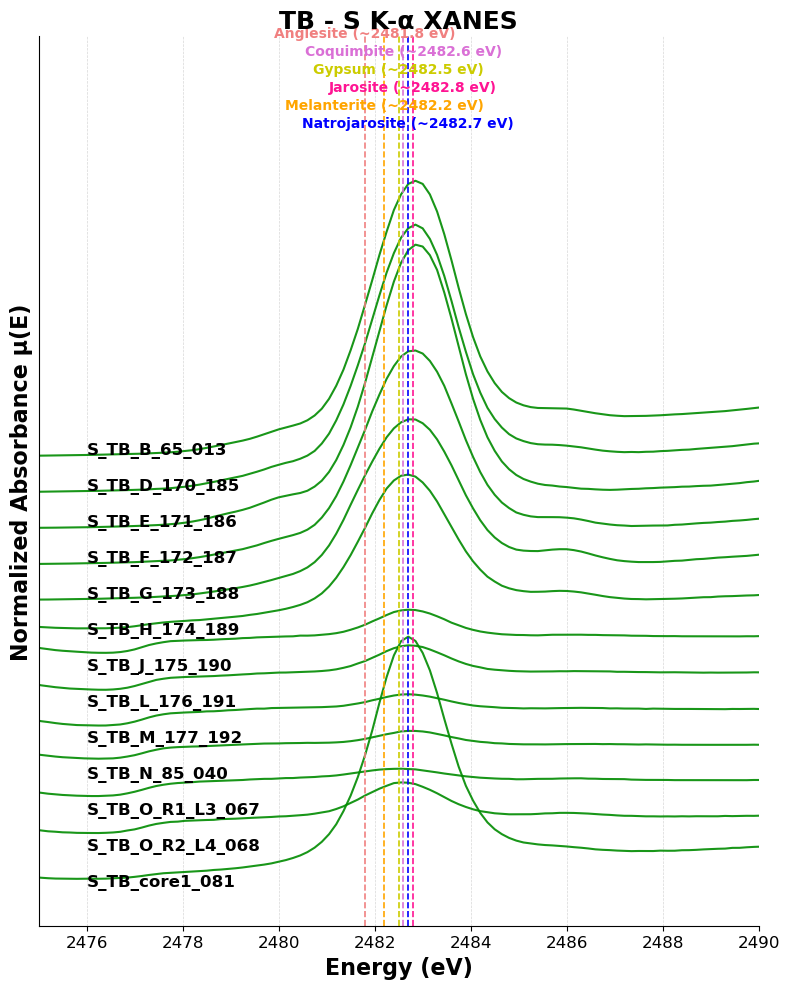

In [231]:

# ===========================================
# 2️⃣ Plotting Function: XANES Sulfates
# ===========================================

# Define the list of known sulfide minerals
sulfide_minerals = [
    "Pyrite", "Chalcopyrite", "Sphalerite", "Galena", "Pyrrhotite-4C", "Marcasite"
]

# Filter vertical_lines to exclude sulfides
vertical_lines_no_sulfides = [
    line for line in vertical_lines
    if not any(sulfide in line['label'] for sulfide in sulfide_minerals)
]


# Loop through mine abbreviations
for mine_abbrev in mine_abbreviations:
    # Find all samples that include this abbreviation
    mine_samples = [sample for sample in xanes_results.keys() if mine_abbrev in sample]
    
    # Custom sort
    mine_samples = sorted(mine_samples, key=custom_sort_key)
    
    if not mine_samples:
        continue  # skip if no samples found
    
    color = mine_abbrev_color_mapping[mine_abbrev]
    
    plt.figure(figsize=(8, 10))
    
    for idx, sample in enumerate(mine_samples):
        df = xanes_results[sample]['df']
        # Offset each plot vertically
        offset = idx * offset_step
        # Plot normalized mu(E) with offset
        plt.plot(df['energy'], df['norm_mu'] - offset, label=sample, color=color, lw=1.5, alpha=0.9)
        # Add label next to each curve
        plt.text(df['energy'].min()+36, -offset + 0.1, sample, color='black', fontsize=12, fontweight='bold')
    
    
    # Get Y-axis upper limit to place the label at the top
    y_max = plt.gca().get_ylim()[1]

    # ➕ Add vertical lines + repel labels
    spacing = 0.5  # adjust this for more/less space between labels
    for i, line in enumerate(vertical_lines_no_sulfides):
        plt.axvline(line['e0'], color=line['color'], linestyle='--', lw=1.2)
        plt.text(line['e0'], y_max + spacing * (len(vertical_lines_no_sulfides) - i),
                line['label'], color=line['color'],
                ha='center', fontsize=10, fontweight='bold')

    # Expand Y-limit to fit the tallest label
    plt.ylim(top=y_max + spacing * (len(vertical_lines_no_sulfides) + 0.05))

    # Styling
    plt.title(f"{mine_abbrev} - S K-α XANES", fontsize=18, weight='bold')
    plt.xlabel("Energy (eV)", fontsize=16, weight='bold')
    plt.ylabel("Normalized Absorbance μ(E)", fontsize=16, weight='bold')
    plt.xlim(2475, 2490)  # <-- set energy range here
    plt.xticks(fontsize=12)
    plt.yticks([])  # hide y-axis ticks (stacked style)
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.grid(True, linestyle='--', linewidth=0.5, alpha=0.5)
    #plt.ylim(top=y_max + 0.5) # Expand y-limit to fit top labels if needed
    
    plt.tight_layout()
    # Save XANES plot
    plt.savefig(f"{save_folder}\\{mine_abbrev}_S_XANES_plot.png", dpi=300, bbox_inches='tight')
    plt.show()

# **Trying LCF**
(just have 3 references for now)

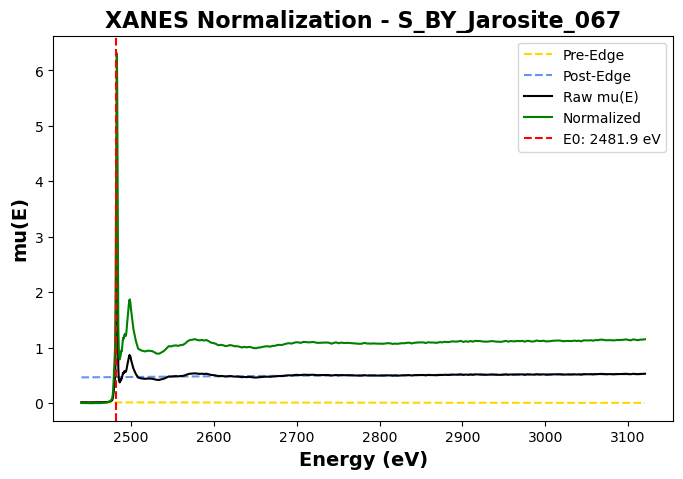

✅ Normalized S_BY_Jarosite_067 (E0 = 2481.9 eV)


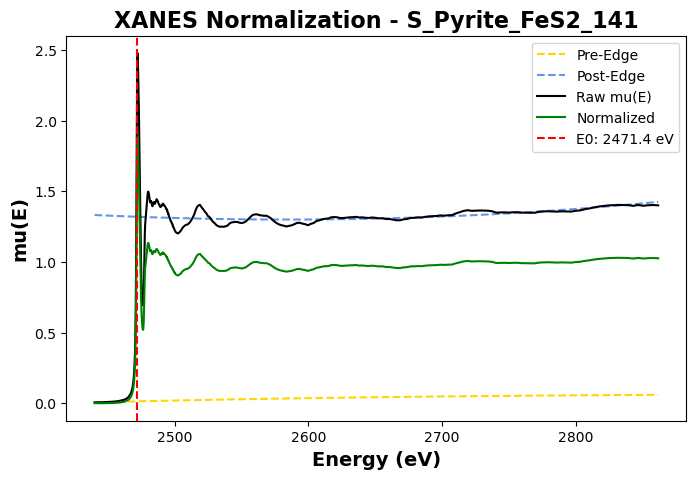

✅ Normalized S_Pyrite_FeS2_141 (E0 = 2471.4 eV)


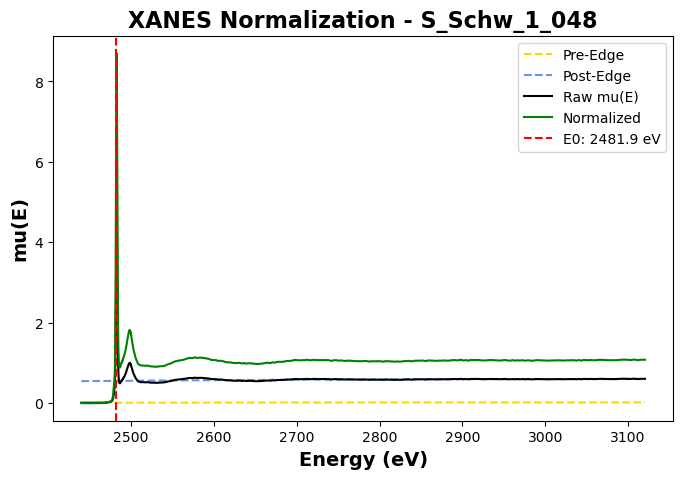

✅ Normalized S_Schw_1_048 (E0 = 2481.9 eV)


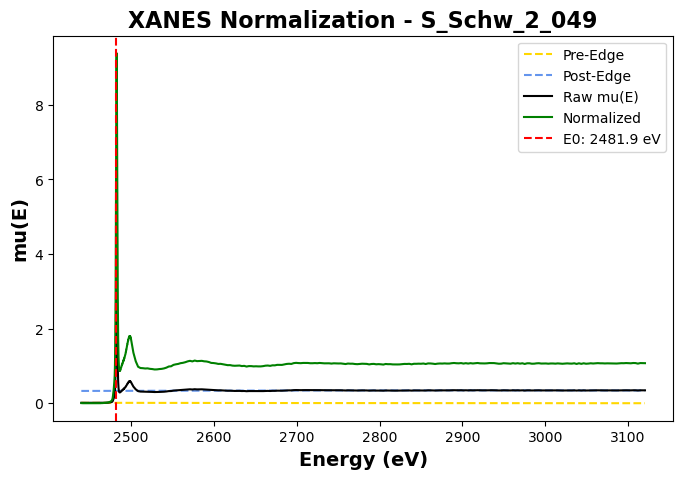

✅ Normalized S_Schw_2_049 (E0 = 2481.9 eV)


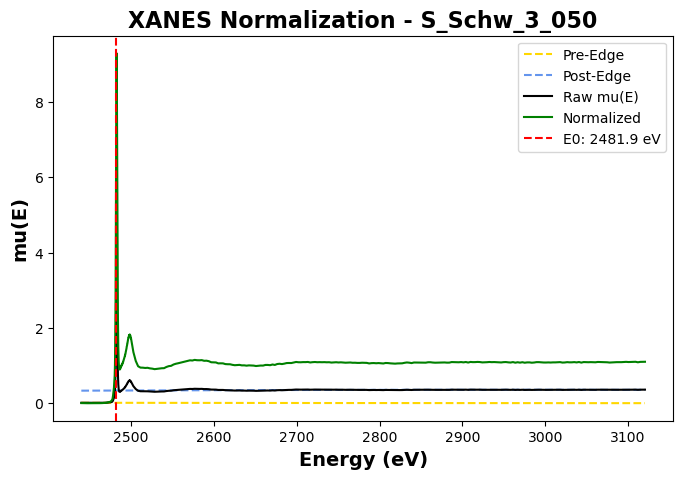

✅ Normalized S_Schw_3_050 (E0 = 2481.9 eV)


In [232]:
# === 5️⃣ XANES NORMALIZATION & E0 FINDING ===
references_xanes_results = {}
for reference, df in averaged_references.items():
    energy = df['energy'].values
    mu = df['mu_avg'].values

    # Create a Larch Group and store data
    g = Group()
    g.energy = energy
    g.mu = mu

    # Apply pre-edge normalization (this modifies 'g' in place)
    pre_edge(g.energy, g.mu, group=g, # energy, intensity, and the group to treat
                    pre1 = -50, # the lower bond of the function to fit the pre-edge
                    pre2 = -20, # the upper bond of the function to fit the pre-edge
                    norm1 = 40, # the lower bond of the function to fit the post-edge
                    norm2= 1020, # the upper bond of the function to fit the post-edge
                    nnorm= 2, # degree for the polynomials
                    nvict= 4 # energy exponent to use for pre-edge fit.
                    )

    # Store results in DataFrame
    df2_result = pd.DataFrame({
        'energy': g.energy,
        'mu': g.mu,
        'pre_edge': g.pre_edge,
        'post_edge': g.post_edge,
        'norm_mu': g.norm,
        'flat': g.flat,
    })

    # Plot XANES normalization
    plt.figure(figsize=(8, 5))
    plt.plot(g.energy, g.pre_edge, label='Pre-Edge', color='gold', linestyle='--')
    plt.plot(g.energy, g.post_edge, label='Post-Edge', color='cornflowerblue', linestyle='--')
    plt.plot(g.energy, g.mu, label='Raw mu(E)', color='black')
    plt.plot(g.energy, g.norm, label='Normalized', color='green')
    plt.axvline(g.e0, color='r', linestyle='--', label=f'E0: {g.e0:.1f} eV')
    plt.title(f'XANES Normalization - {reference}', fontsize=16, fontweight='bold')
    plt.xlabel('Energy (eV)', fontsize=14, fontweight='bold')
    plt.ylabel('mu(E)', fontsize=14, fontweight='bold')
    plt.legend()
    plt.show()

    # Store results
    references_xanes_results[reference] = {
        'df': df2_result,
        'e0': g.e0
    }
    
    print(f"✅ Normalized {reference} (E0 = {g.e0:.1f} eV)")

#print(references_xanes_results)

# Functions added:
- LCF fit
- Sorting key

In [233]:
from lmfit import Model, Parameters
import numpy as np


# Function for Linear Combination Fit (LCF) using lmfit
def run_lcf_with_lmfit(sample_energy, sample_mu, references):
    """
    Fit a sample spectrum as a linear combination of reference spectra using lmfit.
    references = dict of {name: (energy_array, mu_array)}
    Returns: fitted model result and weights
    """
    # Interpolate references to match sample energy grid
    ref_interp = {
        name: np.interp(sample_energy, energy, mu)
        for name, (energy, mu) in references.items()
    }

    # Define the model: linear sum of each reference
    def model_func(x, **weights):
        return sum(weights[name] * ref_interp[name] for name in ref_interp)

    mod = Model(model_func, independent_vars=['x'])

    # Initial weights: all equal
    params = Parameters()
    for name in ref_interp:
        params.add(name, value=1 / len(ref_interp), min=0, max=1)

    # Optional: constrain weights to sum to 1
    params.add('__constraint__', expr=' + '.join(ref_interp.keys()) + ' - 1')

    # Fit the model
    result = mod.fit(sample_mu, params, x=sample_energy)

    return result, {name: result.params[name].value for name in ref_interp}

# Function for Sorting Key
def custom_sort_key(label):
    parts = label.split('-')  # 'TB-O' → ['TB', 'O']
    if len(parts) != 2:
        return (3, label)  # fallback

    _, horizon = parts
    horizon_upper = horizon.upper()

    if any(horizon_upper.startswith(x) for x in ['CORE']):
        category = 2
    elif horizon_upper in ['AA', 'AB', 'AC', 'AD']:
        category = 1
    else:
        category = 0

    return (category, horizon_upper)



## Applying LCF function

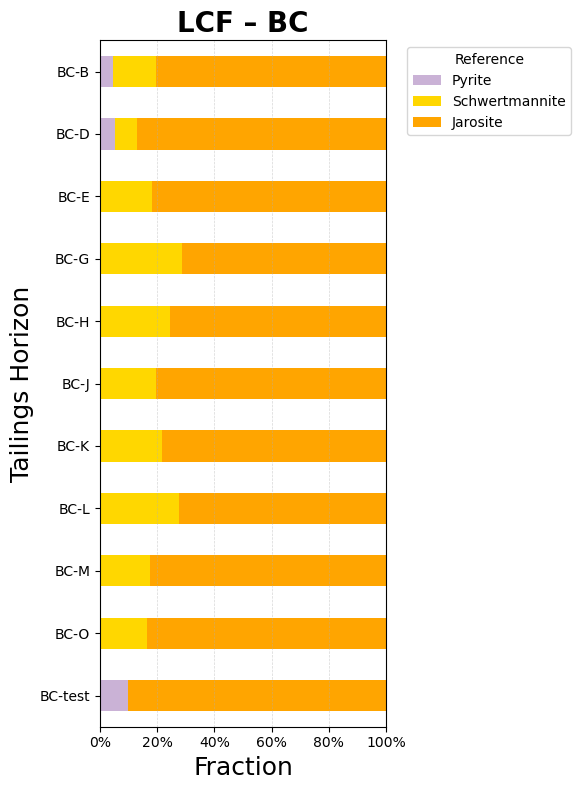

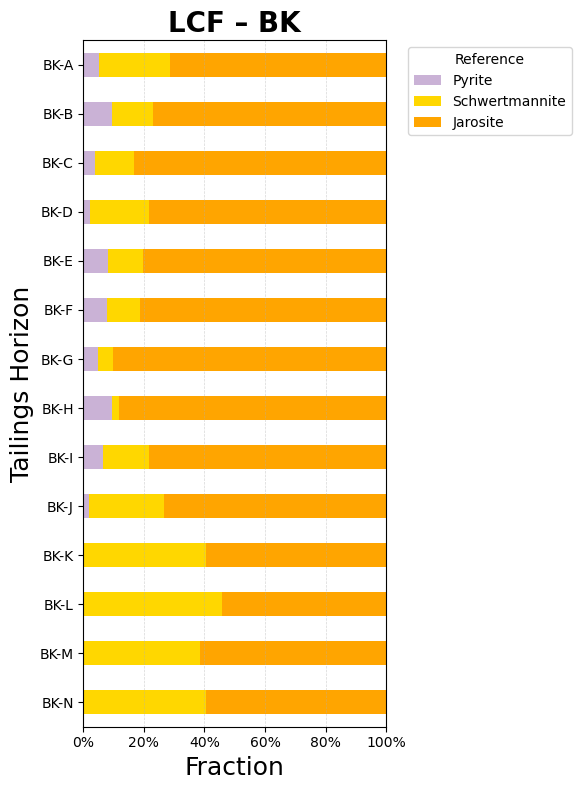

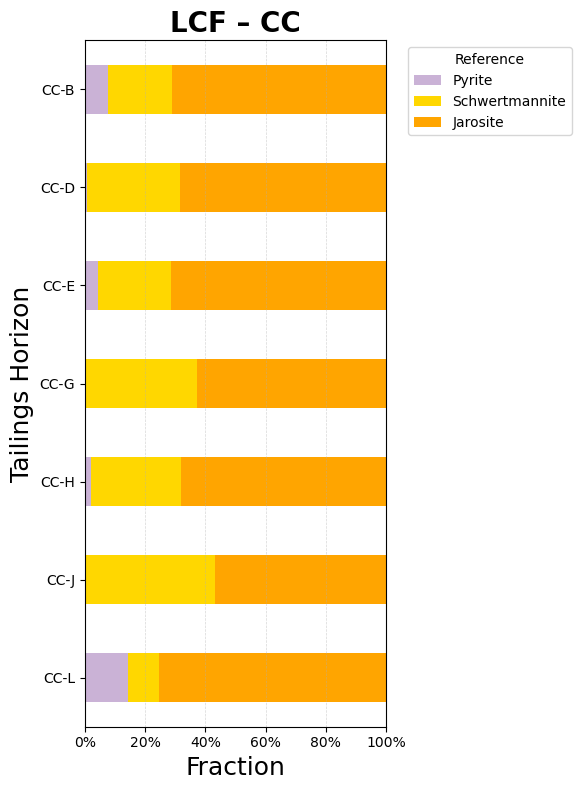

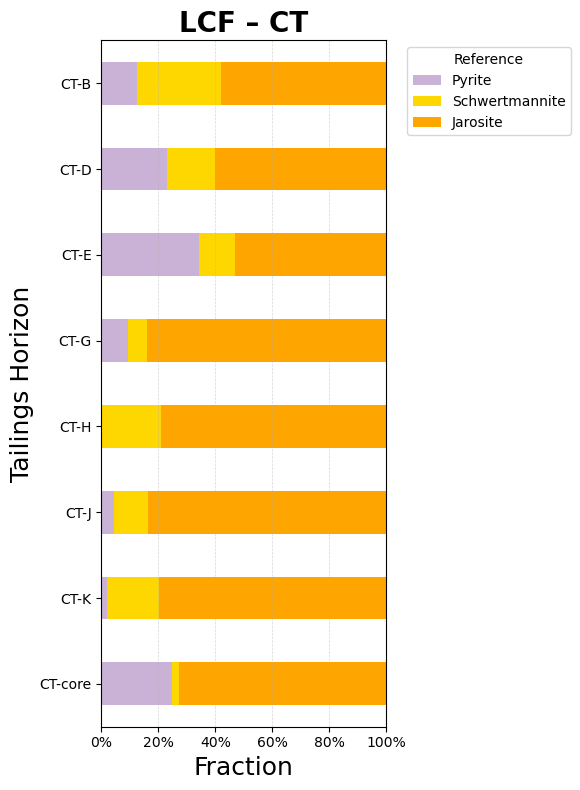

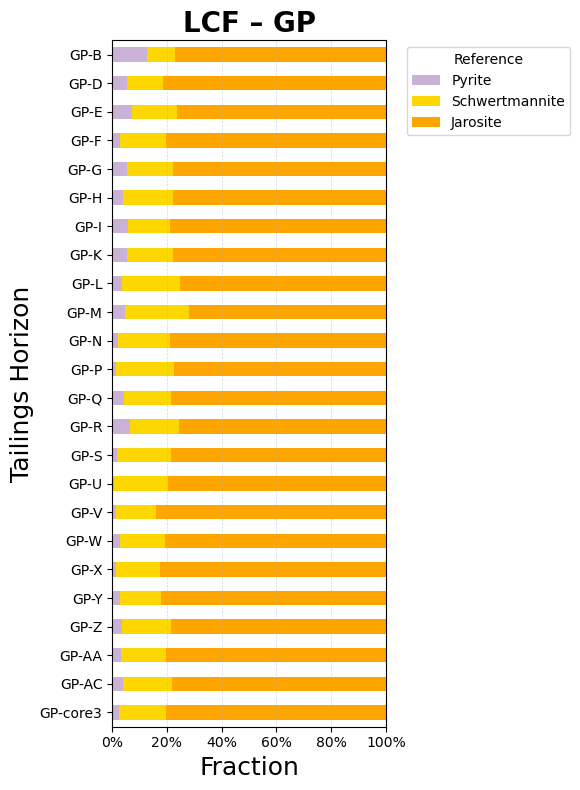

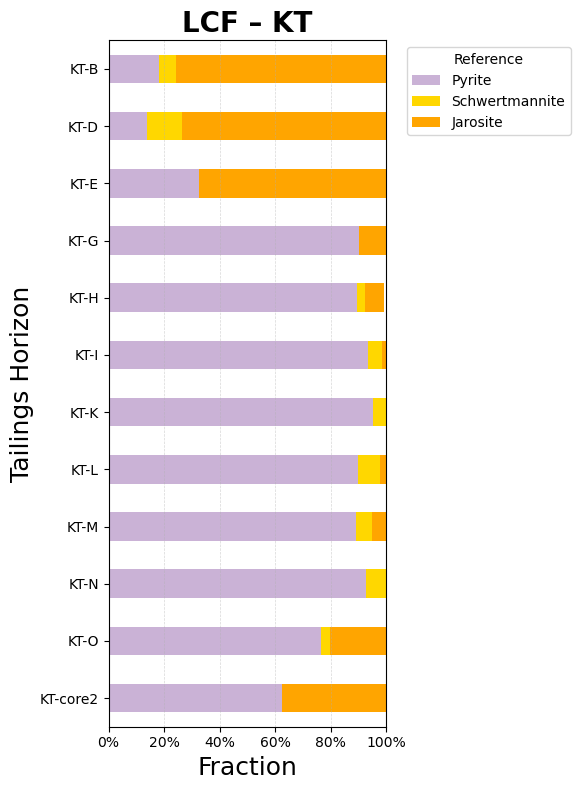

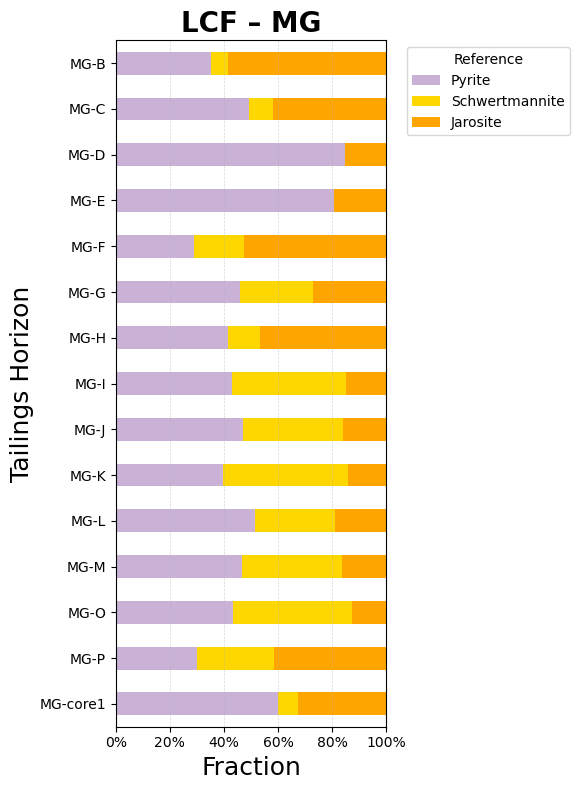

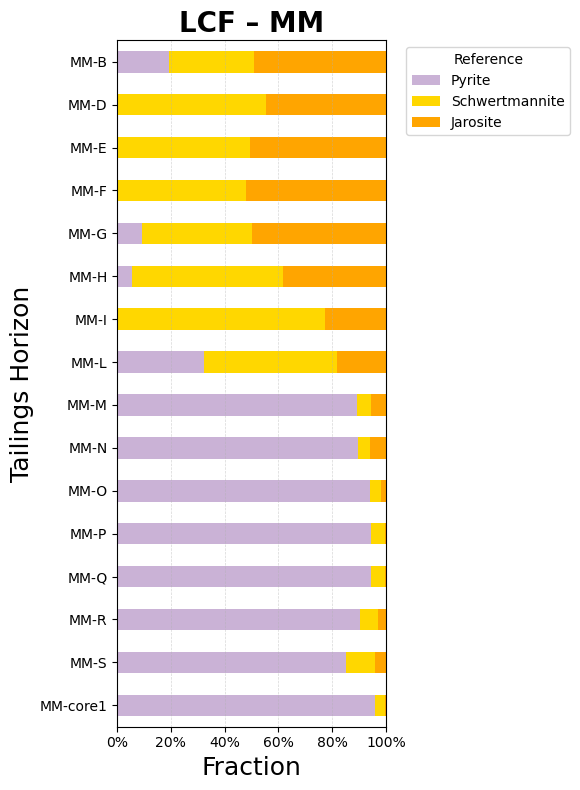

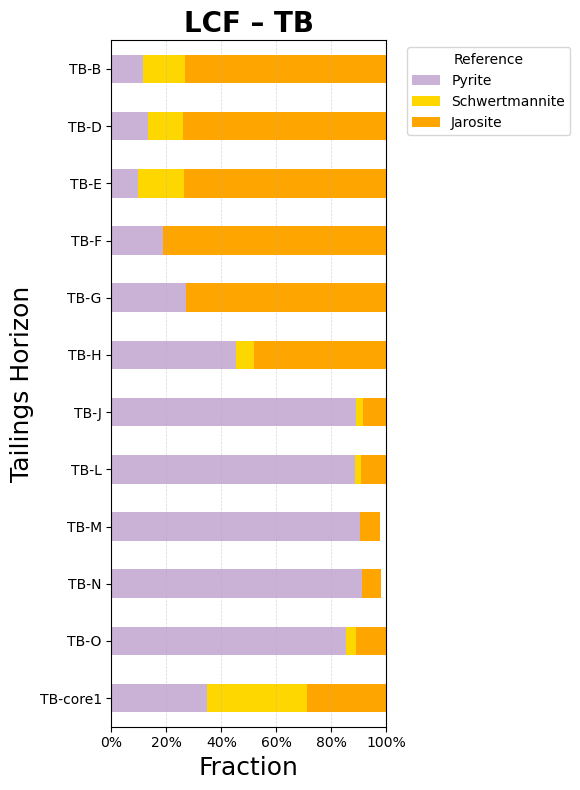

In [234]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter
from larch import Group
#from larch.xafs import linearcombo_fit
from scipy.interpolate import interp1d

# ==========================================
# ✅ 1. SETUP: Define references and result container
# ==========================================
reference_keys = [
    'S_BY_Jarosite_067',
    'S_Pyrite_FeS2_141',
    #'S_Schw_1_048',
    #'S_Schw_2_049',
    'S_Schw_3_050'
]

lcf_results = {}

# ==========================================
# ✅ 2. PREPARE REFERENCE GROUPS
# ==========================================
reference_groups = {}
target_energy = None

for ref_key in reference_keys:
    ref_df = references_xanes_results[ref_key]['df']
    g = Group()
    g.energy = ref_df['energy'].values
    g.mu = ref_df['norm_mu'].values
    reference_groups[ref_key] = g
    if target_energy is None:
        target_energy = g.energy

# ==========================================
# ✅ 3. RUN LCF ON ALL SAMPLES (EXCLUDING REFERENCES)
# ==========================================

# Prepare references in the format {name: (energy, norm_mu)}
ref_spectra = {
    key: (
        references_xanes_results[key]['df']['energy'].values,
        references_xanes_results[key]['df']['norm_mu'].values
    )
    for key in reference_keys
}

# Loop over all samples in xanes_results
for sample_key, result in xanes_results.items():
    if sample_key in reference_keys:
        continue

    df = result['df']
    sample_energy = df['energy'].values
    sample_mu = df['norm_mu'].values

    # Run LCF and store result
    lcf_fit, weights = run_lcf_with_lmfit(sample_energy, sample_mu, ref_spectra)
    lcf_results[sample_key] = weights



# ==========================================
# ✅ 4. ORGANIZE RESULTS BY MINE-HORIZON
# ==========================================
mine_site_data = {}

for key, weights in lcf_results.items():
    try:
        parts = key.split('_')  # e.g., ['S', 'TB', 'O', '001', 'clean']
        mine = parts[1]
        horizon = parts[2]
        combined_key = f"{mine}-{horizon}"
        if mine not in mine_site_data:
            mine_site_data[mine] = {}
        mine_site_data[mine][combined_key] = weights
    except Exception as e:
        print(f"⚠️ Skipped {key} due to error: {e}")


# ==========================================
# ✅ 5. PLOT STACKED BAR CHART PER MINE SITE
# ==========================================

for mine, horizons in mine_site_data.items():
    df = pd.DataFrame(horizons).T
    df = df.fillna(0)

    # Sort and flip so the deepest horizons appear at the bottom
    df = df.loc[sorted(df.index, key=custom_sort_key)].iloc[::-1]


    # Friendly reference names and color assignment
    friendly_names = {
        'S_BY_Jarosite_067': 'Jarosite',
        'S_Pyrite_FeS2_141': 'Pyrite',
        'S_Schw_1_048': 'Schwertmannite',
        'S_Schw_2_049': 'Schwertmannite',
        'S_Schw_3_050': 'Schwertmannite',
    }
    # Rename columns to friendly names
    df = df.rename(columns=friendly_names)
    
    
    # Reorder columns: sulfides to the left, sulfates to the right
    desired_order = ['Sphalerite', 'Pyrite', 'Chalcopyrite',  # Sulfides
                    'Schwertmannite',             # Intermediate species
                    'Jarosite', 'Natrojarosite', 'Gypsum']    # Sulfates

    df = df[[col for col in desired_order if col in df.columns]]
 

    # Define color map
    color_map = {
        "Jarosite": "orange",
        "Pyrite": "#CAB2D6",
        "Schwertmannite": "gold",
        # Add other references if needed
    }

    # Assign consistent colors
    bar_colors = [color_map.get(col, "grey") for col in df.columns]

    # Plot
    ax = df.plot(kind='barh', stacked=True, figsize=(6, 8), color=bar_colors)
    ax.set_title(f"LCF – {mine}", fontsize=20, fontweight='bold')
    ax.set_xlabel("Fraction", fontsize=18)
    ax.set_ylabel("Tailings Horizon", fontsize=18)
    ax.set_xlim(0, 1)
    ax.xaxis.set_major_formatter(FuncFormatter(lambda x, _: f"{x*100:.0f}%"))  # show 0–100%
    ax.legend(title="Reference", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(axis='x', linestyle='--', linewidth=0.5, alpha=0.5)
    plt.tight_layout()
    plt.show()





## **LCF XANES Fitting check**

In [235]:
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
from sklearn.metrics import mean_squared_error, r2_score
import numpy as np

def plot_lcf_stacked_xanes(xanes_results, references_xanes_results, lcf_results, mine_site_data, custom_sort_key):
    for mine, horizons in mine_site_data.items():
        # Get matching sample keys
        sample_keys = [k for k in lcf_results if f"_{mine}_" in k]
        if not sample_keys:
            print(f"⚠️ No samples found for mine: {mine}")
            continue

        # Extract 'Mine-Horizon' like TB-O
        def extract_horizon(sample_key):
            try:
                parts = sample_key.split('_')
                return f"{parts[1]}-{parts[2]}"
            except:
                return sample_key

        # Sort and reverse for top-down order
        sorted_keys = sorted(sample_keys, key=lambda k: custom_sort_key(extract_horizon(k)))

        # Auto-scale figure height
        fig_height = max(6, len(sorted_keys) * 1.01)
        plt.figure(figsize=(6, fig_height))
        offset_step = 1.2

        for i, sample_key in enumerate(sorted_keys):
            df = xanes_results[sample_key]['df']
            energy = df['energy'].values
            norm_mu = df['norm_mu'].values

            # Build LCF fit
            fit_weights = lcf_results[sample_key]
            fit_curve = np.zeros_like(energy)

            for ref_key, weight in fit_weights.items():
                ref_df = references_xanes_results[ref_key]['df']
                ref_energy = ref_df['energy'].values
                ref_mu = ref_df['norm_mu'].values
                ref_interp = np.interp(energy, ref_energy, ref_mu)
                fit_curve += weight * ref_interp

            # Compute RMSE and R²
            rmse = np.sqrt(mean_squared_error(norm_mu, fit_curve))
            r2 = r2_score(norm_mu, fit_curve)

            # Plot curves with vertical offset
            offset = i * offset_step
            
            
            plt.plot(energy, norm_mu - offset, color='black', lw=1.4, label='Data' if i == 0 else "")
            plt.plot(energy, fit_curve - offset, color='red', lw=1.2, linestyle='--', label='LCF Fit' if i == 0 else "")

            # Label horizon and stats
            label = extract_horizon(sample_key)
            # Plot bold label
            plt.text(energy[0] + 19, -offset + 0.25, label, fontsize=11, fontweight='bold')
            # Plot smaller stats below
            plt.text(energy[0] + 19, -offset - 0.25, f"RMSE={rmse:.3f}\nR²={r2:.2f}", fontsize=8, fontweight='normal')


        # Final plot styling
        plt.title(f"{mine} – XANES LCF", fontsize=16, fontweight='bold')
        plt.xlabel("Energy (eV)", fontsize=13, fontweight='bold')
        plt.ylabel("Normalized μ(E) (offset)", fontsize=13, fontweight='bold')
        plt.grid(True, linestyle='--', linewidth=0.5, alpha=0.5)
        plt.yticks([])
        plt.xlim(2465, 2490)
        plt.legend(loc='upper right')
        plt.tight_layout()
        plt.show()


## Calling up the function for fit check

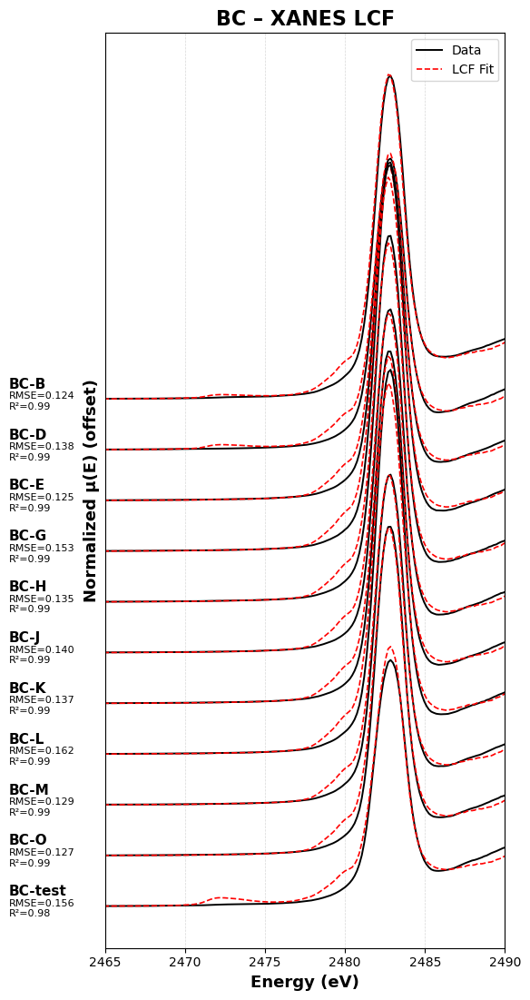

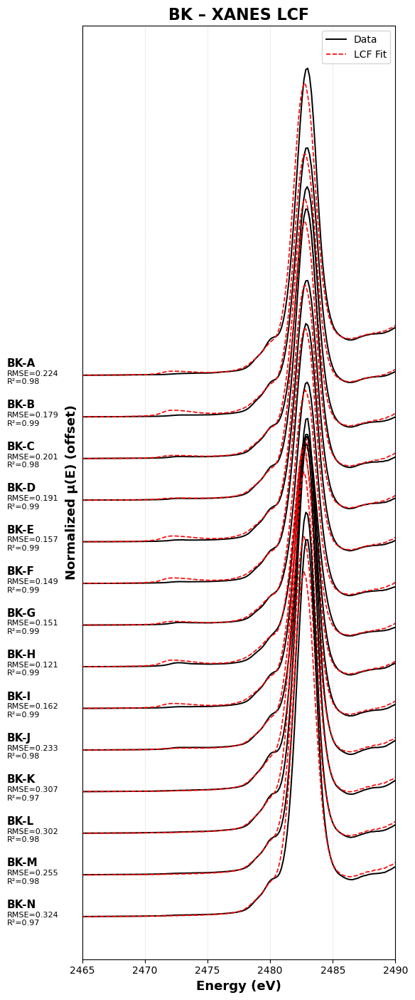

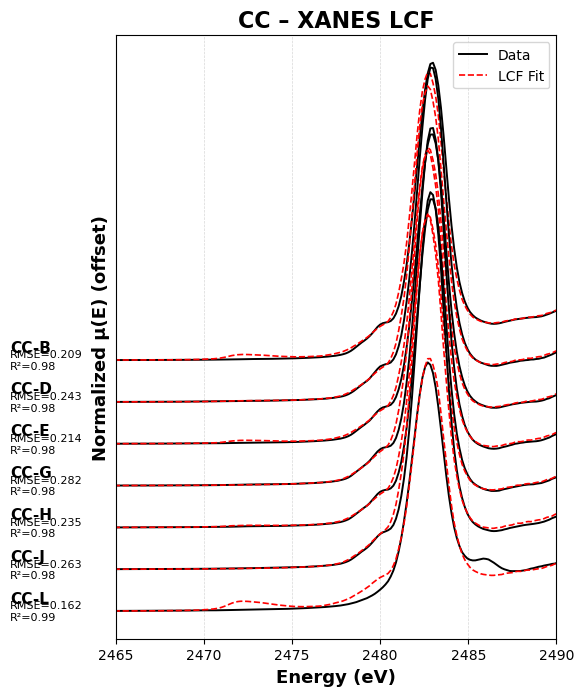

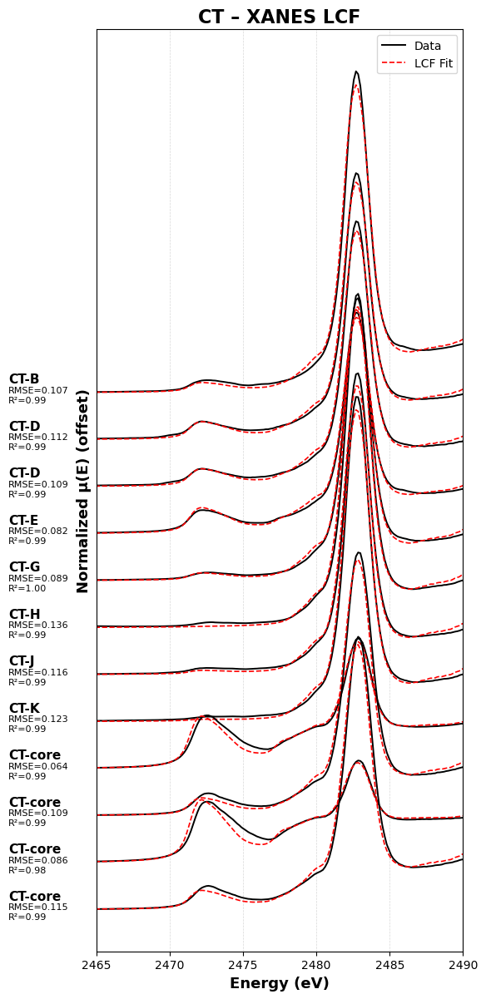

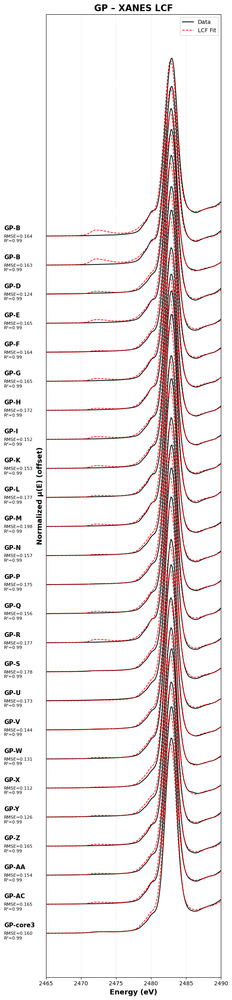

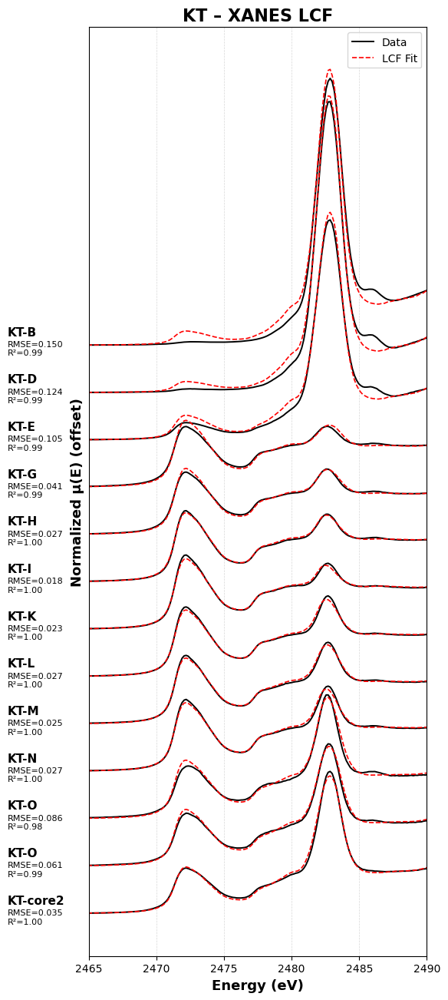

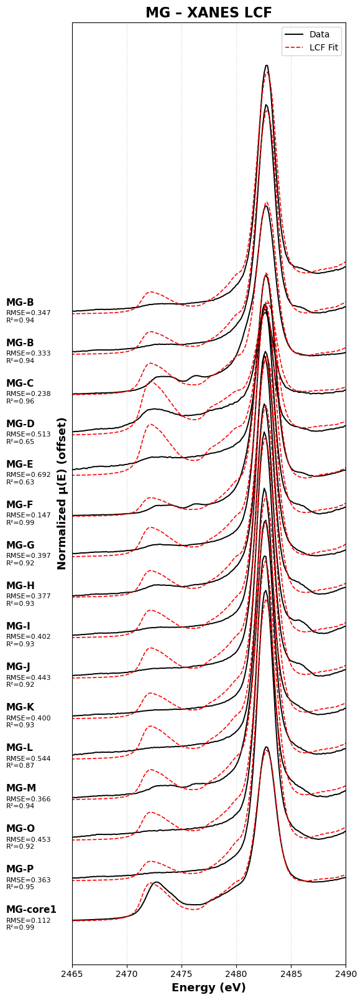

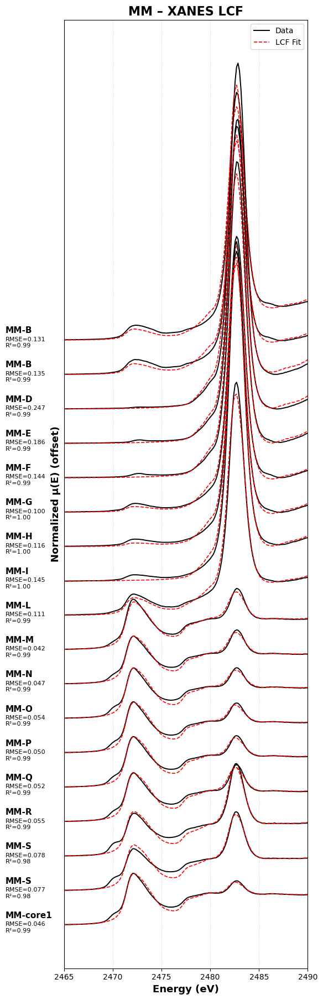

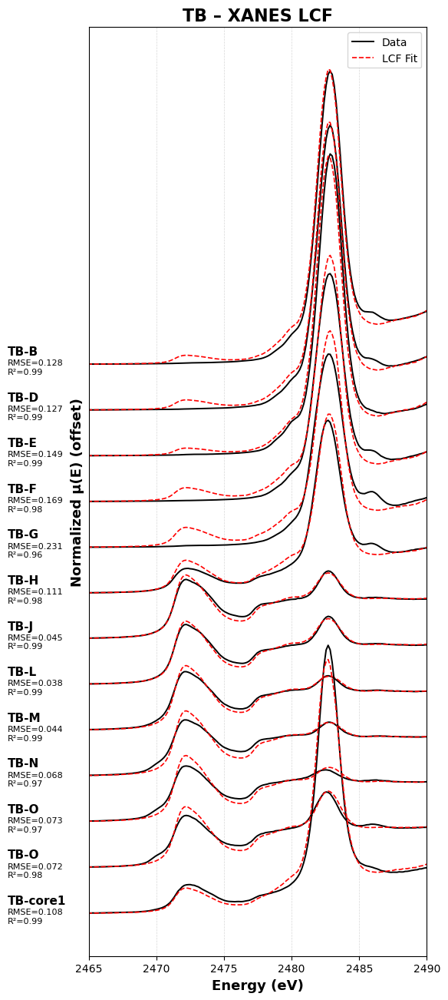

In [236]:
plot_lcf_stacked_xanes(
    xanes_results,
    references_xanes_results,
    lcf_results,
    mine_site_data,
    custom_sort_key
)


# **IGNORE FROM HERE ONWARDS!**

# **Plotting EXAFS chi(K)**

⚠️ No samples found for BB
⚠️ No samples found for FM
⚠️ No samples found for IK
⚠️ No samples found for IM


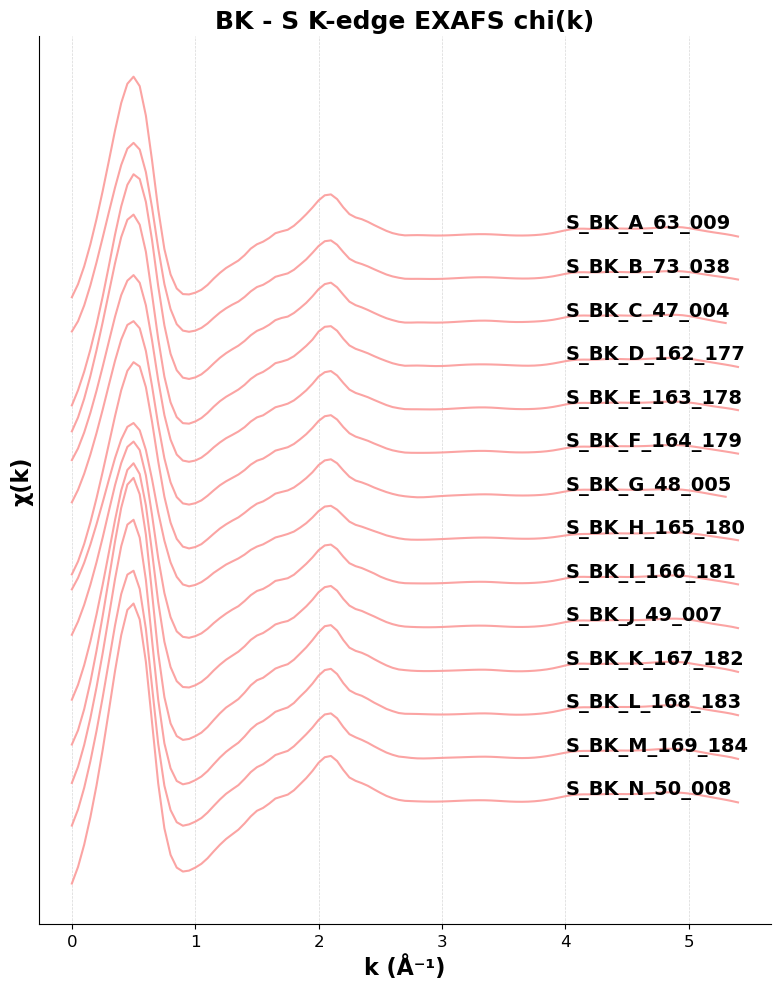

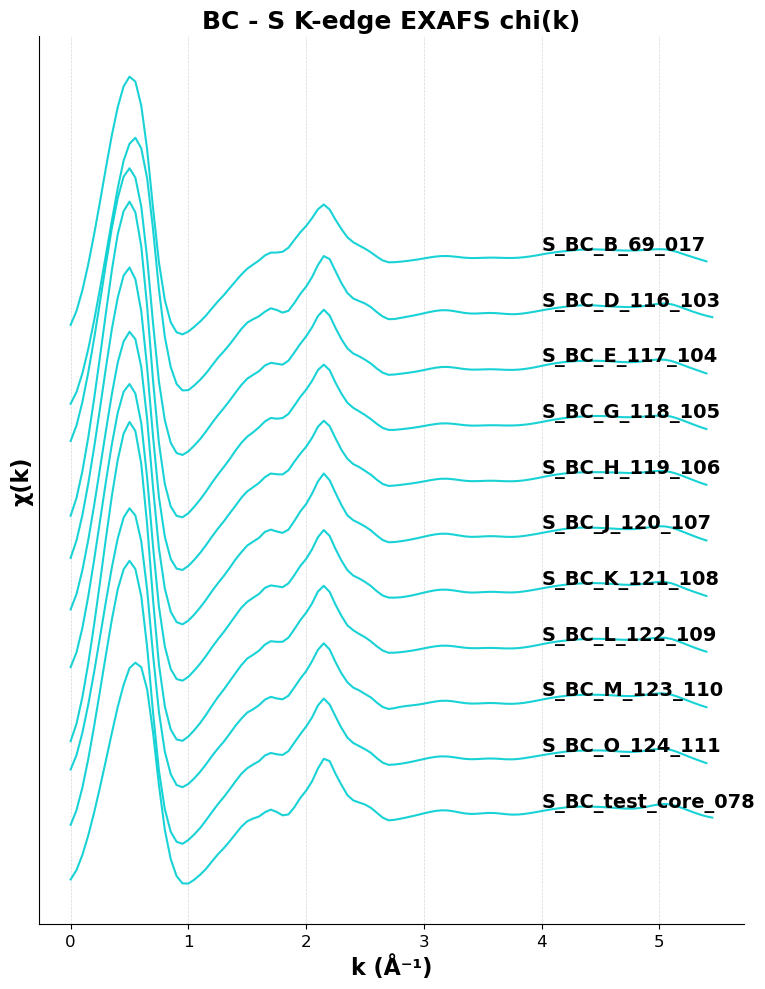

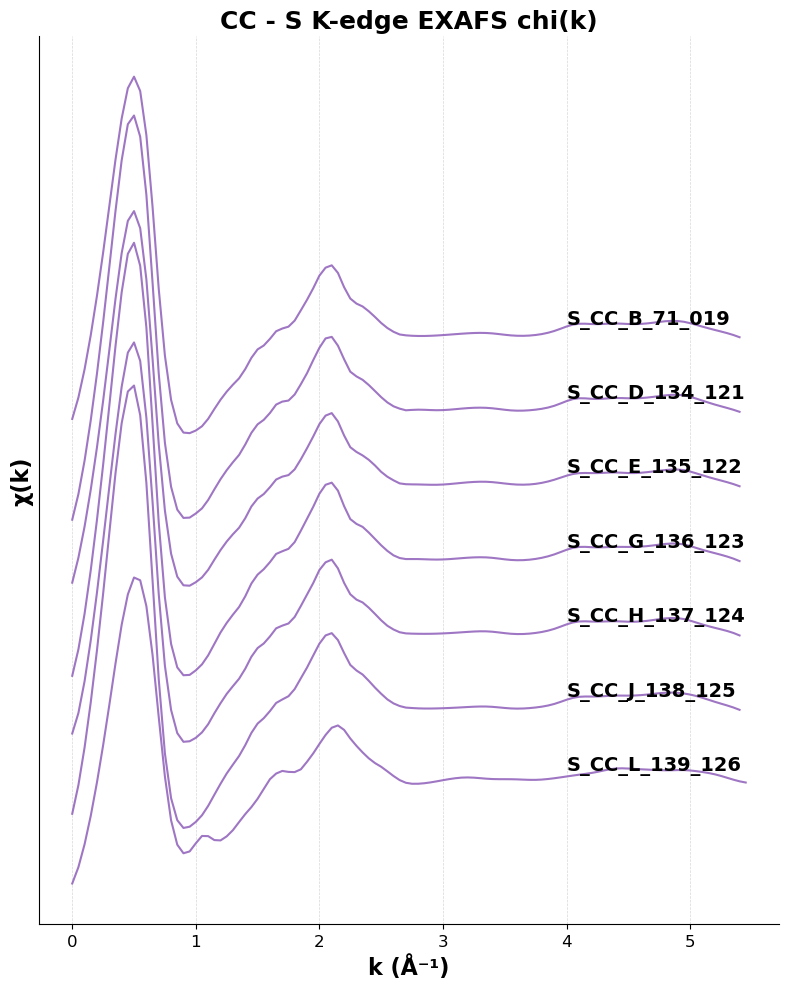

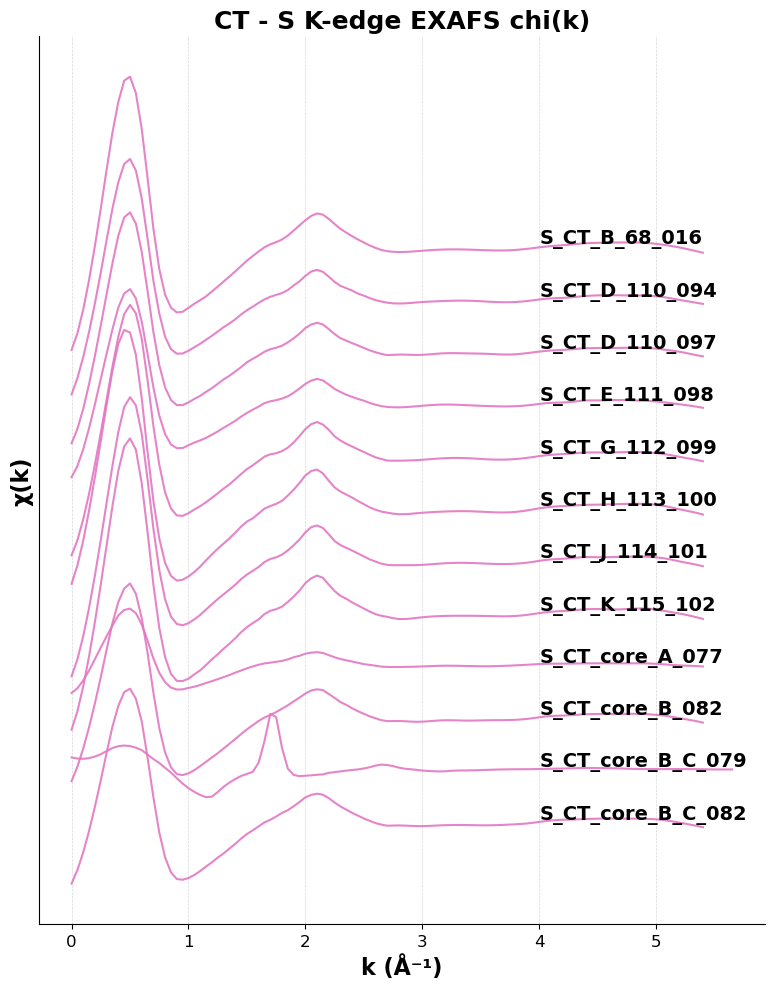

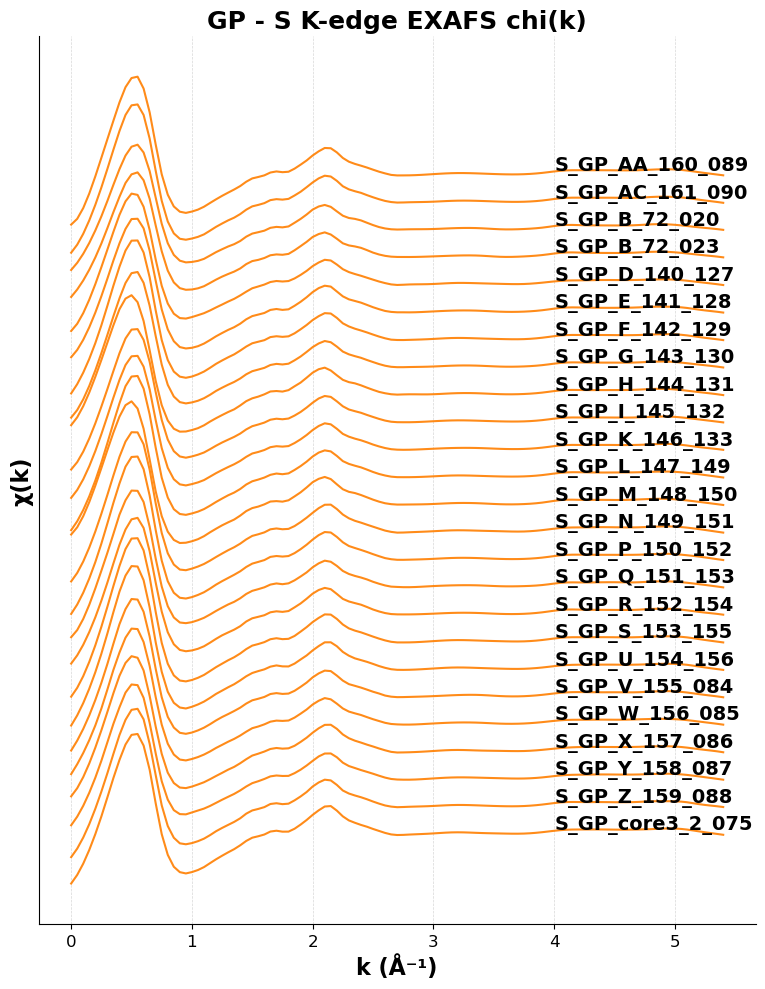

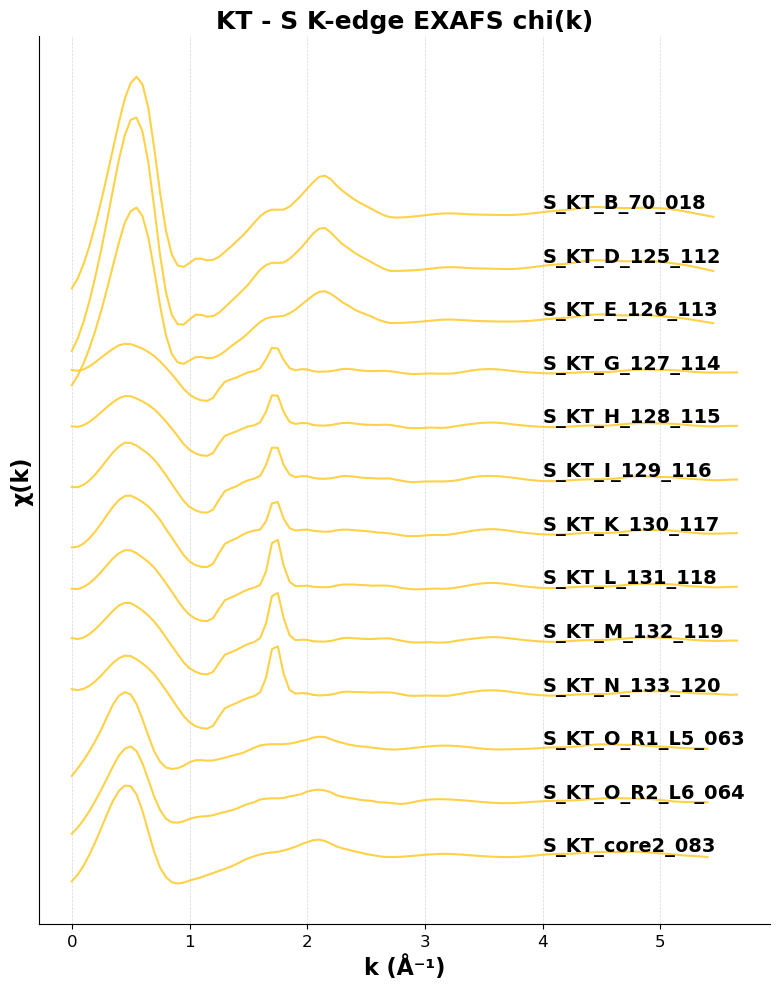

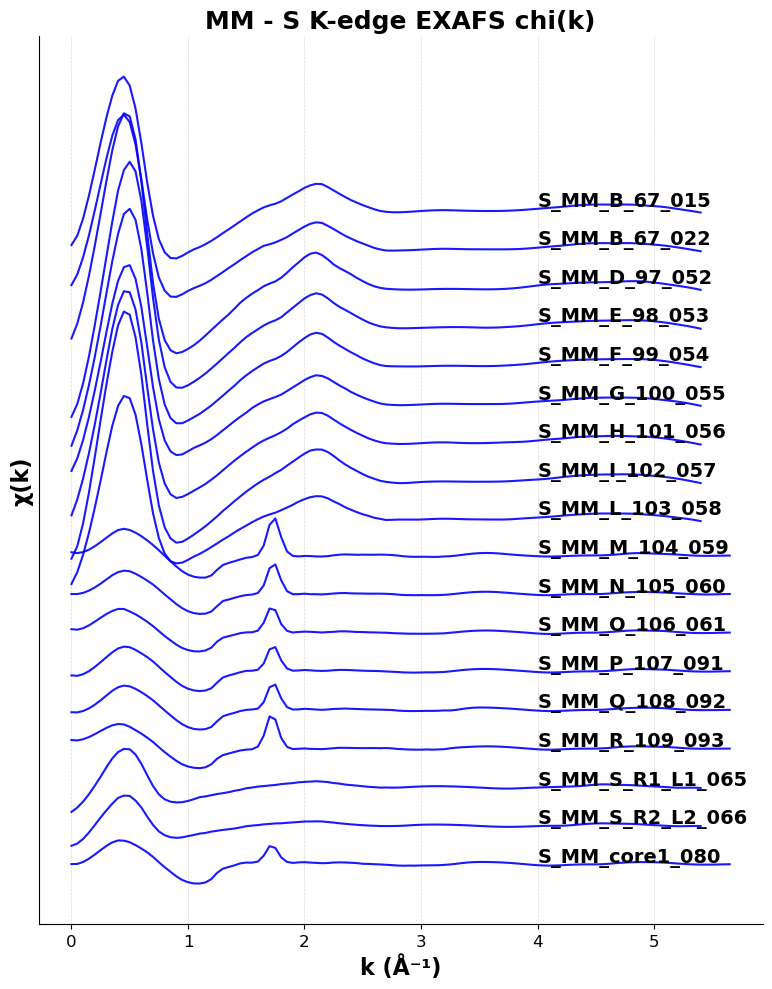

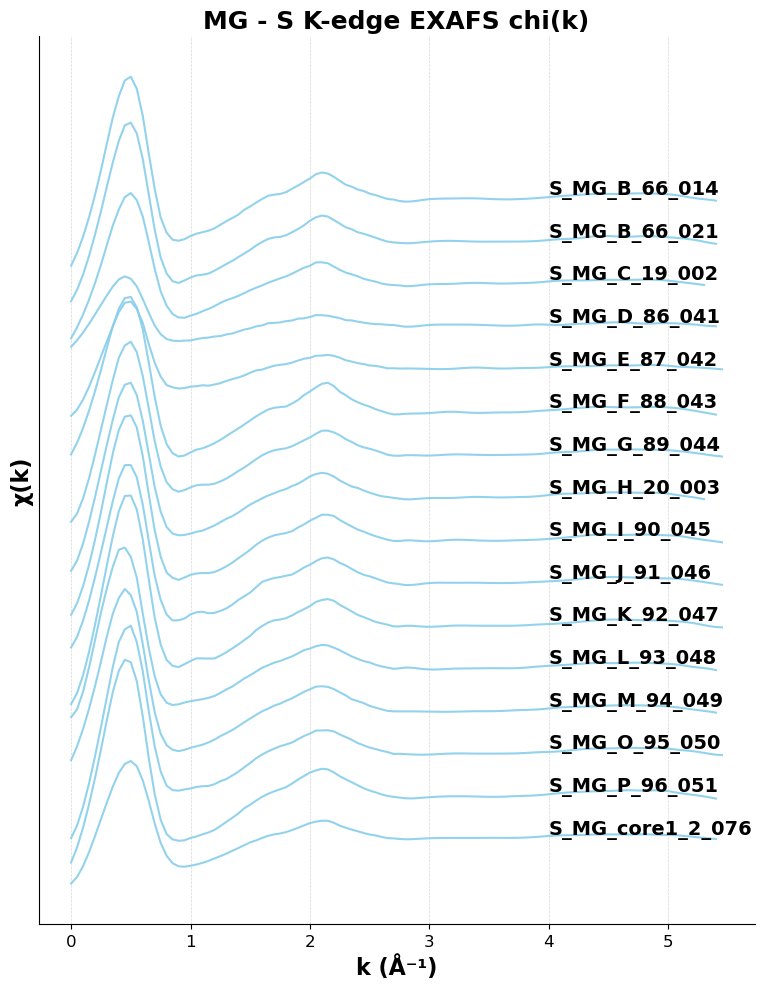

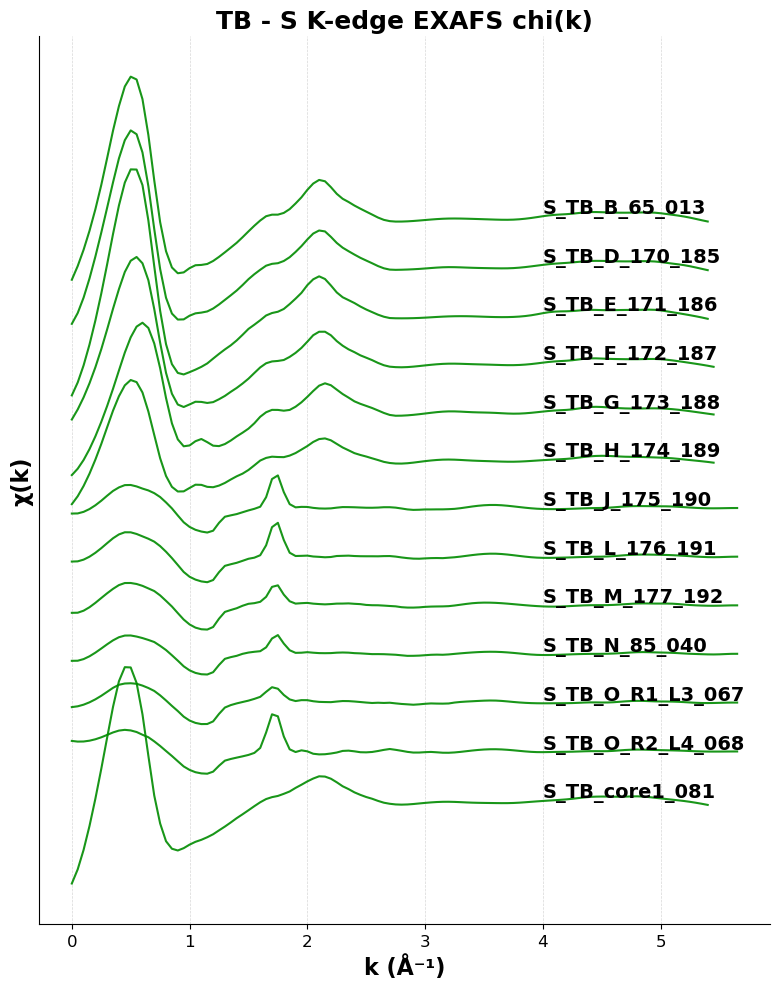

In [237]:
# ===========================================
# 2️⃣ Plotting Function: EXAFS chi(k)
# ===========================================

offset_step = 1  # adjust if needed for better separation

for mine_abbrev, color in mine_abbrev_color_mapping.items():
    mine_samples = [s for s in sample_names if extract_abbreviation(s) == mine_abbrev]
    mine_samples = sorted(mine_samples, key=custom_sort_key)

    if not mine_samples:
        print(f"⚠️ No samples found for {mine_abbrev}")
        continue

    plt.figure(figsize=(8, 10))

    for idx, sample in enumerate(mine_samples):
        k = exafs_results[sample]['k']
        chi_k = exafs_results[sample]['chi_k']
        offset = idx * offset_step

        plt.plot(k, chi_k - offset, label=sample, color=color, lw=1.5, alpha=0.9)

        # Add label next to each curve
        plt.text(k.min() + 4, -offset + 0.05, sample, color='black', fontsize=14, fontweight='bold')

    # Styling
    plt.title(f"{mine_abbrev} - S K-edge EXAFS chi(k)", fontsize=18, weight='bold')
    plt.xlabel("k (Å⁻¹)", fontsize=16, weight='bold')
    plt.ylabel("χ(k)", fontsize=16, weight='bold')
    plt.xticks(fontsize=12)
    plt.yticks([])  # hide y-axis ticks (stacked style)
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.grid(True, linestyle='--', linewidth=0.5, alpha=0.5)

    plt.tight_layout()
    plt.savefig(f"{save_folder}\\{mine_abbrev}_S_EXAFS_chik_plot.png", dpi=300, bbox_inches='tight')
    #plt.show()


# **Plotting EXAFS FT**

⚠️ No samples found for BB
⚠️ No samples found for FM
⚠️ No samples found for IK
⚠️ No samples found for IM


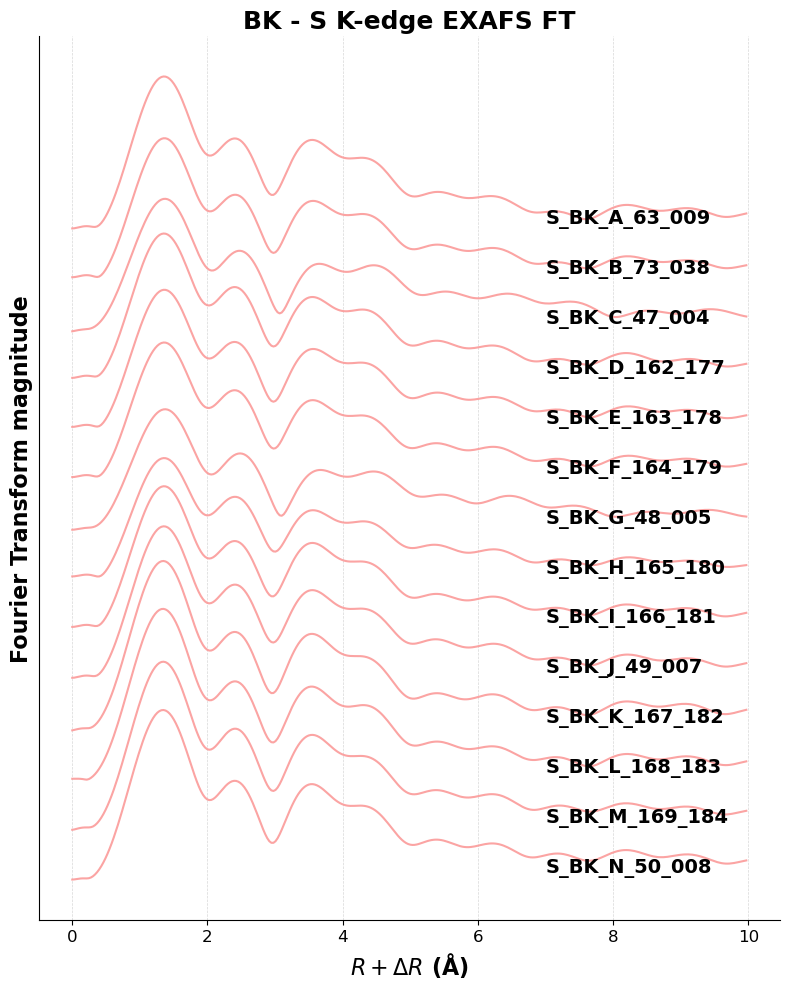

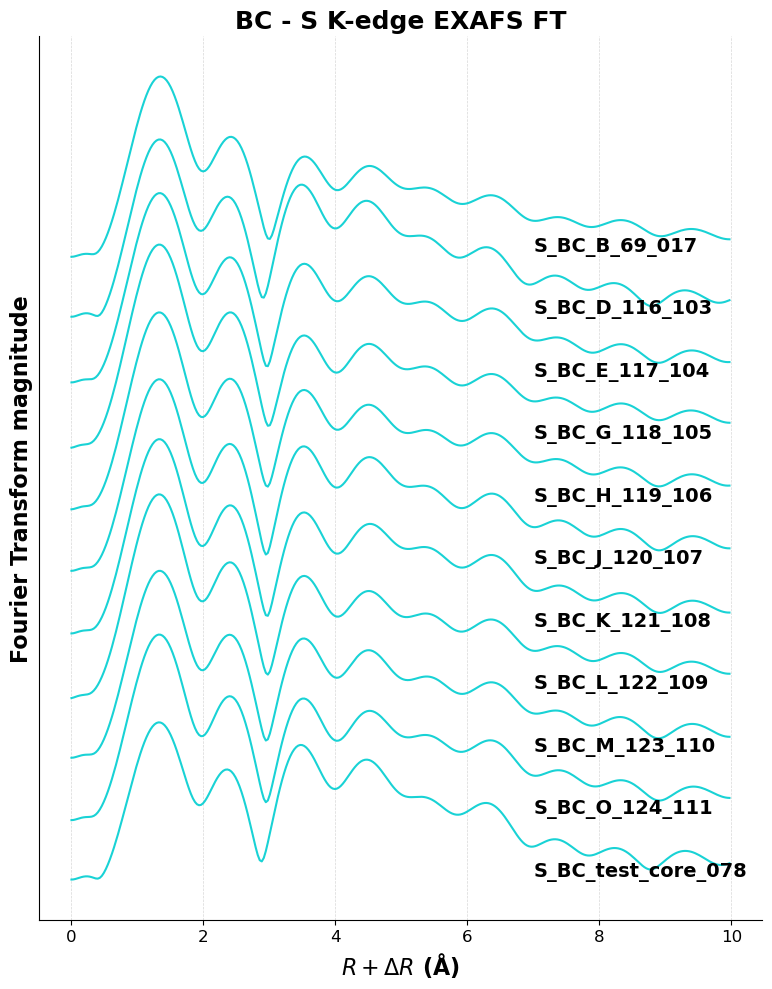

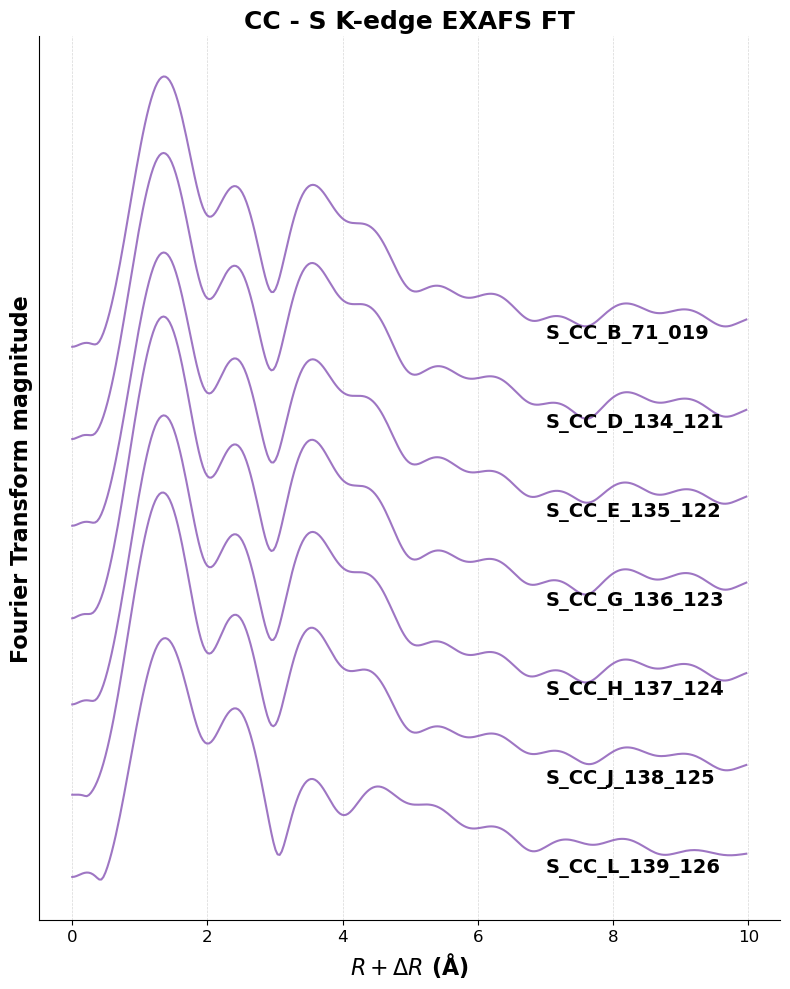

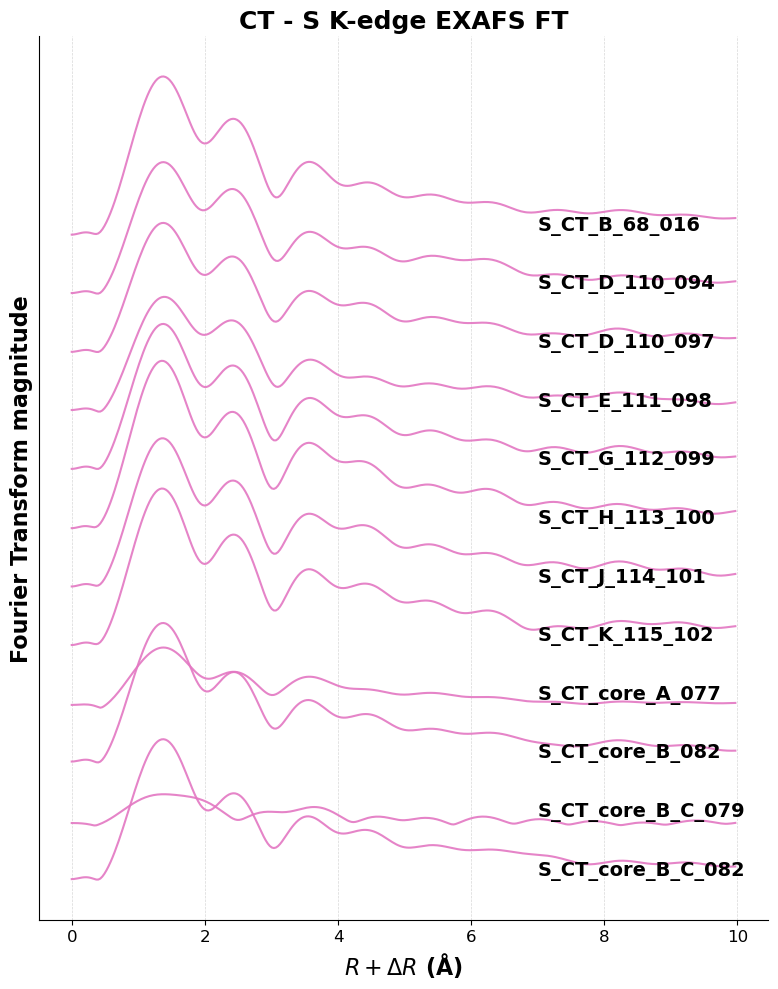

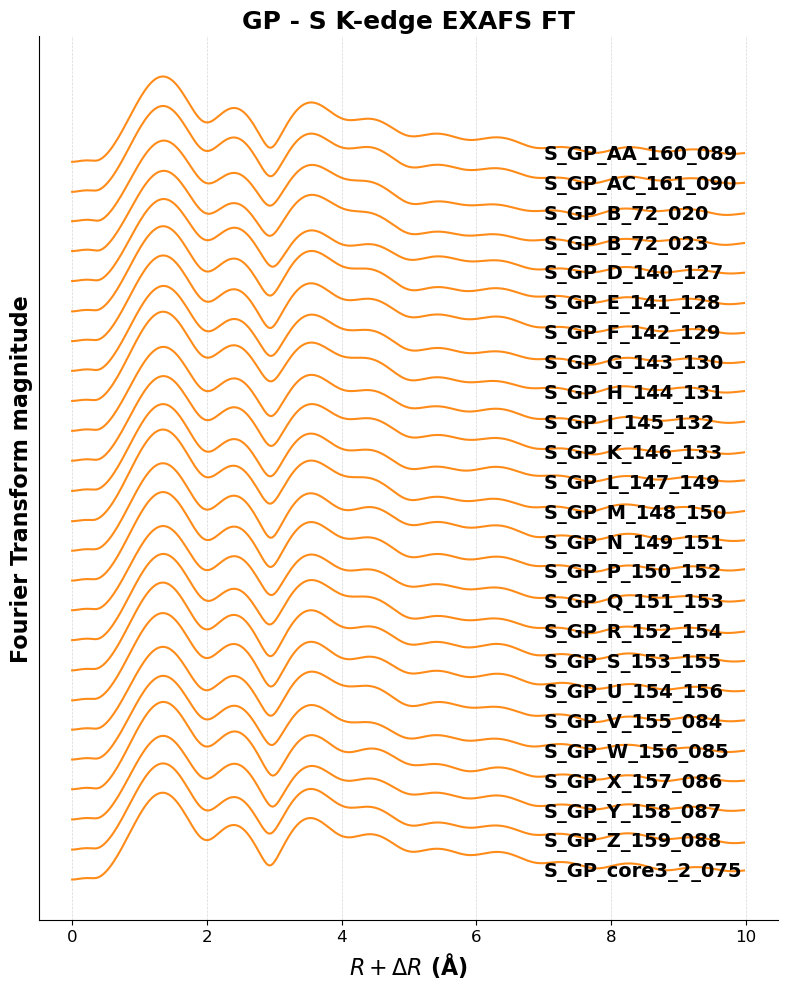

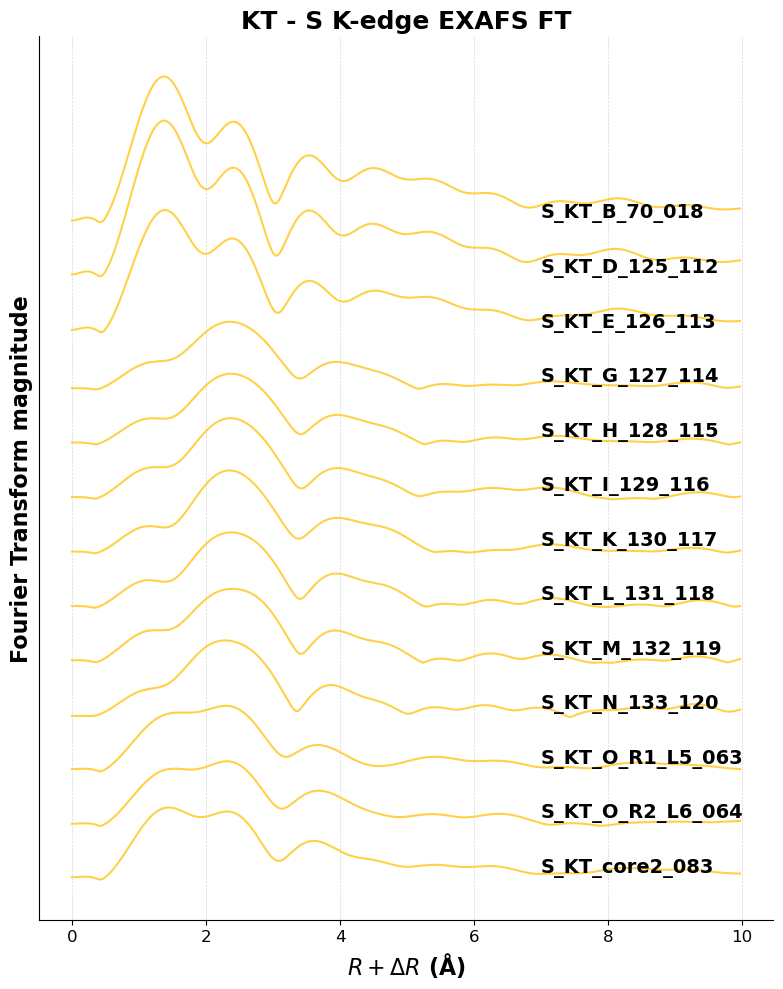

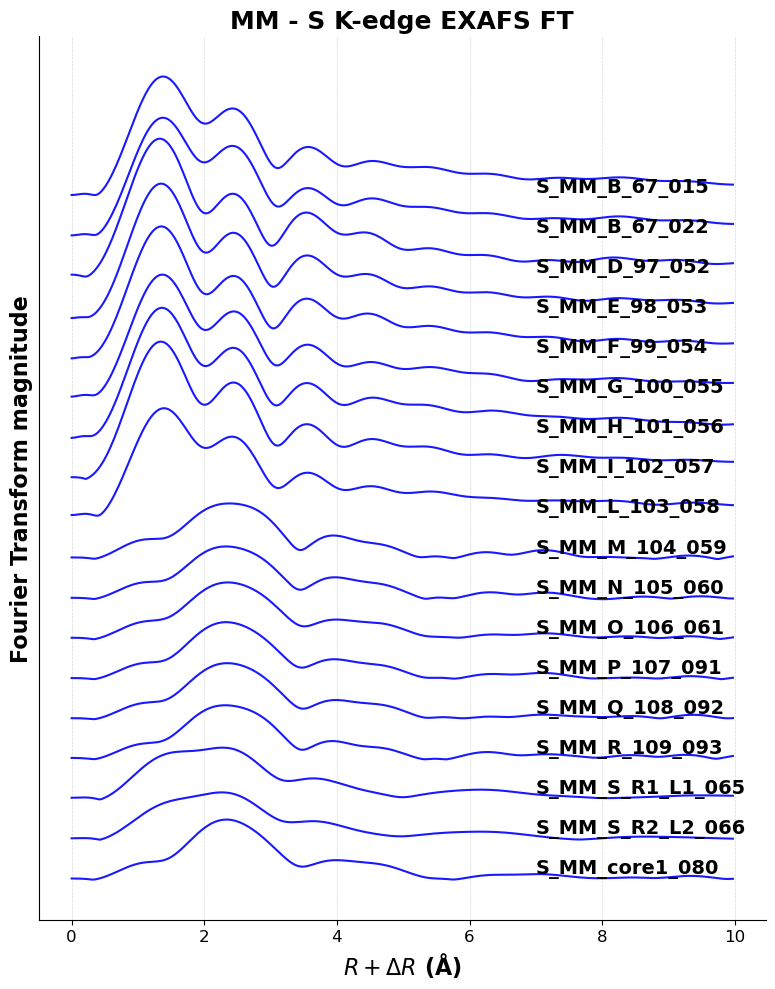

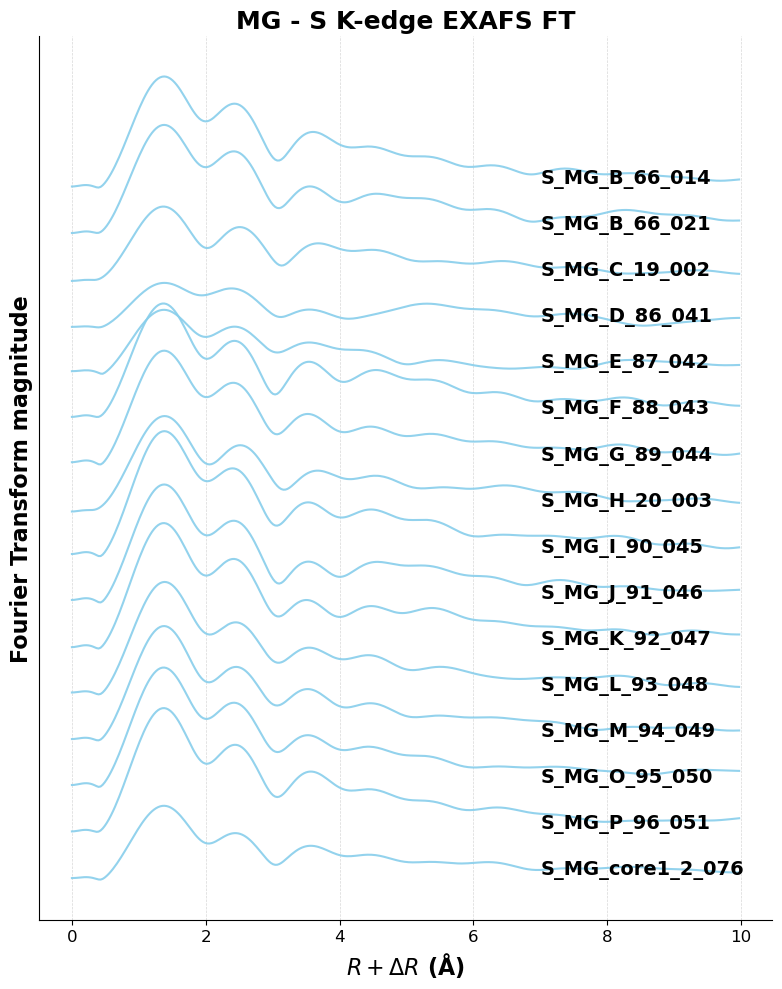

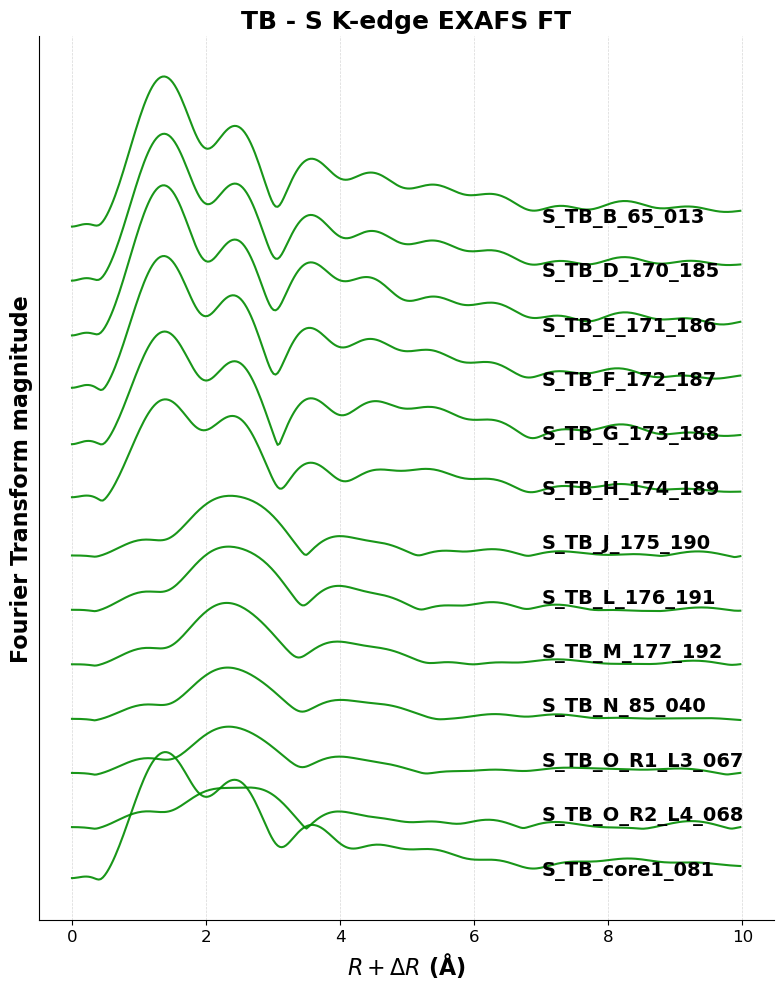

In [238]:
# ===========================================
# 3️⃣ Plotting Function: EXAFS FT
# ===========================================

offset_step = 0.3  # adjust if needed

for mine_abbrev, color in mine_abbrev_color_mapping.items():
    mine_samples = [s for s in sample_names if extract_abbreviation(s) == mine_abbrev]
    mine_samples = sorted(mine_samples, key=custom_sort_key)

    if not mine_samples:
        print(f"⚠️ No samples found for {mine_abbrev}")
        continue

    plt.figure(figsize=(8, 10))

    for idx, sample in enumerate(mine_samples):
        r = exafs_results[sample]['r']
        chi_r = np.abs(exafs_results[sample]['chi_r'])
        offset = idx * offset_step

        plt.plot(r, chi_r - offset, label=sample, color=color, lw=1.5, alpha=0.9)

        # Add label next to each curve
        plt.text(r.min() + 7, -offset + 0.05, sample, color='black', fontsize=14, fontweight='bold')


    # Styling
    plt.title(f"{mine_abbrev} - S K-edge EXAFS FT", fontsize=18, weight='bold')
    plt.xlabel(r"$R + \Delta R$ (Å)", fontsize=16, weight='bold')
    plt.ylabel("Fourier Transform magnitude", fontsize=16, weight='bold')
    plt.xticks(fontsize=12)
    plt.yticks([])  # hide y-axis ticks
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.grid(True, linestyle='--', linewidth=0.5, alpha=0.5)

    plt.tight_layout()
    plt.savefig(f"{save_folder}\\{mine_abbrev}_S_EXAFS_chiR_plot.png", dpi=300, bbox_inches='tight')
    #plt.show()
